In [2]:
%load_ext autoreload
%autoreload 2

import os 
import shutil
import numpy as n
from datetime import date
from matplotlib import pyplot as plt
import time
import napari

In [3]:
os.chdir('/home/ali/packages/s2p-lbm/')

from suite3d.job import Job
from suite3d import lbmio, utils, ui
from suite3d import tiff_utils as tfu
from suite3d import file_utils as flu

In [4]:
subjects_dir =   '/mnt/zortex-subjects/'
expt_info = { 
    'subject':         'SS002',
    'date' :          '2024-07-05',
    'expnum' :         [1,2,3,4,5,7,8,9,10,11,12,13,15,17,18,19,20],}

tifs, si_params, exp_str = flu.find_exp(subjects_dir, **expt_info, verbose=False)

job_params = {    
    # number of channels recorded in the tiff file, typically 30
    'n_ch_tif' : 26,
    # number of planes in the deeper cavity, typically 15
    'cavity_size' : 13,
    # convert from the Scanimage channel ordering to deep-to-shallow ordering
    # in our case, ScanImage channel numbers are in temporal order. 
    'planes' : n.array([ 0,  2,  4,  6,  8, 10, 12, 14,
                        16, 18, 20, 22, 24, 1,  3, 5,  7,9,11, 13, 15,17,19,21]),
    # number of files to use for the initial pass
    'n_init_files' :   4,
    
    # number of pixels to fuse between the ROI strips
    # the auto-detection doesn't always work well, recommend 
    # manually tuning it to reduce the stitching artifacts
    'fuse_shift_override' : 6,
    
    # will try to automatically estimate crosstalk using 
    # the shallowest crosstalk_n_planes planes. if you want to override,
    # set override_crosstalk = float between 0 and 1
    'subtract_crosstalk' : True,
    
    # volume rate in acquisition
    'fs' : flu.get_si_params(tifs[0])['vol_rate'],
    
    # 3D GPU registration - fast! 
    # for now, 3D + GPU are well-tested, other options might have minor bugs
    # if you run into them, let us know! we'll fix them
    '3d_reg' : True,
    'use_GPU_registration' : True,
}

In [5]:

job_params['fs'] = si_params['vol_rate']

savedir = os.path.join('/mnt/md0/runs', expt_info['subject'], expt_info['date'])
os.makedirs(savedir, exist_ok=True)

In [6]:
# Create the job
job = Job('/mnt/md0/runs',exp_str, tifs = tifs,
          params=job_params, create=False, overwrite=False, verbosity = 3)

   Found and loaded params from /mnt/md0/runs/s3d-SS002_2024-07-05_1-2-3-4-5-7-8-9-10-11-12-13-15-17-18-19-20/params.npy


In [6]:
# optional parameters for initialization
# load 1 file to initialize, and select 200 frames randomly to do initalization on
job.params['n_init_files'] = 4
job.params['init_n_frames'] = None
job.params['init_file_sample_method'] = 'even'
job.params['voxel_size_um'] = (20, 3.3, 3.3)

In [7]:
# %%time
# summary = job.run_init_pass()

In [8]:
summary = job.load_summary()

In [9]:
img = summary['ref_img_3d']

In [10]:
# split the large tiffs into files of size 100 after registration
job.params['split_tif_size'] = 100

In [32]:
%%time
job.register_gpu_3d()

      Found dir /mnt/md0/runs/s3d-SS002_2024-07-05_1-2-3-4-5-7-8-9-10-11-12-13-15-17-18-19-20/registered_fused_data
      Updating self.dirs tag registered_fused_data
   Overriding fuse shift value to 6
   Not clipping frames for registration
Will analyze 443 tifs in 443 batches
   Enforcing positivity
   Launching IO thread
         Memory at batch 0.  Total Used: 281.574 GB, Virtual Available: 221.655 GB, Virtual Used: 281.540 GB, Swap Used: 000.034 GB
Loading Batch 0 of 442
      Loading /mnt/zortex-subjects/SS002/2024-07-05/1/2024-07-05_1_SS002_2P_00001_00001.tif


Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB


Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 0 IO thread joined
         Memory after IO thread joinTotal Used: 285.004 GB, Virtual Available: 218.225 GB, Virtual Used: 284.970 GB, Swap Used: 000.034 GB
         Memory after movie copied from threadTotal Used: 287.906 GB, Virtual Available: 215.323 GB, Virtual Used: 287.872 GB, Swap Used: 000.034 GB
         Memory after thread memory clearedTotal Used: 285.007 GB, Virtual Available: 218.222 GB, Virtual Used: 284.973 GB, Swap Used: 000.034 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 285.007 GB, Virtual Available: 218.222 GB, Virtual Used: 284.973 GB, Swap Used: 000.034 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/1/2024-07-05_1_SS002_2P_00001_00002.tif
   Completed rigid reg on batch in :7.895143747329712s
   Shifted the mov in: 9.272759199142456s
         After all GPU Batches:Total Used: 294.077 GB, Virtual Available: 209.152 GB, Virtual Us

/home/ali/packages/s2p-lbm/suite3d/quality_metrics.py:41: RuntimeWarning: invalid value encountered in divide
  dff = df / fs.mean(axis=1,keepdims=True)
/home/ali/anaconda3/envs/suite3d-gpu/lib/python3.8/site-packages/numpy/lib/nanfunctions.py:1217: RuntimeWarning: All-NaN slice encountered
  return function_base._ureduce(a, func=_nanmedian, keepdims=keepdims,


         After full batch saving:Total Used: 294.168 GB, Virtual Available: 209.061 GB, Virtual Used: 294.134 GB, Swap Used: 000.034 GB
         Memory at batch 1.  Total Used: 294.168 GB, Virtual Available: 209.061 GB, Virtual Used: 294.134 GB, Swap Used: 000.034 GB
Loading Batch 1 of 442


Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 1 IO thread joined
         Memory after IO thread joinTotal Used: 297.109 GB, Virtual Available: 206.120 GB, Virtual Used: 297.075 GB, Swap Used: 000.034 GB
         Memory after movie copied from threadTotal Used: 294.040 GB, Virtual Available: 209.189 GB, Virtual Used: 294.005 GB, Swap Used: 000.034 GB
         Memory after thread memory clearedTotal Used: 291.137 GB, Virtual Available: 212.092 GB, Virtual Used: 291.103 GB, Swap Used: 000.034 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 291.137 GB, Virtual Available: 212.092 GB, Virtual Used: 291.103 GB, Swap Used: 000.034 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/1/2024-07-05_1_SS002_2P_00001_00003.tif
   Completed rigid reg on batch in :7.763080596923828s
   Shifted the mov in: 1.8246335983276367s
         After all GPU Batches:Total Used: 300.191 GB, Virtual Available: 203.038 GB, Virtual U

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 2 IO thread joined
         Memory after IO thread joinTotal Used: 297.151 GB, Virtual Available: 206.078 GB, Virtual Used: 297.117 GB, Swap Used: 000.034 GB
         Memory after movie copied from threadTotal Used: 294.079 GB, Virtual Available: 209.150 GB, Virtual Used: 294.045 GB, Swap Used: 000.034 GB
         Memory after thread memory clearedTotal Used: 291.180 GB, Virtual Available: 212.050 GB, Virtual Used: 291.145 GB, Swap Used: 000.034 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 291.180 GB, Virtual Available: 212.050 GB, Virtual Used: 291.145 GB, Swap Used: 000.034 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/1/2024-07-05_1_SS002_2P_00001_00004.tif
   Completed rigid reg on batch in :7.785670757293701s
   Shifted the mov in: 1.8433890342712402s
         After all GPU Batches:Total Used: 300.205 GB, Virtual Available: 203.024 GB, Virtual U

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 3 IO thread joined
         Memory after IO thread joinTotal Used: 297.121 GB, Virtual Available: 206.108 GB, Virtual Used: 297.087 GB, Swap Used: 000.034 GB
         Memory after movie copied from threadTotal Used: 294.055 GB, Virtual Available: 209.174 GB, Virtual Used: 294.021 GB, Swap Used: 000.034 GB
         Memory after thread memory clearedTotal Used: 291.144 GB, Virtual Available: 212.086 GB, Virtual Used: 291.109 GB, Swap Used: 000.034 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 291.144 GB, Virtual Available: 212.086 GB, Virtual Used: 291.109 GB, Swap Used: 000.034 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/1/2024-07-05_1_SS002_2P_00001_00005.tif
   Completed rigid reg on batch in :8.065317392349243s
   Shifted the mov in: 1.8616688251495361s
         After all GPU Batches:Total Used: 300.195 GB, Virtual Available: 203.034 GB, Virtual U

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 4 IO thread joined
         Memory after IO thread joinTotal Used: 297.175 GB, Virtual Available: 206.299 GB, Virtual Used: 296.896 GB, Swap Used: 000.278 GB
         Memory after movie copied from threadTotal Used: 294.107 GB, Virtual Available: 209.366 GB, Virtual Used: 293.829 GB, Swap Used: 000.278 GB
         Memory after thread memory clearedTotal Used: 291.209 GB, Virtual Available: 212.264 GB, Virtual Used: 290.931 GB, Swap Used: 000.278 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 291.209 GB, Virtual Available: 212.264 GB, Virtual Used: 290.931 GB, Swap Used: 000.278 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/1/2024-07-05_1_SS002_2P_00001_00006.tif
   Completed rigid reg on batch in :8.064782619476318s
   Shifted the mov in: 1.8812544345855713s
         After all GPU Batches:Total Used: 300.253 GB, Virtual Available: 203.220 GB, Virtual U

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 5 IO thread joined
         Memory after IO thread joinTotal Used: 297.093 GB, Virtual Available: 206.562 GB, Virtual Used: 296.633 GB, Swap Used: 000.459 GB
         Memory after movie copied from threadTotal Used: 294.025 GB, Virtual Available: 209.629 GB, Virtual Used: 293.566 GB, Swap Used: 000.459 GB
         Memory after thread memory clearedTotal Used: 291.124 GB, Virtual Available: 212.530 GB, Virtual Used: 290.665 GB, Swap Used: 000.459 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 291.124 GB, Virtual Available: 212.530 GB, Virtual Used: 290.665 GB, Swap Used: 000.459 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/1/2024-07-05_1_SS002_2P_00001_00007.tif
   Completed rigid reg on batch in :7.8761022090911865s
   Shifted the mov in: 1.8405613899230957s
         After all GPU Batches:Total Used: 300.160 GB, Virtual Available: 203.494 GB, Virtual 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 6 IO thread joined
         Memory after IO thread joinTotal Used: 297.088 GB, Virtual Available: 206.735 GB, Virtual Used: 296.460 GB, Swap Used: 000.628 GB
         Memory after movie copied from threadTotal Used: 294.016 GB, Virtual Available: 209.807 GB, Virtual Used: 293.387 GB, Swap Used: 000.628 GB
         Memory after thread memory clearedTotal Used: 291.116 GB, Virtual Available: 212.707 GB, Virtual Used: 290.488 GB, Swap Used: 000.628 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 291.116 GB, Virtual Available: 212.707 GB, Virtual Used: 290.488 GB, Swap Used: 000.628 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/1/2024-07-05_1_SS002_2P_00001_00008.tif
   Completed rigid reg on batch in :7.944269418716431s
   Shifted the mov in: 1.850174903869629s
         After all GPU Batches:Total Used: 300.157 GB, Virtual Available: 203.666 GB, Virtual Us

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 7 IO thread joined
         Memory after IO thread joinTotal Used: 297.398 GB, Virtual Available: 206.590 GB, Virtual Used: 296.605 GB, Swap Used: 000.793 GB
         Memory after movie copied from threadTotal Used: 294.330 GB, Virtual Available: 209.657 GB, Virtual Used: 293.538 GB, Swap Used: 000.793 GB
         Memory after thread memory clearedTotal Used: 291.429 GB, Virtual Available: 212.559 GB, Virtual Used: 290.636 GB, Swap Used: 000.793 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 291.429 GB, Virtual Available: 212.559 GB, Virtual Used: 290.636 GB, Swap Used: 000.793 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/1/2024-07-05_1_SS002_2P_00001_00009.tif
   Completed rigid reg on batch in :7.865738153457642s
   Shifted the mov in: 1.897779941558838s
         After all GPU Batches:Total Used: 300.472 GB, Virtual Available: 203.516 GB, Virtual Us

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 8 IO thread joined
         Memory after IO thread joinTotal Used: 297.362 GB, Virtual Available: 206.625 GB, Virtual Used: 296.570 GB, Swap Used: 000.793 GB
         Memory after movie copied from threadTotal Used: 294.290 GB, Virtual Available: 209.697 GB, Virtual Used: 293.498 GB, Swap Used: 000.793 GB
         Memory after thread memory clearedTotal Used: 291.391 GB, Virtual Available: 212.596 GB, Virtual Used: 290.598 GB, Swap Used: 000.793 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 291.391 GB, Virtual Available: 212.596 GB, Virtual Used: 290.598 GB, Swap Used: 000.793 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/1/2024-07-05_1_SS002_2P_00001_00010.tif
   Completed rigid reg on batch in :7.765828847885132s
   Shifted the mov in: 1.7722091674804688s
         After all GPU Batches:Total Used: 300.459 GB, Virtual Available: 203.529 GB, Virtual U

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 9 IO thread joined
         Memory after IO thread joinTotal Used: 297.268 GB, Virtual Available: 206.720 GB, Virtual Used: 296.475 GB, Swap Used: 000.793 GB
         Memory after movie copied from threadTotal Used: 294.198 GB, Virtual Available: 209.789 GB, Virtual Used: 293.406 GB, Swap Used: 000.793 GB
         Memory after thread memory clearedTotal Used: 291.300 GB, Virtual Available: 212.688 GB, Virtual Used: 290.507 GB, Swap Used: 000.793 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 291.300 GB, Virtual Available: 212.688 GB, Virtual Used: 290.507 GB, Swap Used: 000.793 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/1/2024-07-05_1_SS002_2P_00001_00011.tif
   Completed rigid reg on batch in :7.807996988296509s
   Shifted the mov in: 1.7918577194213867s
         After all GPU Batches:Total Used: 300.408 GB, Virtual Available: 203.580 GB, Virtual U

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 10 IO thread joined
         Memory after IO thread joinTotal Used: 297.330 GB, Virtual Available: 206.657 GB, Virtual Used: 296.538 GB, Swap Used: 000.793 GB
         Memory after movie copied from threadTotal Used: 294.259 GB, Virtual Available: 209.729 GB, Virtual Used: 293.466 GB, Swap Used: 000.793 GB
         Memory after thread memory clearedTotal Used: 291.352 GB, Virtual Available: 212.636 GB, Virtual Used: 290.559 GB, Swap Used: 000.793 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 291.352 GB, Virtual Available: 212.636 GB, Virtual Used: 290.559 GB, Swap Used: 000.793 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/1/2024-07-05_1_SS002_2P_00001_00012.tif
   Completed rigid reg on batch in :8.009523630142212s
   Shifted the mov in: 1.7937567234039307s
         After all GPU Batches:Total Used: 300.408 GB, Virtual Available: 203.580 GB, Virtual 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 11 IO thread joined
         Memory after IO thread joinTotal Used: 297.288 GB, Virtual Available: 206.863 GB, Virtual Used: 296.332 GB, Swap Used: 000.956 GB
         Memory after movie copied from threadTotal Used: 294.164 GB, Virtual Available: 209.987 GB, Virtual Used: 293.208 GB, Swap Used: 000.956 GB
         Memory after thread memory clearedTotal Used: 291.262 GB, Virtual Available: 212.888 GB, Virtual Used: 290.307 GB, Swap Used: 000.956 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 291.262 GB, Virtual Available: 212.888 GB, Virtual Used: 290.307 GB, Swap Used: 000.956 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/1/2024-07-05_1_SS002_2P_00001_00013.tif
   Completed rigid reg on batch in :7.9447174072265625s
   Shifted the mov in: 1.8167033195495605s
         After all GPU Batches:Total Used: 300.301 GB, Virtual Available: 203.850 GB, Virtual

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 12 IO thread joined
         Memory after IO thread joinTotal Used: 297.106 GB, Virtual Available: 207.206 GB, Virtual Used: 295.989 GB, Swap Used: 001.116 GB
         Memory after movie copied from threadTotal Used: 294.038 GB, Virtual Available: 210.274 GB, Virtual Used: 292.921 GB, Swap Used: 001.116 GB
         Memory after thread memory clearedTotal Used: 291.137 GB, Virtual Available: 213.174 GB, Virtual Used: 290.021 GB, Swap Used: 001.116 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 291.137 GB, Virtual Available: 213.174 GB, Virtual Used: 290.021 GB, Swap Used: 001.116 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/1/2024-07-05_1_SS002_2P_00001_00014.tif
   Completed rigid reg on batch in :8.00702953338623s
   Shifted the mov in: 1.7927587032318115s
         After all GPU Batches:Total Used: 300.174 GB, Virtual Available: 204.138 GB, Virtual U

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 13 IO thread joined
         Memory after IO thread joinTotal Used: 297.091 GB, Virtual Available: 207.381 GB, Virtual Used: 295.814 GB, Swap Used: 001.277 GB
         Memory after movie copied from threadTotal Used: 294.021 GB, Virtual Available: 210.450 GB, Virtual Used: 292.745 GB, Swap Used: 001.277 GB
         Memory after thread memory clearedTotal Used: 291.127 GB, Virtual Available: 213.345 GB, Virtual Used: 289.850 GB, Swap Used: 001.277 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 291.127 GB, Virtual Available: 213.345 GB, Virtual Used: 289.850 GB, Swap Used: 001.277 GB
      Loading /mnt/zortex-subjects/SS002/2024-07-05/1/2024-07-05_1_SS002_2P_00001_00015.tif
      Loaded batch of size (24, 100, 900, 720)
   Completed rigid reg on batch in :7.881495952606201s
   Shifted the mov in: 1.7870204448699951s
         After all GPU Batches:Total Used: 300.159 GB, Virtual Available: 204.313 GB, Virtual 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 14 IO thread joined
         Memory after IO thread joinTotal Used: 297.150 GB, Virtual Available: 207.481 GB, Virtual Used: 295.714 GB, Swap Used: 001.436 GB
         Memory after movie copied from threadTotal Used: 294.084 GB, Virtual Available: 210.548 GB, Virtual Used: 292.647 GB, Swap Used: 001.436 GB
         Memory after thread memory clearedTotal Used: 291.172 GB, Virtual Available: 213.459 GB, Virtual Used: 289.736 GB, Swap Used: 001.436 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 291.172 GB, Virtual Available: 213.459 GB, Virtual Used: 289.736 GB, Swap Used: 001.436 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/1/2024-07-05_1_SS002_2P_00001_00016.tif
   Completed rigid reg on batch in :8.024663925170898s
   Shifted the mov in: 1.838249921798706s
         After all GPU Batches:Total Used: 300.219 GB, Virtual Available: 204.413 GB, Virtual U

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 15 IO thread joined
         Memory after IO thread joinTotal Used: 297.176 GB, Virtual Available: 207.455 GB, Virtual Used: 295.739 GB, Swap Used: 001.436 GB
         Memory after movie copied from threadTotal Used: 294.108 GB, Virtual Available: 210.524 GB, Virtual Used: 292.671 GB, Swap Used: 001.436 GB
         Memory after thread memory clearedTotal Used: 291.202 GB, Virtual Available: 213.429 GB, Virtual Used: 289.766 GB, Swap Used: 001.436 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 291.202 GB, Virtual Available: 213.429 GB, Virtual Used: 289.766 GB, Swap Used: 001.436 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/1/2024-07-05_1_SS002_2P_00001_00017.tif
   Completed rigid reg on batch in :8.03735089302063s
   Shifted the mov in: 1.8005039691925049s
         After all GPU Batches:Total Used: 300.260 GB, Virtual Available: 204.371 GB, Virtual U

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 16 IO thread joined
         Memory after IO thread joinTotal Used: 297.201 GB, Virtual Available: 207.590 GB, Virtual Used: 295.605 GB, Swap Used: 001.596 GB
         Memory after movie copied from threadTotal Used: 294.073 GB, Virtual Available: 210.718 GB, Virtual Used: 292.477 GB, Swap Used: 001.596 GB
         Memory after thread memory clearedTotal Used: 291.167 GB, Virtual Available: 213.624 GB, Virtual Used: 289.571 GB, Swap Used: 001.596 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 291.167 GB, Virtual Available: 213.624 GB, Virtual Used: 289.571 GB, Swap Used: 001.596 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/1/2024-07-05_1_SS002_2P_00001_00018.tif
   Completed rigid reg on batch in :8.155236959457397s
   Shifted the mov in: 1.787107229232788s
         After all GPU Batches:Total Used: 300.198 GB, Virtual Available: 204.593 GB, Virtual U

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 17 IO thread joined
         Memory after IO thread joinTotal Used: 297.249 GB, Virtual Available: 207.700 GB, Virtual Used: 295.495 GB, Swap Used: 001.754 GB
         Memory after movie copied from threadTotal Used: 294.241 GB, Virtual Available: 210.708 GB, Virtual Used: 292.487 GB, Swap Used: 001.754 GB
         Memory after thread memory clearedTotal Used: 291.278 GB, Virtual Available: 213.671 GB, Virtual Used: 289.524 GB, Swap Used: 001.754 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 291.278 GB, Virtual Available: 213.671 GB, Virtual Used: 289.524 GB, Swap Used: 001.754 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/1/2024-07-05_1_SS002_2P_00001_00019.tif
   Completed rigid reg on batch in :8.112662553787231s
   Shifted the mov in: 1.8042001724243164s
         After all GPU Batches:Total Used: 300.374 GB, Virtual Available: 204.576 GB, Virtual 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 18 IO thread joined
         Memory after IO thread joinTotal Used: 297.266 GB, Virtual Available: 207.840 GB, Virtual Used: 295.355 GB, Swap Used: 001.911 GB
         Memory after movie copied from threadTotal Used: 294.197 GB, Virtual Available: 210.910 GB, Virtual Used: 292.285 GB, Swap Used: 001.911 GB
         Memory after thread memory clearedTotal Used: 291.289 GB, Virtual Available: 213.817 GB, Virtual Used: 289.378 GB, Swap Used: 001.911 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 291.289 GB, Virtual Available: 213.817 GB, Virtual Used: 289.378 GB, Swap Used: 001.911 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/1/2024-07-05_1_SS002_2P_00001_00020.tif
   Completed rigid reg on batch in :8.060928583145142s
   Shifted the mov in: 1.8116581439971924s
         After all GPU Batches:Total Used: 300.382 GB, Virtual Available: 204.725 GB, Virtual 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 19 IO thread joined
         Memory after IO thread joinTotal Used: 297.337 GB, Virtual Available: 207.769 GB, Virtual Used: 295.426 GB, Swap Used: 001.911 GB
         Memory after movie copied from threadTotal Used: 294.271 GB, Virtual Available: 210.836 GB, Virtual Used: 292.359 GB, Swap Used: 001.911 GB
         Memory after thread memory clearedTotal Used: 291.366 GB, Virtual Available: 213.741 GB, Virtual Used: 289.454 GB, Swap Used: 001.911 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 291.366 GB, Virtual Available: 213.741 GB, Virtual Used: 289.454 GB, Swap Used: 001.911 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/1/2024-07-05_1_SS002_2P_00001_00021.tif
   Completed rigid reg on batch in :7.9836952686309814s
   Shifted the mov in: 1.7469968795776367s
         After all GPU Batches:Total Used: 300.396 GB, Virtual Available: 204.711 GB, Virtual

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 20 IO thread joined
         Memory after IO thread joinTotal Used: 297.382 GB, Virtual Available: 207.881 GB, Virtual Used: 295.314 GB, Swap Used: 002.068 GB
         Memory after movie copied from threadTotal Used: 294.374 GB, Virtual Available: 210.889 GB, Virtual Used: 292.306 GB, Swap Used: 002.068 GB
         Memory after thread memory clearedTotal Used: 291.405 GB, Virtual Available: 213.858 GB, Virtual Used: 289.337 GB, Swap Used: 002.068 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 291.405 GB, Virtual Available: 213.858 GB, Virtual Used: 289.337 GB, Swap Used: 002.068 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/1/2024-07-05_1_SS002_2P_00001_00022.tif
   Completed rigid reg on batch in :8.10322904586792s
   Shifted the mov in: 1.7867751121520996s
         After all GPU Batches:Total Used: 300.510 GB, Virtual Available: 204.753 GB, Virtual U

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 21 IO thread joined
         Memory after IO thread joinTotal Used: 297.110 GB, Virtual Available: 208.153 GB, Virtual Used: 295.042 GB, Swap Used: 002.068 GB
         Memory after movie copied from threadTotal Used: 294.042 GB, Virtual Available: 211.221 GB, Virtual Used: 291.974 GB, Swap Used: 002.068 GB
         Memory after thread memory clearedTotal Used: 291.142 GB, Virtual Available: 214.121 GB, Virtual Used: 289.074 GB, Swap Used: 002.068 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 291.142 GB, Virtual Available: 214.121 GB, Virtual Used: 289.074 GB, Swap Used: 002.068 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/1/2024-07-05_1_SS002_2P_00001_00023.tif
   Completed rigid reg on batch in :8.055941343307495s
   Shifted the mov in: 1.803694486618042s
         After all GPU Batches:Total Used: 300.171 GB, Virtual Available: 205.092 GB, Virtual U

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 22 IO thread joined
         Memory after IO thread joinTotal Used: 297.124 GB, Virtual Available: 208.295 GB, Virtual Used: 294.900 GB, Swap Used: 002.224 GB
         Memory after movie copied from threadTotal Used: 294.058 GB, Virtual Available: 211.362 GB, Virtual Used: 291.833 GB, Swap Used: 002.224 GB
         Memory after thread memory clearedTotal Used: 291.168 GB, Virtual Available: 214.252 GB, Virtual Used: 288.943 GB, Swap Used: 002.224 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 291.168 GB, Virtual Available: 214.252 GB, Virtual Used: 288.943 GB, Swap Used: 002.224 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/1/2024-07-05_1_SS002_2P_00001_00024.tif
   Completed rigid reg on batch in :8.194058895111084s
   Shifted the mov in: 1.8277063369750977s
         After all GPU Batches:Total Used: 300.204 GB, Virtual Available: 205.216 GB, Virtual 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 23 IO thread joined
         Memory after IO thread joinTotal Used: 297.132 GB, Virtual Available: 208.443 GB, Virtual Used: 294.752 GB, Swap Used: 002.380 GB
         Memory after movie copied from threadTotal Used: 294.067 GB, Virtual Available: 211.508 GB, Virtual Used: 291.686 GB, Swap Used: 002.380 GB
         Memory after thread memory clearedTotal Used: 291.225 GB, Virtual Available: 214.351 GB, Virtual Used: 288.844 GB, Swap Used: 002.380 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 291.225 GB, Virtual Available: 214.351 GB, Virtual Used: 288.844 GB, Swap Used: 002.380 GB
      Loading /mnt/zortex-subjects/SS002/2024-07-05/1/2024-07-05_1_SS002_2P_00001_00025.tif
      Loaded batch of size (24, 100, 900, 720)
   Completed rigid reg on batch in :8.140386819839478s
   Shifted the mov in: 1.8298423290252686s
         After all GPU Batches:Total Used: 300.196 GB, Virtual Available: 205.379 GB, Virtual 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 24 IO thread joined
         Memory after IO thread joinTotal Used: 296.931 GB, Virtual Available: 208.644 GB, Virtual Used: 294.551 GB, Swap Used: 002.380 GB
         Memory after movie copied from threadTotal Used: 293.865 GB, Virtual Available: 211.710 GB, Virtual Used: 291.485 GB, Swap Used: 002.380 GB
         Memory after thread memory clearedTotal Used: 290.958 GB, Virtual Available: 214.617 GB, Virtual Used: 288.578 GB, Swap Used: 002.380 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 290.958 GB, Virtual Available: 214.617 GB, Virtual Used: 288.578 GB, Swap Used: 002.380 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/1/2024-07-05_1_SS002_2P_00001_00026.tif
   Completed rigid reg on batch in :8.264425277709961s
   Shifted the mov in: 1.874572515487671s
         After all GPU Batches:Total Used: 300.517 GB, Virtual Available: 205.058 GB, Virtual U

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.


      Computing quality metrics and saving


Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 0.58 GB
         After full batch saving:Total Used: 294.716 GB, Virtual Available: 210.859 GB, Virtual Used: 292.336 GB, Swap Used: 002.380 GB
         Memory at batch 25. Total Used: 294.716 GB, Virtual Available: 210.859 GB, Virtual Used: 292.336 GB, Swap Used: 002.380 GB
Loading Batch 25 of 442
   Batch 25 IO thread joined
         Memory after IO thread joinTotal Used: 294.716 GB, Virtual Available: 210.859 GB, Virtual Used: 292.336 GB, Swap Used: 002.380 GB
         Memory after movie copied from threadTotal Used: 289.328 GB, Virtual Available: 216.248 GB, Virtual Used: 286.947 GB, Swap Used: 002.380 GB
         Memory after thread memory clearedTotal Used: 288.746 GB, Virtual Available: 216.829 GB, Virtual Used: 286.366 GB, Swap Used: 002.380 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 288.746 GB, Virtual Available: 216.829 GB, Virtual Used: 286.366 GB, Swap Used: 002.380 GB
      Loaded batch of size (24, 20, 900

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 26 IO thread joined
         Memory after IO thread joinTotal Used: 287.515 GB, Virtual Available: 218.447 GB, Virtual Used: 284.748 GB, Swap Used: 002.767 GB
         Memory after movie copied from threadTotal Used: 289.165 GB, Virtual Available: 216.797 GB, Virtual Used: 286.398 GB, Swap Used: 002.767 GB
         Memory after thread memory clearedTotal Used: 286.262 GB, Virtual Available: 219.700 GB, Virtual Used: 283.495 GB, Swap Used: 002.767 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 286.262 GB, Virtual Available: 219.700 GB, Virtual Used: 283.495 GB, Swap Used: 002.767 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/2/2024-07-05_2_SS002_2P_00001_00002.tif
   Completed rigid reg on batch in :8.10796308517456s
   Shifted the mov in: 1.8567962646484375s
         After all GPU Batches:Total Used: 295.319 GB, Virtual Available: 210.643 GB, Virtual U

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 27 IO thread joined
         Memory after IO thread joinTotal Used: 296.915 GB, Virtual Available: 209.047 GB, Virtual Used: 294.148 GB, Swap Used: 002.767 GB
         Memory after movie copied from threadTotal Used: 293.844 GB, Virtual Available: 212.118 GB, Virtual Used: 291.077 GB, Swap Used: 002.767 GB
         Memory after thread memory clearedTotal Used: 290.947 GB, Virtual Available: 215.015 GB, Virtual Used: 288.180 GB, Swap Used: 002.767 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 290.947 GB, Virtual Available: 215.015 GB, Virtual Used: 288.180 GB, Swap Used: 002.767 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/2/2024-07-05_2_SS002_2P_00001_00003.tif
   Completed rigid reg on batch in :10.407549381256104s
   Shifted the mov in: 1.86663818359375s
         After all GPU Batches:Total Used: 299.984 GB, Virtual Available: 205.978 GB, Virtual U

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 28 IO thread joined
         Memory after IO thread joinTotal Used: 297.007 GB, Virtual Available: 208.955 GB, Virtual Used: 294.240 GB, Swap Used: 002.767 GB
         Memory after movie copied from threadTotal Used: 293.933 GB, Virtual Available: 212.029 GB, Virtual Used: 291.166 GB, Swap Used: 002.767 GB
         Memory after thread memory clearedTotal Used: 291.028 GB, Virtual Available: 214.934 GB, Virtual Used: 288.261 GB, Swap Used: 002.767 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 291.028 GB, Virtual Available: 214.934 GB, Virtual Used: 288.261 GB, Swap Used: 002.767 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/2/2024-07-05_2_SS002_2P_00001_00004.tif
   Completed rigid reg on batch in :8.032807350158691s
   Shifted the mov in: 1.8167059421539307s
         After all GPU Batches:Total Used: 300.087 GB, Virtual Available: 205.875 GB, Virtual 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 29 IO thread joined
         Memory after IO thread joinTotal Used: 297.070 GB, Virtual Available: 208.892 GB, Virtual Used: 294.303 GB, Swap Used: 002.767 GB
         Memory after movie copied from threadTotal Used: 294.003 GB, Virtual Available: 211.959 GB, Virtual Used: 291.236 GB, Swap Used: 002.767 GB
         Memory after thread memory clearedTotal Used: 291.104 GB, Virtual Available: 214.858 GB, Virtual Used: 288.337 GB, Swap Used: 002.767 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 291.104 GB, Virtual Available: 214.858 GB, Virtual Used: 288.337 GB, Swap Used: 002.767 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/2/2024-07-05_2_SS002_2P_00001_00005.tif
   Completed rigid reg on batch in :8.148495197296143s
   Shifted the mov in: 1.830550193786621s
         After all GPU Batches:Total Used: 300.155 GB, Virtual Available: 205.807 GB, Virtual U

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 30 IO thread joined
         Memory after IO thread joinTotal Used: 298.053 GB, Virtual Available: 208.002 GB, Virtual Used: 295.193 GB, Swap Used: 002.860 GB
         Memory after movie copied from threadTotal Used: 294.987 GB, Virtual Available: 211.068 GB, Virtual Used: 292.127 GB, Swap Used: 002.860 GB
         Memory after thread memory clearedTotal Used: 292.080 GB, Virtual Available: 213.975 GB, Virtual Used: 289.220 GB, Swap Used: 002.860 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.080 GB, Virtual Available: 213.975 GB, Virtual Used: 289.220 GB, Swap Used: 002.860 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/2/2024-07-05_2_SS002_2P_00001_00006.tif
   Completed rigid reg on batch in :8.070892333984375s
   Shifted the mov in: 1.8476903438568115s
         After all GPU Batches:Total Used: 301.134 GB, Virtual Available: 204.920 GB, Virtual 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 31 IO thread joined
         Memory after IO thread joinTotal Used: 298.498 GB, Virtual Available: 207.712 GB, Virtual Used: 295.483 GB, Swap Used: 003.015 GB
         Memory after movie copied from threadTotal Used: 295.424 GB, Virtual Available: 210.786 GB, Virtual Used: 292.409 GB, Swap Used: 003.015 GB
         Memory after thread memory clearedTotal Used: 292.525 GB, Virtual Available: 213.685 GB, Virtual Used: 289.510 GB, Swap Used: 003.015 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.525 GB, Virtual Available: 213.685 GB, Virtual Used: 289.510 GB, Swap Used: 003.015 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/2/2024-07-05_2_SS002_2P_00001_00007.tif
   Completed rigid reg on batch in :8.04573941230774s
   Shifted the mov in: 1.8625788688659668s
         After all GPU Batches:Total Used: 301.572 GB, Virtual Available: 204.638 GB, Virtual U

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 32 IO thread joined
         Memory after IO thread joinTotal Used: 299.122 GB, Virtual Available: 207.244 GB, Virtual Used: 295.951 GB, Swap Used: 003.171 GB
         Memory after movie copied from threadTotal Used: 296.056 GB, Virtual Available: 210.309 GB, Virtual Used: 292.886 GB, Swap Used: 003.171 GB
         Memory after thread memory clearedTotal Used: 293.177 GB, Virtual Available: 213.189 GB, Virtual Used: 290.006 GB, Swap Used: 003.171 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 293.172 GB, Virtual Available: 213.194 GB, Virtual Used: 290.001 GB, Swap Used: 003.171 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/2/2024-07-05_2_SS002_2P_00001_00008.tif
   Completed rigid reg on batch in :8.18295955657959s
   Shifted the mov in: 1.891361951828003s
         After all GPU Batches:Total Used: 302.232 GB, Virtual Available: 204.134 GB, Virtual Us

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 33 IO thread joined
         Memory after IO thread joinTotal Used: 298.534 GB, Virtual Available: 207.987 GB, Virtual Used: 295.208 GB, Swap Used: 003.326 GB
         Memory after movie copied from threadTotal Used: 295.466 GB, Virtual Available: 211.055 GB, Virtual Used: 292.140 GB, Swap Used: 003.326 GB
         Memory after thread memory clearedTotal Used: 292.560 GB, Virtual Available: 213.961 GB, Virtual Used: 289.234 GB, Swap Used: 003.326 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.560 GB, Virtual Available: 213.961 GB, Virtual Used: 289.234 GB, Swap Used: 003.326 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/2/2024-07-05_2_SS002_2P_00001_00009.tif
   Completed rigid reg on batch in :7.953726291656494s
   Shifted the mov in: 1.895430088043213s
         After all GPU Batches:Total Used: 301.613 GB, Virtual Available: 204.908 GB, Virtual U

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 34 IO thread joined
         Memory after IO thread joinTotal Used: 298.407 GB, Virtual Available: 208.115 GB, Virtual Used: 295.080 GB, Swap Used: 003.326 GB
         Memory after movie copied from threadTotal Used: 295.342 GB, Virtual Available: 211.180 GB, Virtual Used: 292.015 GB, Swap Used: 003.326 GB
         Memory after thread memory clearedTotal Used: 292.504 GB, Virtual Available: 214.017 GB, Virtual Used: 289.178 GB, Swap Used: 003.326 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.501 GB, Virtual Available: 214.020 GB, Virtual Used: 289.175 GB, Swap Used: 003.326 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/2/2024-07-05_2_SS002_2P_00001_00010.tif
   Completed rigid reg on batch in :8.148042440414429s
   Shifted the mov in: 1.8943254947662354s
         After all GPU Batches:Total Used: 301.486 GB, Virtual Available: 205.036 GB, Virtual 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 35 IO thread joined
         Memory after IO thread joinTotal Used: 298.612 GB, Virtual Available: 208.064 GB, Virtual Used: 295.131 GB, Swap Used: 003.481 GB
         Memory after movie copied from threadTotal Used: 295.543 GB, Virtual Available: 211.134 GB, Virtual Used: 292.061 GB, Swap Used: 003.481 GB
         Memory after thread memory clearedTotal Used: 292.643 GB, Virtual Available: 214.033 GB, Virtual Used: 289.162 GB, Swap Used: 003.481 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.643 GB, Virtual Available: 214.033 GB, Virtual Used: 289.162 GB, Swap Used: 003.481 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/2/2024-07-05_2_SS002_2P_00001_00011.tif
   Completed rigid reg on batch in :8.18891167640686s
   Shifted the mov in: 1.8714303970336914s
         After all GPU Batches:Total Used: 301.684 GB, Virtual Available: 204.992 GB, Virtual U

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 36 IO thread joined
         Memory after IO thread joinTotal Used: 298.384 GB, Virtual Available: 208.563 GB, Virtual Used: 294.632 GB, Swap Used: 003.753 GB
         Memory after movie copied from threadTotal Used: 295.318 GB, Virtual Available: 211.630 GB, Virtual Used: 291.565 GB, Swap Used: 003.753 GB
         Memory after thread memory clearedTotal Used: 292.411 GB, Virtual Available: 214.536 GB, Virtual Used: 288.659 GB, Swap Used: 003.753 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.411 GB, Virtual Available: 214.536 GB, Virtual Used: 288.659 GB, Swap Used: 003.753 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/2/2024-07-05_2_SS002_2P_00001_00012.tif
   Completed rigid reg on batch in :8.287628650665283s
   Shifted the mov in: 1.8618738651275635s
         After all GPU Batches:Total Used: 301.484 GB, Virtual Available: 205.464 GB, Virtual 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 37 IO thread joined
         Memory after IO thread joinTotal Used: 298.581 GB, Virtual Available: 208.696 GB, Virtual Used: 294.499 GB, Swap Used: 004.082 GB
         Memory after movie copied from threadTotal Used: 295.514 GB, Virtual Available: 211.763 GB, Virtual Used: 291.432 GB, Swap Used: 004.082 GB
         Memory after thread memory clearedTotal Used: 292.616 GB, Virtual Available: 214.661 GB, Virtual Used: 288.534 GB, Swap Used: 004.082 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.616 GB, Virtual Available: 214.661 GB, Virtual Used: 288.534 GB, Swap Used: 004.082 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/2/2024-07-05_2_SS002_2P_00001_00013.tif
   Completed rigid reg on batch in :8.227527141571045s
   Shifted the mov in: 1.8913824558258057s
         After all GPU Batches:Total Used: 301.702 GB, Virtual Available: 205.576 GB, Virtual 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 38 IO thread joined
         Memory after IO thread joinTotal Used: 298.381 GB, Virtual Available: 208.984 GB, Virtual Used: 294.211 GB, Swap Used: 004.170 GB
         Memory after movie copied from threadTotal Used: 295.316 GB, Virtual Available: 212.049 GB, Virtual Used: 291.146 GB, Swap Used: 004.170 GB
         Memory after thread memory clearedTotal Used: 292.412 GB, Virtual Available: 214.953 GB, Virtual Used: 288.242 GB, Swap Used: 004.170 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.407 GB, Virtual Available: 214.958 GB, Virtual Used: 288.237 GB, Swap Used: 004.170 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/2/2024-07-05_2_SS002_2P_00001_00014.tif
   Completed rigid reg on batch in :8.27175259590149s
   Shifted the mov in: 1.8381633758544922s
         After all GPU Batches:Total Used: 301.538 GB, Virtual Available: 205.827 GB, Virtual U

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 39 IO thread joined
         Memory after IO thread joinTotal Used: 298.669 GB, Virtual Available: 208.702 GB, Virtual Used: 294.493 GB, Swap Used: 004.176 GB
         Memory after movie copied from threadTotal Used: 295.598 GB, Virtual Available: 211.772 GB, Virtual Used: 291.423 GB, Swap Used: 004.176 GB
         Memory after thread memory clearedTotal Used: 292.700 GB, Virtual Available: 214.671 GB, Virtual Used: 288.524 GB, Swap Used: 004.176 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.700 GB, Virtual Available: 214.671 GB, Virtual Used: 288.524 GB, Swap Used: 004.176 GB
      Loading /mnt/zortex-subjects/SS002/2024-07-05/2/2024-07-05_2_SS002_2P_00001_00015.tif
      Loaded batch of size (24, 100, 900, 720)
   Completed rigid reg on batch in :8.126353740692139s
   Shifted the mov in: 1.856419563293457s
         After all GPU Batches:Total Used: 301.739 GB, Virtual Available: 205.632 GB, Virtual U

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 40 IO thread joined
         Memory after IO thread joinTotal Used: 298.503 GB, Virtual Available: 209.263 GB, Virtual Used: 293.932 GB, Swap Used: 004.572 GB
         Memory after movie copied from threadTotal Used: 295.437 GB, Virtual Available: 212.330 GB, Virtual Used: 290.865 GB, Swap Used: 004.572 GB
         Memory after thread memory clearedTotal Used: 292.607 GB, Virtual Available: 215.159 GB, Virtual Used: 288.036 GB, Swap Used: 004.572 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.602 GB, Virtual Available: 215.165 GB, Virtual Used: 288.030 GB, Swap Used: 004.572 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/2/2024-07-05_2_SS002_2P_00001_00016.tif
   Completed rigid reg on batch in :8.477643728256226s
   Shifted the mov in: 1.8247063159942627s
         After all GPU Batches:Total Used: 301.656 GB, Virtual Available: 206.111 GB, Virtual 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 41 IO thread joined
         Memory after IO thread joinTotal Used: 298.524 GB, Virtual Available: 209.338 GB, Virtual Used: 293.857 GB, Swap Used: 004.667 GB
         Memory after movie copied from threadTotal Used: 295.457 GB, Virtual Available: 212.405 GB, Virtual Used: 290.790 GB, Swap Used: 004.667 GB
         Memory after thread memory clearedTotal Used: 292.553 GB, Virtual Available: 215.308 GB, Virtual Used: 287.887 GB, Swap Used: 004.667 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.556 GB, Virtual Available: 215.306 GB, Virtual Used: 287.889 GB, Swap Used: 004.667 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/2/2024-07-05_2_SS002_2P_00001_00017.tif
   Completed rigid reg on batch in :8.634766817092896s
   Shifted the mov in: 1.9029181003570557s
         After all GPU Batches:Total Used: 301.592 GB, Virtual Available: 206.270 GB, Virtual 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 42 IO thread joined
         Memory after IO thread joinTotal Used: 298.778 GB, Virtual Available: 209.280 GB, Virtual Used: 293.915 GB, Swap Used: 004.863 GB
         Memory after movie copied from threadTotal Used: 295.710 GB, Virtual Available: 212.348 GB, Virtual Used: 290.847 GB, Swap Used: 004.863 GB
         Memory after thread memory clearedTotal Used: 292.805 GB, Virtual Available: 215.253 GB, Virtual Used: 287.942 GB, Swap Used: 004.863 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.805 GB, Virtual Available: 215.253 GB, Virtual Used: 287.942 GB, Swap Used: 004.863 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/2/2024-07-05_2_SS002_2P_00001_00018.tif
   Completed rigid reg on batch in :7.9294679164886475s
   Shifted the mov in: 1.8019483089447021s
         After all GPU Batches:Total Used: 301.901 GB, Virtual Available: 206.157 GB, Virtual

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 43 IO thread joined
         Memory after IO thread joinTotal Used: 298.696 GB, Virtual Available: 210.009 GB, Virtual Used: 293.186 GB, Swap Used: 005.510 GB
         Memory after movie copied from threadTotal Used: 295.625 GB, Virtual Available: 213.081 GB, Virtual Used: 290.114 GB, Swap Used: 005.510 GB
         Memory after thread memory clearedTotal Used: 292.729 GB, Virtual Available: 215.976 GB, Virtual Used: 287.219 GB, Swap Used: 005.510 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.731 GB, Virtual Available: 215.974 GB, Virtual Used: 287.221 GB, Swap Used: 005.510 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/2/2024-07-05_2_SS002_2P_00001_00019.tif
   Completed rigid reg on batch in :8.633622646331787s
   Shifted the mov in: 1.8551967144012451s
         After all GPU Batches:Total Used: 301.756 GB, Virtual Available: 206.949 GB, Virtual 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 44 IO thread joined
         Memory after IO thread joinTotal Used: 298.738 GB, Virtual Available: 210.741 GB, Virtual Used: 292.454 GB, Swap Used: 006.284 GB
         Memory after movie copied from threadTotal Used: 295.671 GB, Virtual Available: 213.808 GB, Virtual Used: 289.387 GB, Swap Used: 006.284 GB
         Memory after thread memory clearedTotal Used: 292.778 GB, Virtual Available: 216.701 GB, Virtual Used: 286.494 GB, Swap Used: 006.284 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.772 GB, Virtual Available: 216.708 GB, Virtual Used: 286.487 GB, Swap Used: 006.284 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/2/2024-07-05_2_SS002_2P_00001_00020.tif
   Completed rigid reg on batch in :8.677346229553223s
   Shifted the mov in: 1.875206470489502s
         After all GPU Batches:Total Used: 301.799 GB, Virtual Available: 207.680 GB, Virtual U

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 45 IO thread joined
         Memory after IO thread joinTotal Used: 298.743 GB, Virtual Available: 210.957 GB, Virtual Used: 292.238 GB, Swap Used: 006.505 GB
         Memory after movie copied from threadTotal Used: 295.675 GB, Virtual Available: 214.025 GB, Virtual Used: 289.170 GB, Swap Used: 006.505 GB
         Memory after thread memory clearedTotal Used: 292.776 GB, Virtual Available: 216.924 GB, Virtual Used: 286.271 GB, Swap Used: 006.505 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.776 GB, Virtual Available: 216.924 GB, Virtual Used: 286.271 GB, Swap Used: 006.505 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/2/2024-07-05_2_SS002_2P_00001_00021.tif
   Completed rigid reg on batch in :8.711719751358032s
   Shifted the mov in: 1.868053674697876s
         After all GPU Batches:Total Used: 301.813 GB, Virtual Available: 207.887 GB, Virtual U

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 46 IO thread joined
         Memory after IO thread joinTotal Used: 298.531 GB, Virtual Available: 211.364 GB, Virtual Used: 291.831 GB, Swap Used: 006.699 GB
         Memory after movie copied from threadTotal Used: 295.462 GB, Virtual Available: 214.432 GB, Virtual Used: 288.763 GB, Swap Used: 006.699 GB
         Memory after thread memory clearedTotal Used: 292.559 GB, Virtual Available: 217.335 GB, Virtual Used: 285.860 GB, Swap Used: 006.699 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.561 GB, Virtual Available: 217.334 GB, Virtual Used: 285.861 GB, Swap Used: 006.699 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/2/2024-07-05_2_SS002_2P_00001_00022.tif
   Completed rigid reg on batch in :8.732651233673096s
   Shifted the mov in: 1.8383815288543701s
         After all GPU Batches:Total Used: 301.593 GB, Virtual Available: 208.301 GB, Virtual 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 47 IO thread joined
         Memory after IO thread joinTotal Used: 298.531 GB, Virtual Available: 211.364 GB, Virtual Used: 291.831 GB, Swap Used: 006.699 GB
         Memory after movie copied from threadTotal Used: 295.466 GB, Virtual Available: 214.429 GB, Virtual Used: 288.766 GB, Swap Used: 006.699 GB
         Memory after thread memory clearedTotal Used: 292.566 GB, Virtual Available: 217.328 GB, Virtual Used: 285.867 GB, Swap Used: 006.699 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.566 GB, Virtual Available: 217.328 GB, Virtual Used: 285.867 GB, Swap Used: 006.699 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/2/2024-07-05_2_SS002_2P_00001_00023.tif
   Completed rigid reg on batch in :8.108551979064941s
   Shifted the mov in: 1.8331756591796875s
         After all GPU Batches:Total Used: 301.599 GB, Virtual Available: 208.295 GB, Virtual 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 48 IO thread joined
         Memory after IO thread joinTotal Used: 298.540 GB, Virtual Available: 211.552 GB, Virtual Used: 291.643 GB, Swap Used: 006.898 GB
         Memory after movie copied from threadTotal Used: 295.471 GB, Virtual Available: 214.622 GB, Virtual Used: 288.573 GB, Swap Used: 006.898 GB
         Memory after thread memory clearedTotal Used: 292.573 GB, Virtual Available: 217.520 GB, Virtual Used: 285.675 GB, Swap Used: 006.898 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.576 GB, Virtual Available: 217.517 GB, Virtual Used: 285.678 GB, Swap Used: 006.898 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/2/2024-07-05_2_SS002_2P_00001_00024.tif
   Completed rigid reg on batch in :8.388632535934448s
   Shifted the mov in: 1.8309247493743896s
         After all GPU Batches:Total Used: 301.620 GB, Virtual Available: 208.473 GB, Virtual 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 49 IO thread joined
         Memory after IO thread joinTotal Used: 298.785 GB, Virtual Available: 211.502 GB, Virtual Used: 291.693 GB, Swap Used: 007.092 GB
         Memory after movie copied from threadTotal Used: 295.694 GB, Virtual Available: 214.593 GB, Virtual Used: 288.602 GB, Swap Used: 007.092 GB
         Memory after thread memory clearedTotal Used: 292.789 GB, Virtual Available: 217.498 GB, Virtual Used: 285.697 GB, Swap Used: 007.092 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.789 GB, Virtual Available: 217.498 GB, Virtual Used: 285.697 GB, Swap Used: 007.092 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/2/2024-07-05_2_SS002_2P_00001_00025.tif
   Completed rigid reg on batch in :8.457513570785522s
   Shifted the mov in: 1.850801944732666s
         After all GPU Batches:Total Used: 301.827 GB, Virtual Available: 208.460 GB, Virtual U

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 50 IO thread joined
         Memory after IO thread joinTotal Used: 298.371 GB, Virtual Available: 212.013 GB, Virtual Used: 291.182 GB, Swap Used: 007.189 GB
         Memory after movie copied from threadTotal Used: 295.305 GB, Virtual Available: 215.079 GB, Virtual Used: 288.116 GB, Swap Used: 007.189 GB
         Memory after thread memory clearedTotal Used: 292.398 GB, Virtual Available: 217.986 GB, Virtual Used: 285.209 GB, Swap Used: 007.189 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.398 GB, Virtual Available: 217.986 GB, Virtual Used: 285.209 GB, Swap Used: 007.189 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/2/2024-07-05_2_SS002_2P_00001_00026.tif
   Completed rigid reg on batch in :8.017008304595947s
   Shifted the mov in: 1.827754020690918s
         After all GPU Batches:Total Used: 301.459 GB, Virtual Available: 208.924 GB, Virtual U

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 51 IO thread joined
         Memory after IO thread joinTotal Used: 298.691 GB, Virtual Available: 211.693 GB, Virtual Used: 291.502 GB, Swap Used: 007.189 GB
         Memory after movie copied from threadTotal Used: 295.623 GB, Virtual Available: 214.760 GB, Virtual Used: 288.435 GB, Swap Used: 007.189 GB
         Memory after thread memory clearedTotal Used: 292.789 GB, Virtual Available: 217.594 GB, Virtual Used: 285.601 GB, Swap Used: 007.189 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.784 GB, Virtual Available: 217.600 GB, Virtual Used: 285.595 GB, Swap Used: 007.189 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/2/2024-07-05_2_SS002_2P_00001_00027.tif
   Completed rigid reg on batch in :8.633100986480713s
   Shifted the mov in: 1.8327021598815918s
         After all GPU Batches:Total Used: 302.114 GB, Virtual Available: 208.270 GB, Virtual 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 0.46 GB
         After full batch saving:Total Used: 296.284 GB, Virtual Available: 214.100 GB, Virtual Used: 289.095 GB, Swap Used: 007.189 GB
         Memory at batch 52. Total Used: 296.284 GB, Virtual Available: 214.100 GB, Virtual Used: 289.095 GB, Swap Used: 007.189 GB
Loading Batch 52 of 442
   Batch 52 IO thread joined
         Memory after IO thread joinTotal Used: 296.285 GB, Virtual Available: 214.099 GB, Virtual Used: 289.096 GB, Swap Used: 007.189 GB
         Memory after movie copied from threadTotal Used: 290.744 GB, Virtual Available: 219.640 GB, Virtual Used: 283.555 GB, Swap Used: 007.189 GB
         Memory after thread memory clearedTotal Used: 290.283 GB, Virtual Available: 220.101 GB, Virtual Used: 283.094 GB, Swap Used: 007.189 GB
   Launching IO thread for next batch
      Loading /mnt/zortex-subjects/SS002/2024-07-05/3/2024-07-05_3_SS002_2P_00001_00001.tif
         After IO thread launch:Total Used: 290.283 GB, Virtual Available: 220.101

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 53 IO thread joined
         Memory after IO thread joinTotal Used: 288.186 GB, Virtual Available: 222.291 GB, Virtual Used: 280.904 GB, Swap Used: 007.282 GB
         Memory after movie copied from threadTotal Used: 290.131 GB, Virtual Available: 220.347 GB, Virtual Used: 282.848 GB, Swap Used: 007.282 GB
         Memory after thread memory clearedTotal Used: 287.231 GB, Virtual Available: 223.247 GB, Virtual Used: 279.948 GB, Swap Used: 007.282 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 287.231 GB, Virtual Available: 223.247 GB, Virtual Used: 279.948 GB, Swap Used: 007.282 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/3/2024-07-05_3_SS002_2P_00001_00002.tif
   Completed rigid reg on batch in :7.970598220825195s
   Shifted the mov in: 1.8394122123718262s
         After all GPU Batches:Total Used: 296.304 GB, Virtual Available: 214.173 GB, Virtual 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 54 IO thread joined
         Memory after IO thread joinTotal Used: 298.364 GB, Virtual Available: 212.113 GB, Virtual Used: 291.082 GB, Swap Used: 007.282 GB
         Memory after movie copied from threadTotal Used: 295.204 GB, Virtual Available: 215.281 GB, Virtual Used: 287.914 GB, Swap Used: 007.290 GB
         Memory after thread memory clearedTotal Used: 292.368 GB, Virtual Available: 218.118 GB, Virtual Used: 285.077 GB, Swap Used: 007.290 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.368 GB, Virtual Available: 218.118 GB, Virtual Used: 285.077 GB, Swap Used: 007.290 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/3/2024-07-05_3_SS002_2P_00001_00003.tif
   Completed rigid reg on batch in :8.933120727539062s
   Shifted the mov in: 1.8493871688842773s
         After all GPU Batches:Total Used: 301.386 GB, Virtual Available: 209.099 GB, Virtual 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 55 IO thread joined
         Memory after IO thread joinTotal Used: 298.441 GB, Virtual Available: 212.045 GB, Virtual Used: 291.150 GB, Swap Used: 007.290 GB
         Memory after movie copied from threadTotal Used: 295.375 GB, Virtual Available: 215.111 GB, Virtual Used: 288.084 GB, Swap Used: 007.290 GB
         Memory after thread memory clearedTotal Used: 292.477 GB, Virtual Available: 218.008 GB, Virtual Used: 285.187 GB, Swap Used: 007.290 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.477 GB, Virtual Available: 218.008 GB, Virtual Used: 285.187 GB, Swap Used: 007.290 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/3/2024-07-05_3_SS002_2P_00001_00004.tif
   Completed rigid reg on batch in :8.050707578659058s
   Shifted the mov in: 1.818634271621704s
         After all GPU Batches:Total Used: 301.515 GB, Virtual Available: 208.970 GB, Virtual U

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 56 IO thread joined
         Memory after IO thread joinTotal Used: 298.859 GB, Virtual Available: 212.020 GB, Virtual Used: 291.175 GB, Swap Used: 007.684 GB
         Memory after movie copied from threadTotal Used: 295.725 GB, Virtual Available: 215.154 GB, Virtual Used: 288.041 GB, Swap Used: 007.684 GB
         Memory after thread memory clearedTotal Used: 292.826 GB, Virtual Available: 218.053 GB, Virtual Used: 285.142 GB, Swap Used: 007.684 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.826 GB, Virtual Available: 218.053 GB, Virtual Used: 285.142 GB, Swap Used: 007.684 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/3/2024-07-05_3_SS002_2P_00001_00005.tif
   Completed rigid reg on batch in :8.00901484489441s
   Shifted the mov in: 1.8157811164855957s
         After all GPU Batches:Total Used: 301.863 GB, Virtual Available: 209.016 GB, Virtual U

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 57 IO thread joined
         Memory after IO thread joinTotal Used: 298.942 GB, Virtual Available: 212.329 GB, Virtual Used: 290.866 GB, Swap Used: 008.075 GB
         Memory after movie copied from threadTotal Used: 295.938 GB, Virtual Available: 215.332 GB, Virtual Used: 287.863 GB, Swap Used: 008.075 GB
         Memory after thread memory clearedTotal Used: 292.976 GB, Virtual Available: 218.294 GB, Virtual Used: 284.901 GB, Swap Used: 008.075 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.976 GB, Virtual Available: 218.294 GB, Virtual Used: 284.901 GB, Swap Used: 008.075 GB
      Loading /mnt/zortex-subjects/SS002/2024-07-05/3/2024-07-05_3_SS002_2P_00001_00006.tif
      Loaded batch of size (24, 100, 900, 720)
   Completed rigid reg on batch in :8.047709465026855s
   Shifted the mov in: 1.8172686100006104s
         After all GPU Batches:Total Used: 301.999 GB, Virtual Available: 209.271 GB, Virtual 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 58 IO thread joined
         Memory after IO thread joinTotal Used: 298.398 GB, Virtual Available: 213.265 GB, Virtual Used: 289.930 GB, Swap Used: 008.468 GB
         Memory after movie copied from threadTotal Used: 295.332 GB, Virtual Available: 216.330 GB, Virtual Used: 286.865 GB, Swap Used: 008.468 GB
         Memory after thread memory clearedTotal Used: 292.432 GB, Virtual Available: 219.230 GB, Virtual Used: 283.965 GB, Swap Used: 008.468 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.426 GB, Virtual Available: 219.237 GB, Virtual Used: 283.958 GB, Swap Used: 008.468 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/3/2024-07-05_3_SS002_2P_00001_00007.tif
   Completed rigid reg on batch in :8.06400752067566s
   Shifted the mov in: 1.8598847389221191s
         After all GPU Batches:Total Used: 301.476 GB, Virtual Available: 210.187 GB, Virtual U

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 59 IO thread joined
         Memory after IO thread joinTotal Used: 298.801 GB, Virtual Available: 213.643 GB, Virtual Used: 289.552 GB, Swap Used: 009.249 GB
         Memory after movie copied from threadTotal Used: 295.759 GB, Virtual Available: 216.685 GB, Virtual Used: 286.510 GB, Swap Used: 009.249 GB
         Memory after thread memory clearedTotal Used: 292.828 GB, Virtual Available: 219.616 GB, Virtual Used: 283.579 GB, Swap Used: 009.249 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.828 GB, Virtual Available: 219.616 GB, Virtual Used: 283.579 GB, Swap Used: 009.249 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/3/2024-07-05_3_SS002_2P_00001_00008.tif
   Completed rigid reg on batch in :8.152050733566284s
   Shifted the mov in: 1.8424160480499268s
         After all GPU Batches:Total Used: 301.942 GB, Virtual Available: 210.503 GB, Virtual 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 60 IO thread joined
         Memory after IO thread joinTotal Used: 298.917 GB, Virtual Available: 213.636 GB, Virtual Used: 289.559 GB, Swap Used: 009.359 GB
         Memory after movie copied from threadTotal Used: 295.860 GB, Virtual Available: 216.694 GB, Virtual Used: 286.501 GB, Swap Used: 009.359 GB
         Memory after thread memory clearedTotal Used: 292.938 GB, Virtual Available: 219.616 GB, Virtual Used: 283.579 GB, Swap Used: 009.359 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.938 GB, Virtual Available: 219.616 GB, Virtual Used: 283.579 GB, Swap Used: 009.359 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/3/2024-07-05_3_SS002_2P_00001_00009.tif
   Completed rigid reg on batch in :8.208042621612549s
   Shifted the mov in: 1.832080364227295s
         After all GPU Batches:Total Used: 302.039 GB, Virtual Available: 210.514 GB, Virtual U

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 61 IO thread joined
         Memory after IO thread joinTotal Used: 298.776 GB, Virtual Available: 213.861 GB, Virtual Used: 289.333 GB, Swap Used: 009.443 GB
         Memory after movie copied from threadTotal Used: 295.713 GB, Virtual Available: 216.925 GB, Virtual Used: 286.270 GB, Swap Used: 009.443 GB
         Memory after thread memory clearedTotal Used: 292.806 GB, Virtual Available: 219.832 GB, Virtual Used: 283.363 GB, Swap Used: 009.443 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.806 GB, Virtual Available: 219.832 GB, Virtual Used: 283.363 GB, Swap Used: 009.443 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/3/2024-07-05_3_SS002_2P_00001_00010.tif
   Completed rigid reg on batch in :8.289141654968262s
   Shifted the mov in: 1.8486661911010742s
         After all GPU Batches:Total Used: 301.886 GB, Virtual Available: 210.752 GB, Virtual 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 62 IO thread joined
         Memory after IO thread joinTotal Used: 298.463 GB, Virtual Available: 214.260 GB, Virtual Used: 288.935 GB, Swap Used: 009.527 GB
         Memory after movie copied from threadTotal Used: 295.335 GB, Virtual Available: 217.388 GB, Virtual Used: 285.807 GB, Swap Used: 009.527 GB
         Memory after thread memory clearedTotal Used: 292.428 GB, Virtual Available: 220.294 GB, Virtual Used: 282.901 GB, Swap Used: 009.527 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.428 GB, Virtual Available: 220.294 GB, Virtual Used: 282.901 GB, Swap Used: 009.527 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/3/2024-07-05_3_SS002_2P_00001_00011.tif
   Completed rigid reg on batch in :8.11547303199768s
   Shifted the mov in: 1.8745293617248535s
         After all GPU Batches:Total Used: 301.510 GB, Virtual Available: 211.212 GB, Virtual U

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 63 IO thread joined
         Memory after IO thread joinTotal Used: 298.636 GB, Virtual Available: 214.255 GB, Virtual Used: 288.940 GB, Swap Used: 009.696 GB
         Memory after movie copied from threadTotal Used: 295.568 GB, Virtual Available: 217.323 GB, Virtual Used: 285.872 GB, Swap Used: 009.696 GB
         Memory after thread memory clearedTotal Used: 292.670 GB, Virtual Available: 220.221 GB, Virtual Used: 282.974 GB, Swap Used: 009.696 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.671 GB, Virtual Available: 220.220 GB, Virtual Used: 282.975 GB, Swap Used: 009.696 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/3/2024-07-05_3_SS002_2P_00001_00012.tif
   Completed rigid reg on batch in :8.10653305053711s
   Shifted the mov in: 1.8445994853973389s
         After all GPU Batches:Total Used: 301.712 GB, Virtual Available: 211.179 GB, Virtual U

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 64 IO thread joined
         Memory after IO thread joinTotal Used: 298.376 GB, Virtual Available: 214.905 GB, Virtual Used: 288.290 GB, Swap Used: 010.086 GB
         Memory after movie copied from threadTotal Used: 295.310 GB, Virtual Available: 217.972 GB, Virtual Used: 285.223 GB, Swap Used: 010.086 GB
         Memory after thread memory clearedTotal Used: 292.403 GB, Virtual Available: 220.878 GB, Virtual Used: 282.316 GB, Swap Used: 010.086 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.403 GB, Virtual Available: 220.878 GB, Virtual Used: 282.316 GB, Swap Used: 010.086 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/3/2024-07-05_3_SS002_2P_00001_00013.tif
   Completed rigid reg on batch in :8.231116771697998s
   Shifted the mov in: 1.8818094730377197s
         After all GPU Batches:Total Used: 301.458 GB, Virtual Available: 211.823 GB, Virtual 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 65 IO thread joined
         Memory after IO thread joinTotal Used: 298.398 GB, Virtual Available: 215.277 GB, Virtual Used: 287.918 GB, Swap Used: 010.480 GB
         Memory after movie copied from threadTotal Used: 295.336 GB, Virtual Available: 218.339 GB, Virtual Used: 284.856 GB, Swap Used: 010.480 GB
         Memory after thread memory clearedTotal Used: 292.492 GB, Virtual Available: 221.183 GB, Virtual Used: 282.012 GB, Swap Used: 010.480 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.492 GB, Virtual Available: 221.183 GB, Virtual Used: 282.012 GB, Swap Used: 010.480 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/3/2024-07-05_3_SS002_2P_00001_00014.tif
   Completed rigid reg on batch in :8.188523292541504s
   Shifted the mov in: 1.8781788349151611s
         After all GPU Batches:Total Used: 301.491 GB, Virtual Available: 212.184 GB, Virtual 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 66 IO thread joined
         Memory after IO thread joinTotal Used: 298.496 GB, Virtual Available: 215.564 GB, Virtual Used: 287.631 GB, Swap Used: 010.865 GB
         Memory after movie copied from threadTotal Used: 295.424 GB, Virtual Available: 218.636 GB, Virtual Used: 284.559 GB, Swap Used: 010.865 GB
         Memory after thread memory clearedTotal Used: 292.529 GB, Virtual Available: 221.531 GB, Virtual Used: 281.664 GB, Swap Used: 010.865 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.532 GB, Virtual Available: 221.528 GB, Virtual Used: 281.667 GB, Swap Used: 010.865 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/3/2024-07-05_3_SS002_2P_00001_00015.tif
   Completed rigid reg on batch in :8.055177211761475s
   Shifted the mov in: 1.8293719291687012s
         After all GPU Batches:Total Used: 301.561 GB, Virtual Available: 212.499 GB, Virtual 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 67 IO thread joined
         Memory after IO thread joinTotal Used: 298.393 GB, Virtual Available: 216.245 GB, Virtual Used: 286.950 GB, Swap Used: 011.444 GB
         Memory after movie copied from threadTotal Used: 295.387 GB, Virtual Available: 219.251 GB, Virtual Used: 283.944 GB, Swap Used: 011.444 GB
         Memory after thread memory clearedTotal Used: 292.418 GB, Virtual Available: 222.221 GB, Virtual Used: 280.974 GB, Swap Used: 011.444 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.418 GB, Virtual Available: 222.221 GB, Virtual Used: 280.974 GB, Swap Used: 011.444 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/3/2024-07-05_3_SS002_2P_00001_00016.tif
   Completed rigid reg on batch in :8.169744491577148s
   Shifted the mov in: 1.8575019836425781s
         After all GPU Batches:Total Used: 301.471 GB, Virtual Available: 213.168 GB, Virtual 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 68 IO thread joined
         Memory after IO thread joinTotal Used: 298.500 GB, Virtual Available: 216.527 GB, Virtual Used: 286.668 GB, Swap Used: 011.833 GB
         Memory after movie copied from threadTotal Used: 295.431 GB, Virtual Available: 219.596 GB, Virtual Used: 283.599 GB, Swap Used: 011.833 GB
         Memory after thread memory clearedTotal Used: 292.524 GB, Virtual Available: 222.503 GB, Virtual Used: 280.692 GB, Swap Used: 011.833 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.524 GB, Virtual Available: 222.503 GB, Virtual Used: 280.692 GB, Swap Used: 011.833 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/3/2024-07-05_3_SS002_2P_00001_00017.tif
   Completed rigid reg on batch in :8.241121292114258s
   Shifted the mov in: 1.855785608291626s
         After all GPU Batches:Total Used: 301.559 GB, Virtual Available: 213.468 GB, Virtual U

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 69 IO thread joined
         Memory after IO thread joinTotal Used: 298.388 GB, Virtual Available: 217.026 GB, Virtual Used: 286.169 GB, Swap Used: 012.219 GB
         Memory after movie copied from threadTotal Used: 295.322 GB, Virtual Available: 220.092 GB, Virtual Used: 283.103 GB, Swap Used: 012.219 GB
         Memory after thread memory clearedTotal Used: 292.416 GB, Virtual Available: 222.999 GB, Virtual Used: 280.196 GB, Swap Used: 012.219 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.416 GB, Virtual Available: 222.999 GB, Virtual Used: 280.196 GB, Swap Used: 012.219 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/3/2024-07-05_3_SS002_2P_00001_00018.tif
   Completed rigid reg on batch in :8.079741716384888s
   Shifted the mov in: 1.8804678916931152s
         After all GPU Batches:Total Used: 301.469 GB, Virtual Available: 213.945 GB, Virtual 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 70 IO thread joined
         Memory after IO thread joinTotal Used: 298.464 GB, Virtual Available: 218.210 GB, Virtual Used: 284.985 GB, Swap Used: 013.479 GB
         Memory after movie copied from threadTotal Used: 295.398 GB, Virtual Available: 221.276 GB, Virtual Used: 281.919 GB, Swap Used: 013.479 GB
         Memory after thread memory clearedTotal Used: 292.498 GB, Virtual Available: 224.176 GB, Virtual Used: 279.019 GB, Swap Used: 013.479 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.499 GB, Virtual Available: 224.175 GB, Virtual Used: 279.020 GB, Swap Used: 013.479 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/3/2024-07-05_3_SS002_2P_00001_00019.tif
   Completed rigid reg on batch in :8.22807002067566s
   Shifted the mov in: 1.8206982612609863s
         After all GPU Batches:Total Used: 301.539 GB, Virtual Available: 215.134 GB, Virtual U

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 71 IO thread joined
         Memory after IO thread joinTotal Used: 298.526 GB, Virtual Available: 218.532 GB, Virtual Used: 284.663 GB, Swap Used: 013.863 GB
         Memory after movie copied from threadTotal Used: 295.455 GB, Virtual Available: 221.603 GB, Virtual Used: 281.592 GB, Swap Used: 013.863 GB
         Memory after thread memory clearedTotal Used: 292.549 GB, Virtual Available: 224.510 GB, Virtual Used: 278.685 GB, Swap Used: 013.863 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.549 GB, Virtual Available: 224.510 GB, Virtual Used: 278.685 GB, Swap Used: 013.863 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/3/2024-07-05_3_SS002_2P_00001_00020.tif
   Completed rigid reg on batch in :8.058253526687622s
   Shifted the mov in: 1.8772242069244385s
         After all GPU Batches:Total Used: 301.596 GB, Virtual Available: 215.463 GB, Virtual 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 72 IO thread joined
         Memory after IO thread joinTotal Used: 298.405 GB, Virtual Available: 219.043 GB, Virtual Used: 284.152 GB, Swap Used: 014.253 GB
         Memory after movie copied from threadTotal Used: 295.379 GB, Virtual Available: 222.069 GB, Virtual Used: 281.126 GB, Swap Used: 014.253 GB
         Memory after thread memory clearedTotal Used: 292.441 GB, Virtual Available: 225.006 GB, Virtual Used: 278.189 GB, Swap Used: 014.253 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.441 GB, Virtual Available: 225.006 GB, Virtual Used: 278.189 GB, Swap Used: 014.253 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/3/2024-07-05_3_SS002_2P_00001_00021.tif
   Completed rigid reg on batch in :8.173185348510742s
   Shifted the mov in: 1.851104974746704s
         After all GPU Batches:Total Used: 301.554 GB, Virtual Available: 215.894 GB, Virtual U

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 73 IO thread joined
         Memory after IO thread joinTotal Used: 298.474 GB, Virtual Available: 219.504 GB, Virtual Used: 283.691 GB, Swap Used: 014.783 GB
         Memory after movie copied from threadTotal Used: 295.408 GB, Virtual Available: 222.570 GB, Virtual Used: 280.625 GB, Swap Used: 014.783 GB
         Memory after thread memory clearedTotal Used: 292.515 GB, Virtual Available: 225.464 GB, Virtual Used: 277.731 GB, Swap Used: 014.783 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.509 GB, Virtual Available: 225.469 GB, Virtual Used: 277.726 GB, Swap Used: 014.783 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/3/2024-07-05_3_SS002_2P_00001_00022.tif
   Completed rigid reg on batch in :8.481793642044067s
   Shifted the mov in: 1.8424081802368164s
         After all GPU Batches:Total Used: 301.558 GB, Virtual Available: 216.421 GB, Virtual 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 74 IO thread joined
         Memory after IO thread joinTotal Used: 298.505 GB, Virtual Available: 219.857 GB, Virtual Used: 283.338 GB, Swap Used: 015.167 GB
         Memory after movie copied from threadTotal Used: 295.479 GB, Virtual Available: 222.883 GB, Virtual Used: 280.312 GB, Swap Used: 015.167 GB
         Memory after thread memory clearedTotal Used: 292.540 GB, Virtual Available: 225.822 GB, Virtual Used: 277.373 GB, Swap Used: 015.167 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.540 GB, Virtual Available: 225.822 GB, Virtual Used: 277.373 GB, Swap Used: 015.167 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/3/2024-07-05_3_SS002_2P_00001_00023.tif
   Completed rigid reg on batch in :8.168430089950562s
   Shifted the mov in: 1.8495867252349854s
         After all GPU Batches:Total Used: 301.579 GB, Virtual Available: 216.783 GB, Virtual 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 75 IO thread joined
         Memory after IO thread joinTotal Used: 298.515 GB, Virtual Available: 220.235 GB, Virtual Used: 282.960 GB, Swap Used: 015.555 GB
         Memory after movie copied from threadTotal Used: 295.448 GB, Virtual Available: 223.302 GB, Virtual Used: 279.893 GB, Swap Used: 015.555 GB
         Memory after thread memory clearedTotal Used: 292.549 GB, Virtual Available: 226.201 GB, Virtual Used: 276.994 GB, Swap Used: 015.555 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.549 GB, Virtual Available: 226.201 GB, Virtual Used: 276.994 GB, Swap Used: 015.555 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/3/2024-07-05_3_SS002_2P_00001_00024.tif
   Completed rigid reg on batch in :8.090550661087036s
   Shifted the mov in: 1.8808228969573975s
         After all GPU Batches:Total Used: 301.588 GB, Virtual Available: 217.162 GB, Virtual 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 76 IO thread joined
         Memory after IO thread joinTotal Used: 298.568 GB, Virtual Available: 220.313 GB, Virtual Used: 282.882 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 295.498 GB, Virtual Available: 223.383 GB, Virtual Used: 279.812 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 292.599 GB, Virtual Available: 226.282 GB, Virtual Used: 276.913 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.599 GB, Virtual Available: 226.282 GB, Virtual Used: 276.913 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/3/2024-07-05_3_SS002_2P_00001_00025.tif
   Completed rigid reg on batch in :8.066588163375854s
   Shifted the mov in: 1.8656888008117676s
         After all GPU Batches:Total Used: 301.636 GB, Virtual Available: 217.245 GB, Virtual 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 77 IO thread joined
         Memory after IO thread joinTotal Used: 298.549 GB, Virtual Available: 220.332 GB, Virtual Used: 282.863 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 295.509 GB, Virtual Available: 223.372 GB, Virtual Used: 279.823 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 292.593 GB, Virtual Available: 226.287 GB, Virtual Used: 276.908 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.593 GB, Virtual Available: 226.287 GB, Virtual Used: 276.908 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/3/2024-07-05_3_SS002_2P_00001_00026.tif
   Completed rigid reg on batch in :8.197728872299194s
   Shifted the mov in: 1.844773292541504s
         After all GPU Batches:Total Used: 301.635 GB, Virtual Available: 217.246 GB, Virtual U

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 78 IO thread joined
         Memory after IO thread joinTotal Used: 298.566 GB, Virtual Available: 220.314 GB, Virtual Used: 282.881 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 295.500 GB, Virtual Available: 223.380 GB, Virtual Used: 279.815 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 292.605 GB, Virtual Available: 226.276 GB, Virtual Used: 276.919 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
      Loading /mnt/zortex-subjects/SS002/2024-07-05/3/2024-07-05_3_SS002_2P_00001_00027.tif
         After IO thread launch:Total Used: 292.604 GB, Virtual Available: 226.276 GB, Virtual Used: 276.919 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 900, 720)


Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 0.32 GB
   Completed rigid reg on batch in :20.847646236419678s
   Shifted the mov in: 1.8483092784881592s
         After all GPU Batches:Total Used: 301.985 GB, Virtual Available: 216.896 GB, Virtual Used: 286.299 GB, Swap Used: 015.686 GB
      Saving fused, registered file of shape (24, 100, 926, 720) to /mnt/md0/runs/s3d-SS002_2024-07-05_1-2-3-4-5-7-8-9-10-11-12-13-15-17-18-19-20/registered_fused_data/fused_reg_data0078.npy
         Saved in 2.57 sec
      Computing quality metrics and saving
         After full batch saving:Total Used: 296.005 GB, Virtual Available: 222.875 GB, Virtual Used: 280.319 GB, Swap Used: 015.686 GB
         Memory at batch 79. Total Used: 296.005 GB, Virtual Available: 222.875 GB, Virtual Used: 280.319 GB, Swap Used: 015.686 GB
Loading Batch 79 of 442
   Batch 79 IO thread joined
         Memory after IO thread joinTotal Used: 296.005 GB, Virtual Available: 222.875 GB, Virtual Used: 280.319 GB, Swap Used: 015.686 GB
         Memo

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 80 IO thread joined
         Memory after IO thread joinTotal Used: 287.960 GB, Virtual Available: 230.921 GB, Virtual Used: 272.274 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 290.210 GB, Virtual Available: 228.671 GB, Virtual Used: 274.524 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 287.306 GB, Virtual Available: 231.575 GB, Virtual Used: 271.620 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 287.306 GB, Virtual Available: 231.575 GB, Virtual Used: 271.620 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/4/2024-07-05_4_SS002_2P_00001_00002.tif
   Completed rigid reg on batch in :7.975112676620483s
   Shifted the mov in: 1.824303150177002s
         After all GPU Batches:Total Used: 296.359 GB, Virtual Available: 222.521 GB, Virtual U

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 81 IO thread joined
         Memory after IO thread joinTotal Used: 298.427 GB, Virtual Available: 220.454 GB, Virtual Used: 282.741 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 295.360 GB, Virtual Available: 223.521 GB, Virtual Used: 279.674 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 292.455 GB, Virtual Available: 226.425 GB, Virtual Used: 276.770 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.455 GB, Virtual Available: 226.425 GB, Virtual Used: 276.770 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/4/2024-07-05_4_SS002_2P_00001_00003.tif
   Completed rigid reg on batch in :9.17729926109314s
   Shifted the mov in: 1.8463821411132812s
         After all GPU Batches:Total Used: 301.506 GB, Virtual Available: 217.374 GB, Virtual U

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 82 IO thread joined
         Memory after IO thread joinTotal Used: 298.566 GB, Virtual Available: 220.314 GB, Virtual Used: 282.881 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 295.462 GB, Virtual Available: 223.418 GB, Virtual Used: 279.777 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 292.563 GB, Virtual Available: 226.317 GB, Virtual Used: 276.878 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.563 GB, Virtual Available: 226.317 GB, Virtual Used: 276.878 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/4/2024-07-05_4_SS002_2P_00001_00004.tif
   Completed rigid reg on batch in :8.11794662475586s
   Shifted the mov in: 1.8503499031066895s
         After all GPU Batches:Total Used: 301.611 GB, Virtual Available: 217.269 GB, Virtual U

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 83 IO thread joined
         Memory after IO thread joinTotal Used: 298.647 GB, Virtual Available: 220.233 GB, Virtual Used: 282.961 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 295.519 GB, Virtual Available: 223.362 GB, Virtual Used: 279.833 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 292.615 GB, Virtual Available: 226.265 GB, Virtual Used: 276.930 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.615 GB, Virtual Available: 226.265 GB, Virtual Used: 276.930 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/4/2024-07-05_4_SS002_2P_00001_00005.tif
   Completed rigid reg on batch in :8.022262811660767s
   Shifted the mov in: 1.8273348808288574s
         After all GPU Batches:Total Used: 301.657 GB, Virtual Available: 217.223 GB, Virtual 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 84 IO thread joined
         Memory after IO thread joinTotal Used: 298.616 GB, Virtual Available: 220.265 GB, Virtual Used: 282.930 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 295.541 GB, Virtual Available: 223.339 GB, Virtual Used: 279.856 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 292.702 GB, Virtual Available: 226.178 GB, Virtual Used: 277.017 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.702 GB, Virtual Available: 226.178 GB, Virtual Used: 277.017 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/4/2024-07-05_4_SS002_2P_00001_00006.tif
   Completed rigid reg on batch in :8.083476305007935s
   Shifted the mov in: 1.8456554412841797s
         After all GPU Batches:Total Used: 301.692 GB, Virtual Available: 217.189 GB, Virtual 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 85 IO thread joined
         Memory after IO thread joinTotal Used: 298.584 GB, Virtual Available: 220.296 GB, Virtual Used: 282.898 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 295.518 GB, Virtual Available: 223.362 GB, Virtual Used: 279.833 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 292.611 GB, Virtual Available: 226.270 GB, Virtual Used: 276.925 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.611 GB, Virtual Available: 226.270 GB, Virtual Used: 276.925 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/4/2024-07-05_4_SS002_2P_00001_00007.tif
   Completed rigid reg on batch in :8.27049732208252s
   Shifted the mov in: 1.8920607566833496s
         After all GPU Batches:Total Used: 301.656 GB, Virtual Available: 217.225 GB, Virtual U

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 86 IO thread joined
         Memory after IO thread joinTotal Used: 298.644 GB, Virtual Available: 220.237 GB, Virtual Used: 282.958 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 295.574 GB, Virtual Available: 223.306 GB, Virtual Used: 279.888 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 292.670 GB, Virtual Available: 226.210 GB, Virtual Used: 276.985 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.670 GB, Virtual Available: 226.210 GB, Virtual Used: 276.985 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/4/2024-07-05_4_SS002_2P_00001_00008.tif
   Completed rigid reg on batch in :8.169617176055908s
   Shifted the mov in: 1.8968086242675781s
         After all GPU Batches:Total Used: 301.711 GB, Virtual Available: 217.170 GB, Virtual 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 87 IO thread joined
         Memory after IO thread joinTotal Used: 298.626 GB, Virtual Available: 220.255 GB, Virtual Used: 282.940 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 295.552 GB, Virtual Available: 223.328 GB, Virtual Used: 279.867 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 292.646 GB, Virtual Available: 226.235 GB, Virtual Used: 276.960 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.646 GB, Virtual Available: 226.235 GB, Virtual Used: 276.960 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/4/2024-07-05_4_SS002_2P_00001_00009.tif
   Completed rigid reg on batch in :8.139354944229126s
   Shifted the mov in: 1.9076182842254639s
         After all GPU Batches:Total Used: 301.696 GB, Virtual Available: 217.184 GB, Virtual 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 88 IO thread joined
         Memory after IO thread joinTotal Used: 298.592 GB, Virtual Available: 220.288 GB, Virtual Used: 282.907 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 295.526 GB, Virtual Available: 223.355 GB, Virtual Used: 279.840 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 292.621 GB, Virtual Available: 226.260 GB, Virtual Used: 276.935 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.621 GB, Virtual Available: 226.260 GB, Virtual Used: 276.935 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/4/2024-07-05_4_SS002_2P_00001_00010.tif
   Completed rigid reg on batch in :8.16530442237854s
   Shifted the mov in: 1.8537664413452148s
         After all GPU Batches:Total Used: 301.674 GB, Virtual Available: 217.207 GB, Virtual U

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 89 IO thread joined
         Memory after IO thread joinTotal Used: 298.437 GB, Virtual Available: 220.444 GB, Virtual Used: 282.751 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 295.430 GB, Virtual Available: 223.451 GB, Virtual Used: 279.744 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 292.464 GB, Virtual Available: 226.416 GB, Virtual Used: 276.779 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.464 GB, Virtual Available: 226.416 GB, Virtual Used: 276.779 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/4/2024-07-05_4_SS002_2P_00001_00011.tif
   Completed rigid reg on batch in :8.189313173294067s
   Shifted the mov in: 1.9014472961425781s
         After all GPU Batches:Total Used: 301.535 GB, Virtual Available: 217.345 GB, Virtual 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 90 IO thread joined
         Memory after IO thread joinTotal Used: 298.513 GB, Virtual Available: 220.367 GB, Virtual Used: 282.828 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 295.447 GB, Virtual Available: 223.433 GB, Virtual Used: 279.762 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 292.548 GB, Virtual Available: 226.332 GB, Virtual Used: 276.863 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.548 GB, Virtual Available: 226.332 GB, Virtual Used: 276.863 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/4/2024-07-05_4_SS002_2P_00001_00012.tif
   Completed rigid reg on batch in :8.223045110702515s
   Shifted the mov in: 1.9024503231048584s
         After all GPU Batches:Total Used: 301.587 GB, Virtual Available: 217.294 GB, Virtual 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 91 IO thread joined
         Memory after IO thread joinTotal Used: 298.556 GB, Virtual Available: 220.324 GB, Virtual Used: 282.871 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 295.486 GB, Virtual Available: 223.394 GB, Virtual Used: 279.801 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 292.587 GB, Virtual Available: 226.294 GB, Virtual Used: 276.901 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.587 GB, Virtual Available: 226.294 GB, Virtual Used: 276.901 GB, Swap Used: 015.686 GB
      Loading /mnt/zortex-subjects/SS002/2024-07-05/4/2024-07-05_4_SS002_2P_00001_00013.tif
      Loaded batch of size (24, 100, 900, 720)
   Completed rigid reg on batch in :8.182493448257446s
   Shifted the mov in: 1.885789394378662s
         After all GPU Batches:Total Used: 301.629 GB, Virtual Available: 217.252 GB, Virtual U

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 92 IO thread joined
         Memory after IO thread joinTotal Used: 299.012 GB, Virtual Available: 219.869 GB, Virtual Used: 283.326 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 295.942 GB, Virtual Available: 222.939 GB, Virtual Used: 280.256 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 293.037 GB, Virtual Available: 225.844 GB, Virtual Used: 277.351 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 293.037 GB, Virtual Available: 225.844 GB, Virtual Used: 277.351 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/4/2024-07-05_4_SS002_2P_00001_00014.tif
   Completed rigid reg on batch in :8.209464073181152s
   Shifted the mov in: 1.9225802421569824s
         After all GPU Batches:Total Used: 302.086 GB, Virtual Available: 216.794 GB, Virtual 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 93 IO thread joined
         Memory after IO thread joinTotal Used: 298.527 GB, Virtual Available: 220.353 GB, Virtual Used: 282.842 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 295.461 GB, Virtual Available: 223.420 GB, Virtual Used: 279.775 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 292.561 GB, Virtual Available: 226.320 GB, Virtual Used: 276.875 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.562 GB, Virtual Available: 226.318 GB, Virtual Used: 276.877 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/4/2024-07-05_4_SS002_2P_00001_00015.tif
   Completed rigid reg on batch in :8.180449724197388s
   Shifted the mov in: 1.879791498184204s
         After all GPU Batches:Total Used: 301.603 GB, Virtual Available: 217.278 GB, Virtual U

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 94 IO thread joined
         Memory after IO thread joinTotal Used: 298.612 GB, Virtual Available: 220.269 GB, Virtual Used: 282.926 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 295.606 GB, Virtual Available: 223.274 GB, Virtual Used: 279.921 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 292.641 GB, Virtual Available: 226.240 GB, Virtual Used: 276.955 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.641 GB, Virtual Available: 226.240 GB, Virtual Used: 276.955 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/4/2024-07-05_4_SS002_2P_00001_00016.tif
   Completed rigid reg on batch in :8.206485748291016s
   Shifted the mov in: 1.8870911598205566s
         After all GPU Batches:Total Used: 301.680 GB, Virtual Available: 217.200 GB, Virtual 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 95 IO thread joined
         Memory after IO thread joinTotal Used: 298.500 GB, Virtual Available: 220.380 GB, Virtual Used: 282.815 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 295.373 GB, Virtual Available: 223.508 GB, Virtual Used: 279.687 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 292.466 GB, Virtual Available: 226.414 GB, Virtual Used: 276.781 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.466 GB, Virtual Available: 226.414 GB, Virtual Used: 276.781 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/4/2024-07-05_4_SS002_2P_00001_00017.tif
   Completed rigid reg on batch in :8.122867107391357s
   Shifted the mov in: 1.871063470840454s
         After all GPU Batches:Total Used: 301.519 GB, Virtual Available: 217.362 GB, Virtual U

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 96 IO thread joined
         Memory after IO thread joinTotal Used: 298.537 GB, Virtual Available: 220.344 GB, Virtual Used: 282.851 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 295.533 GB, Virtual Available: 223.348 GB, Virtual Used: 279.847 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 292.571 GB, Virtual Available: 226.309 GB, Virtual Used: 276.886 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.571 GB, Virtual Available: 226.309 GB, Virtual Used: 276.886 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/4/2024-07-05_4_SS002_2P_00001_00018.tif
   Completed rigid reg on batch in :8.146509885787964s
   Shifted the mov in: 1.8727433681488037s
         After all GPU Batches:Total Used: 301.602 GB, Virtual Available: 217.279 GB, Virtual 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 97 IO thread joined
         Memory after IO thread joinTotal Used: 298.553 GB, Virtual Available: 220.327 GB, Virtual Used: 282.868 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 295.487 GB, Virtual Available: 223.394 GB, Virtual Used: 279.801 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 292.588 GB, Virtual Available: 226.293 GB, Virtual Used: 276.902 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.588 GB, Virtual Available: 226.293 GB, Virtual Used: 276.902 GB, Swap Used: 015.686 GB
      Loading /mnt/zortex-subjects/SS002/2024-07-05/4/2024-07-05_4_SS002_2P_00001_00019.tif
      Loaded batch of size (24, 100, 900, 720)
   Completed rigid reg on batch in :8.322937488555908s
   Shifted the mov in: 1.885265827178955s
         After all GPU Batches:Total Used: 301.632 GB, Virtual Available: 217.248 GB, Virtual U

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 98 IO thread joined
         Memory after IO thread joinTotal Used: 298.585 GB, Virtual Available: 220.296 GB, Virtual Used: 282.899 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 295.512 GB, Virtual Available: 223.368 GB, Virtual Used: 279.827 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 292.613 GB, Virtual Available: 226.267 GB, Virtual Used: 276.928 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.613 GB, Virtual Available: 226.267 GB, Virtual Used: 276.928 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/4/2024-07-05_4_SS002_2P_00001_00020.tif
   Completed rigid reg on batch in :8.157441854476929s
   Shifted the mov in: 1.9023654460906982s
         After all GPU Batches:Total Used: 301.652 GB, Virtual Available: 217.229 GB, Virtual 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 99 IO thread joined
         Memory after IO thread joinTotal Used: 298.586 GB, Virtual Available: 220.294 GB, Virtual Used: 282.901 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 295.542 GB, Virtual Available: 223.338 GB, Virtual Used: 279.857 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 292.612 GB, Virtual Available: 226.269 GB, Virtual Used: 276.926 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.612 GB, Virtual Available: 226.269 GB, Virtual Used: 276.926 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/4/2024-07-05_4_SS002_2P_00001_00021.tif
   Completed rigid reg on batch in :8.133821964263916s
   Shifted the mov in: 1.8604071140289307s
         After all GPU Batches:Total Used: 301.721 GB, Virtual Available: 217.159 GB, Virtual 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 100 IO thread joined
         Memory after IO thread joinTotal Used: 298.433 GB, Virtual Available: 220.448 GB, Virtual Used: 282.747 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 295.363 GB, Virtual Available: 223.517 GB, Virtual Used: 279.678 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 292.458 GB, Virtual Available: 226.422 GB, Virtual Used: 276.772 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.461 GB, Virtual Available: 226.419 GB, Virtual Used: 276.775 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/4/2024-07-05_4_SS002_2P_00001_00022.tif
   Completed rigid reg on batch in :8.48213267326355s
   Shifted the mov in: 1.8536937236785889s
         After all GPU Batches:Total Used: 301.503 GB, Virtual Available: 217.378 GB, Virtual 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 101 IO thread joined
         Memory after IO thread joinTotal Used: 298.721 GB, Virtual Available: 220.159 GB, Virtual Used: 283.036 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 295.653 GB, Virtual Available: 223.228 GB, Virtual Used: 279.967 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 292.746 GB, Virtual Available: 226.134 GB, Virtual Used: 277.061 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.746 GB, Virtual Available: 226.134 GB, Virtual Used: 277.061 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/4/2024-07-05_4_SS002_2P_00001_00023.tif
   Completed rigid reg on batch in :8.256402254104614s
   Shifted the mov in: 1.8811228275299072s
         After all GPU Batches:Total Used: 301.787 GB, Virtual Available: 217.093 GB, Virtual

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 102 IO thread joined
         Memory after IO thread joinTotal Used: 298.632 GB, Virtual Available: 220.248 GB, Virtual Used: 282.947 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 295.556 GB, Virtual Available: 223.325 GB, Virtual Used: 279.870 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 292.656 GB, Virtual Available: 226.225 GB, Virtual Used: 276.970 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.656 GB, Virtual Available: 226.225 GB, Virtual Used: 276.970 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/4/2024-07-05_4_SS002_2P_00001_00024.tif
   Completed rigid reg on batch in :8.091766119003296s
   Shifted the mov in: 1.9096155166625977s
         After all GPU Batches:Total Used: 301.703 GB, Virtual Available: 217.178 GB, Virtual

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 103 IO thread joined
         Memory after IO thread joinTotal Used: 298.622 GB, Virtual Available: 220.259 GB, Virtual Used: 282.936 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 295.550 GB, Virtual Available: 223.330 GB, Virtual Used: 279.865 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 292.643 GB, Virtual Available: 226.237 GB, Virtual Used: 276.958 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.643 GB, Virtual Available: 226.237 GB, Virtual Used: 276.958 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/4/2024-07-05_4_SS002_2P_00001_00025.tif
   Completed rigid reg on batch in :8.149550199508667s
   Shifted the mov in: 1.909580945968628s
         After all GPU Batches:Total Used: 301.685 GB, Virtual Available: 217.195 GB, Virtual 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 104 IO thread joined
         Memory after IO thread joinTotal Used: 298.437 GB, Virtual Available: 220.444 GB, Virtual Used: 282.751 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 295.371 GB, Virtual Available: 223.510 GB, Virtual Used: 279.685 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 292.464 GB, Virtual Available: 226.417 GB, Virtual Used: 276.778 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.464 GB, Virtual Available: 226.417 GB, Virtual Used: 276.778 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/4/2024-07-05_4_SS002_2P_00001_00026.tif
   Completed rigid reg on batch in :8.270547866821289s
   Shifted the mov in: 1.8974614143371582s
         After all GPU Batches:Total Used: 301.521 GB, Virtual Available: 217.359 GB, Virtual

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 105 IO thread joined
         Memory after IO thread joinTotal Used: 298.438 GB, Virtual Available: 220.442 GB, Virtual Used: 282.753 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 295.434 GB, Virtual Available: 223.446 GB, Virtual Used: 279.749 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 292.474 GB, Virtual Available: 226.407 GB, Virtual Used: 276.788 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.474 GB, Virtual Available: 226.407 GB, Virtual Used: 276.788 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/4/2024-07-05_4_SS002_2P_00001_00027.tif
   Completed rigid reg on batch in :8.187688112258911s


Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Shifted the mov in: 15.702210426330566s
         After all GPU Batches:Total Used: 315.105 GB, Virtual Available: 203.776 GB, Virtual Used: 299.419 GB, Swap Used: 015.686 GB
      Saving fused, registered file of shape (24, 100, 926, 720) to /mnt/md0/runs/s3d-SS002_2024-07-05_1-2-3-4-5-7-8-9-10-11-12-13-15-17-18-19-20/registered_fused_data/fused_reg_data0105.npy
         Saved in 2.92 sec
      Computing quality metrics and saving
   Loaded 1 files, total 0.81 GB
         After full batch saving:Total Used: 296.379 GB, Virtual Available: 222.501 GB, Virtual Used: 280.694 GB, Swap Used: 015.686 GB
         Memory at batch 106.Total Used: 296.379 GB, Virtual Available: 222.501 GB, Virtual Used: 280.694 GB, Swap Used: 015.686 GB
Loading Batch 106 of 442
   Batch 106 IO thread joined
         Memory after IO thread joinTotal Used: 296.379 GB, Virtual Available: 222.501 GB, Virtual Used: 280.694 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 291.225 G

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 107 IO thread joined
         Memory after IO thread joinTotal Used: 289.676 GB, Virtual Available: 229.205 GB, Virtual Used: 273.990 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 290.916 GB, Virtual Available: 227.965 GB, Virtual Used: 275.230 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 288.008 GB, Virtual Available: 230.872 GB, Virtual Used: 272.323 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 288.009 GB, Virtual Available: 230.872 GB, Virtual Used: 272.323 GB, Swap Used: 015.686 GB
      Loading /mnt/zortex-subjects/SS002/2024-07-05/5/2024-07-05_5_SS002_2P_00001_00002.tif
      Loaded batch of size (24, 100, 900, 720)
   Completed rigid reg on batch in :8.078407764434814s
   Shifted the mov in: 1.8568992614746094s
         After all GPU Batches:Total Used: 297.076 GB, Virtual Available: 221.805 GB, Virtual

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 108 IO thread joined
         Memory after IO thread joinTotal Used: 298.404 GB, Virtual Available: 220.476 GB, Virtual Used: 282.719 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 295.330 GB, Virtual Available: 223.550 GB, Virtual Used: 279.645 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 292.448 GB, Virtual Available: 226.432 GB, Virtual Used: 276.763 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.433 GB, Virtual Available: 226.448 GB, Virtual Used: 276.747 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/5/2024-07-05_5_SS002_2P_00001_00003.tif
   Completed rigid reg on batch in :9.900256633758545s
   Shifted the mov in: 1.9957096576690674s
         After all GPU Batches:Total Used: 301.482 GB, Virtual Available: 217.398 GB, Virtual

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 109 IO thread joined
         Memory after IO thread joinTotal Used: 298.517 GB, Virtual Available: 220.364 GB, Virtual Used: 282.831 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 295.451 GB, Virtual Available: 223.430 GB, Virtual Used: 279.765 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 292.608 GB, Virtual Available: 226.272 GB, Virtual Used: 276.922 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.608 GB, Virtual Available: 226.272 GB, Virtual Used: 276.922 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/5/2024-07-05_5_SS002_2P_00001_00004.tif
   Completed rigid reg on batch in :8.148329019546509s
   Shifted the mov in: 1.8943610191345215s
         After all GPU Batches:Total Used: 301.583 GB, Virtual Available: 217.297 GB, Virtual

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 110 IO thread joined
         Memory after IO thread joinTotal Used: 298.569 GB, Virtual Available: 220.312 GB, Virtual Used: 282.883 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 295.500 GB, Virtual Available: 223.381 GB, Virtual Used: 279.814 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 292.593 GB, Virtual Available: 226.287 GB, Virtual Used: 276.908 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.593 GB, Virtual Available: 226.287 GB, Virtual Used: 276.908 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/5/2024-07-05_5_SS002_2P_00001_00005.tif
   Completed rigid reg on batch in :8.054835796356201s
   Shifted the mov in: 1.8515427112579346s
         After all GPU Batches:Total Used: 301.636 GB, Virtual Available: 217.244 GB, Virtual

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 111 IO thread joined
         Memory after IO thread joinTotal Used: 298.428 GB, Virtual Available: 220.453 GB, Virtual Used: 282.742 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 295.364 GB, Virtual Available: 223.517 GB, Virtual Used: 279.678 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 292.464 GB, Virtual Available: 226.416 GB, Virtual Used: 276.778 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.464 GB, Virtual Available: 226.416 GB, Virtual Used: 276.778 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/5/2024-07-05_5_SS002_2P_00001_00006.tif
   Completed rigid reg on batch in :8.081096172332764s
   Shifted the mov in: 1.9359734058380127s
         After all GPU Batches:Total Used: 301.507 GB, Virtual Available: 217.373 GB, Virtual

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 112 IO thread joined
         Memory after IO thread joinTotal Used: 298.491 GB, Virtual Available: 220.389 GB, Virtual Used: 282.805 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 295.424 GB, Virtual Available: 223.457 GB, Virtual Used: 279.738 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 292.519 GB, Virtual Available: 226.361 GB, Virtual Used: 276.834 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.519 GB, Virtual Available: 226.361 GB, Virtual Used: 276.834 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/5/2024-07-05_5_SS002_2P_00001_00007.tif
   Completed rigid reg on batch in :8.265769958496094s
   Shifted the mov in: 1.9430084228515625s
         After all GPU Batches:Total Used: 301.575 GB, Virtual Available: 217.305 GB, Virtual

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 113 IO thread joined
         Memory after IO thread joinTotal Used: 298.543 GB, Virtual Available: 220.338 GB, Virtual Used: 282.857 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 295.476 GB, Virtual Available: 223.405 GB, Virtual Used: 279.790 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 292.569 GB, Virtual Available: 226.311 GB, Virtual Used: 276.884 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
      Loading /mnt/zortex-subjects/SS002/2024-07-05/5/2024-07-05_5_SS002_2P_00001_00008.tif
         After IO thread launch:Total Used: 292.569 GB, Virtual Available: 226.311 GB, Virtual Used: 276.884 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 900, 720)
   Completed rigid reg on batch in :8.179235458374023s
   Shifted the mov in: 1.9612255096435547s
         After all GPU Batches:Total Used: 301.630 GB, Virtual Available: 217.250 GB, Virtual

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 114 IO thread joined
         Memory after IO thread joinTotal Used: 298.710 GB, Virtual Available: 220.170 GB, Virtual Used: 283.025 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 295.706 GB, Virtual Available: 223.175 GB, Virtual Used: 280.020 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 292.744 GB, Virtual Available: 226.136 GB, Virtual Used: 277.059 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.744 GB, Virtual Available: 226.136 GB, Virtual Used: 277.059 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/5/2024-07-05_5_SS002_2P_00001_00009.tif
   Completed rigid reg on batch in :8.14615249633789s
   Shifted the mov in: 1.8951489925384521s
         After all GPU Batches:Total Used: 301.795 GB, Virtual Available: 217.086 GB, Virtual 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 115 IO thread joined
         Memory after IO thread joinTotal Used: 298.717 GB, Virtual Available: 220.164 GB, Virtual Used: 283.031 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 295.651 GB, Virtual Available: 223.230 GB, Virtual Used: 279.965 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 292.747 GB, Virtual Available: 226.134 GB, Virtual Used: 277.061 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.747 GB, Virtual Available: 226.134 GB, Virtual Used: 277.061 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/5/2024-07-05_5_SS002_2P_00001_00010.tif
   Completed rigid reg on batch in :8.210935115814209s
   Shifted the mov in: 1.9065792560577393s
         After all GPU Batches:Total Used: 301.787 GB, Virtual Available: 217.094 GB, Virtual

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 116 IO thread joined
         Memory after IO thread joinTotal Used: 298.445 GB, Virtual Available: 220.436 GB, Virtual Used: 282.759 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 295.379 GB, Virtual Available: 223.502 GB, Virtual Used: 279.693 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 292.472 GB, Virtual Available: 226.409 GB, Virtual Used: 276.786 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.472 GB, Virtual Available: 226.409 GB, Virtual Used: 276.786 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/5/2024-07-05_5_SS002_2P_00001_00011.tif
   Completed rigid reg on batch in :8.234439373016357s
   Shifted the mov in: 1.8724370002746582s
         After all GPU Batches:Total Used: 301.531 GB, Virtual Available: 217.349 GB, Virtual

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 117 IO thread joined
         Memory after IO thread joinTotal Used: 298.651 GB, Virtual Available: 220.229 GB, Virtual Used: 282.966 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 295.647 GB, Virtual Available: 223.233 GB, Virtual Used: 279.962 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 292.682 GB, Virtual Available: 226.199 GB, Virtual Used: 276.996 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.682 GB, Virtual Available: 226.199 GB, Virtual Used: 276.996 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/5/2024-07-05_5_SS002_2P_00001_00012.tif
   Completed rigid reg on batch in :8.19801950454712s
   Shifted the mov in: 1.8670010566711426s
         After all GPU Batches:Total Used: 301.725 GB, Virtual Available: 217.155 GB, Virtual 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 118 IO thread joined
         Memory after IO thread joinTotal Used: 298.775 GB, Virtual Available: 220.106 GB, Virtual Used: 283.089 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 295.703 GB, Virtual Available: 223.177 GB, Virtual Used: 280.018 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 292.804 GB, Virtual Available: 226.076 GB, Virtual Used: 277.119 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.804 GB, Virtual Available: 226.076 GB, Virtual Used: 277.119 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/5/2024-07-05_5_SS002_2P_00001_00013.tif
   Completed rigid reg on batch in :7.973486423492432s
   Shifted the mov in: 1.9010508060455322s
         After all GPU Batches:Total Used: 301.847 GB, Virtual Available: 217.033 GB, Virtual

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 119 IO thread joined
         Memory after IO thread joinTotal Used: 298.673 GB, Virtual Available: 220.207 GB, Virtual Used: 282.988 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 295.613 GB, Virtual Available: 223.267 GB, Virtual Used: 279.928 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 292.708 GB, Virtual Available: 226.173 GB, Virtual Used: 277.022 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.710 GB, Virtual Available: 226.171 GB, Virtual Used: 277.024 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/5/2024-07-05_5_SS002_2P_00001_00014.tif
   Completed rigid reg on batch in :8.013648271560669s
   Shifted the mov in: 1.905374526977539s
         After all GPU Batches:Total Used: 301.732 GB, Virtual Available: 217.148 GB, Virtual 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 120 IO thread joined
         Memory after IO thread joinTotal Used: 298.647 GB, Virtual Available: 220.233 GB, Virtual Used: 282.962 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 295.492 GB, Virtual Available: 223.388 GB, Virtual Used: 279.807 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 292.585 GB, Virtual Available: 226.296 GB, Virtual Used: 276.899 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.585 GB, Virtual Available: 226.296 GB, Virtual Used: 276.899 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/5/2024-07-05_5_SS002_2P_00001_00015.tif
   Completed rigid reg on batch in :8.192984104156494s
   Shifted the mov in: 1.884669542312622s
         After all GPU Batches:Total Used: 301.656 GB, Virtual Available: 217.225 GB, Virtual 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 121 IO thread joined
         Memory after IO thread joinTotal Used: 298.440 GB, Virtual Available: 220.440 GB, Virtual Used: 282.755 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 295.364 GB, Virtual Available: 223.517 GB, Virtual Used: 279.678 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 292.467 GB, Virtual Available: 226.414 GB, Virtual Used: 276.781 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.467 GB, Virtual Available: 226.414 GB, Virtual Used: 276.781 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/5/2024-07-05_5_SS002_2P_00001_00016.tif
   Completed rigid reg on batch in :8.03250527381897s
   Shifted the mov in: 1.9265153408050537s
         After all GPU Batches:Total Used: 301.511 GB, Virtual Available: 217.370 GB, Virtual 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 122 IO thread joined
         Memory after IO thread joinTotal Used: 298.422 GB, Virtual Available: 220.459 GB, Virtual Used: 282.736 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 295.353 GB, Virtual Available: 223.527 GB, Virtual Used: 279.668 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 292.447 GB, Virtual Available: 226.434 GB, Virtual Used: 276.761 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.447 GB, Virtual Available: 226.434 GB, Virtual Used: 276.761 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/5/2024-07-05_5_SS002_2P_00001_00017.tif
   Completed rigid reg on batch in :8.113378763198853s
   Shifted the mov in: 1.9015629291534424s
         After all GPU Batches:Total Used: 301.507 GB, Virtual Available: 217.373 GB, Virtual

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 123 IO thread joined
         Memory after IO thread joinTotal Used: 298.523 GB, Virtual Available: 220.357 GB, Virtual Used: 282.838 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 295.458 GB, Virtual Available: 223.423 GB, Virtual Used: 279.772 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 292.558 GB, Virtual Available: 226.322 GB, Virtual Used: 276.872 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.558 GB, Virtual Available: 226.322 GB, Virtual Used: 276.872 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/5/2024-07-05_5_SS002_2P_00001_00018.tif
   Completed rigid reg on batch in :8.036010503768921s
   Shifted the mov in: 1.8651363849639893s
         After all GPU Batches:Total Used: 301.603 GB, Virtual Available: 217.278 GB, Virtual

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 124 IO thread joined
         Memory after IO thread joinTotal Used: 298.578 GB, Virtual Available: 220.303 GB, Virtual Used: 282.892 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 295.511 GB, Virtual Available: 223.369 GB, Virtual Used: 279.826 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 292.614 GB, Virtual Available: 226.266 GB, Virtual Used: 276.929 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.614 GB, Virtual Available: 226.266 GB, Virtual Used: 276.929 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/5/2024-07-05_5_SS002_2P_00001_00019.tif
   Completed rigid reg on batch in :8.524870157241821s
   Shifted the mov in: 1.8332650661468506s
         After all GPU Batches:Total Used: 301.634 GB, Virtual Available: 217.247 GB, Virtual

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 125 IO thread joined
         Memory after IO thread joinTotal Used: 298.560 GB, Virtual Available: 220.320 GB, Virtual Used: 282.875 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 295.494 GB, Virtual Available: 223.386 GB, Virtual Used: 279.809 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 292.586 GB, Virtual Available: 226.294 GB, Virtual Used: 276.901 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.586 GB, Virtual Available: 226.294 GB, Virtual Used: 276.901 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/5/2024-07-05_5_SS002_2P_00001_00020.tif
   Completed rigid reg on batch in :8.220735788345337s
   Shifted the mov in: 1.8834357261657715s
         After all GPU Batches:Total Used: 301.637 GB, Virtual Available: 217.243 GB, Virtual

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 126 IO thread joined
         Memory after IO thread joinTotal Used: 298.527 GB, Virtual Available: 220.354 GB, Virtual Used: 282.841 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 295.461 GB, Virtual Available: 223.419 GB, Virtual Used: 279.776 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 292.562 GB, Virtual Available: 226.318 GB, Virtual Used: 276.877 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.562 GB, Virtual Available: 226.318 GB, Virtual Used: 276.877 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/5/2024-07-05_5_SS002_2P_00001_00021.tif
   Completed rigid reg on batch in :8.221863269805908s
   Shifted the mov in: 1.8658604621887207s
         After all GPU Batches:Total Used: 301.616 GB, Virtual Available: 217.264 GB, Virtual

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 127 IO thread joined
         Memory after IO thread joinTotal Used: 298.500 GB, Virtual Available: 220.381 GB, Virtual Used: 282.814 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 295.433 GB, Virtual Available: 223.448 GB, Virtual Used: 279.747 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 292.533 GB, Virtual Available: 226.348 GB, Virtual Used: 276.847 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.533 GB, Virtual Available: 226.348 GB, Virtual Used: 276.847 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/5/2024-07-05_5_SS002_2P_00001_00022.tif
   Completed rigid reg on batch in :8.23157286643982s
   Shifted the mov in: 1.8744664192199707s
         After all GPU Batches:Total Used: 301.573 GB, Virtual Available: 217.308 GB, Virtual 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 128 IO thread joined
         Memory after IO thread joinTotal Used: 298.514 GB, Virtual Available: 220.366 GB, Virtual Used: 282.829 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 295.446 GB, Virtual Available: 223.435 GB, Virtual Used: 279.760 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 292.547 GB, Virtual Available: 226.333 GB, Virtual Used: 276.862 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.547 GB, Virtual Available: 226.333 GB, Virtual Used: 276.862 GB, Swap Used: 015.686 GB
      Loading /mnt/zortex-subjects/SS002/2024-07-05/5/2024-07-05_5_SS002_2P_00001_00023.tif
      Loaded batch of size (24, 100, 900, 720)
   Completed rigid reg on batch in :8.099677801132202s
   Shifted the mov in: 1.8701190948486328s
         After all GPU Batches:Total Used: 301.578 GB, Virtual Available: 217.302 GB, Virtual

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 129 IO thread joined
         Memory after IO thread joinTotal Used: 298.566 GB, Virtual Available: 220.314 GB, Virtual Used: 282.881 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 295.501 GB, Virtual Available: 223.380 GB, Virtual Used: 279.815 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 292.601 GB, Virtual Available: 226.280 GB, Virtual Used: 276.915 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.601 GB, Virtual Available: 226.280 GB, Virtual Used: 276.915 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/5/2024-07-05_5_SS002_2P_00001_00024.tif
   Completed rigid reg on batch in :8.196099996566772s
   Shifted the mov in: 1.9218993186950684s
         After all GPU Batches:Total Used: 301.629 GB, Virtual Available: 217.252 GB, Virtual

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 130 IO thread joined
         Memory after IO thread joinTotal Used: 298.587 GB, Virtual Available: 220.294 GB, Virtual Used: 282.901 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 295.512 GB, Virtual Available: 223.369 GB, Virtual Used: 279.826 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 292.609 GB, Virtual Available: 226.272 GB, Virtual Used: 276.923 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.609 GB, Virtual Available: 226.272 GB, Virtual Used: 276.923 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/5/2024-07-05_5_SS002_2P_00001_00025.tif
   Completed rigid reg on batch in :8.798963785171509s
   Shifted the mov in: 1.836698055267334s
         After all GPU Batches:Total Used: 301.645 GB, Virtual Available: 217.235 GB, Virtual 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 131 IO thread joined
         Memory after IO thread joinTotal Used: 298.579 GB, Virtual Available: 220.302 GB, Virtual Used: 282.893 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 295.513 GB, Virtual Available: 223.368 GB, Virtual Used: 279.827 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 292.608 GB, Virtual Available: 226.273 GB, Virtual Used: 276.922 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.608 GB, Virtual Available: 226.273 GB, Virtual Used: 276.922 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/5/2024-07-05_5_SS002_2P_00001_00026.tif
   Completed rigid reg on batch in :8.149082660675049s
   Shifted the mov in: 1.9015388488769531s
         After all GPU Batches:Total Used: 301.646 GB, Virtual Available: 217.235 GB, Virtual

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 132 IO thread joined
         Memory after IO thread joinTotal Used: 298.580 GB, Virtual Available: 220.301 GB, Virtual Used: 282.894 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 295.514 GB, Virtual Available: 223.366 GB, Virtual Used: 279.828 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 292.615 GB, Virtual Available: 226.265 GB, Virtual Used: 276.930 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.615 GB, Virtual Available: 226.265 GB, Virtual Used: 276.930 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/5/2024-07-05_5_SS002_2P_00001_00027.tif
   Completed rigid reg on batch in :8.201491594314575s
   Shifted the mov in: 1.932915449142456s
         After all GPU Batches:Total Used: 302.593 GB, Virtual Available: 216.288 GB, Virtual 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 310.776 GB, Virtual Available: 208.105 GB, Virtual Used: 295.090 GB, Swap Used: 015.686 GB
         Memory at batch 133.Total Used: 310.696 GB, Virtual Available: 208.185 GB, Virtual Used: 295.010 GB, Swap Used: 015.686 GB
Loading Batch 133 of 442
   Loaded 1 files, total 1.33 GB
   Batch 133 IO thread joined
         Memory after IO thread joinTotal Used: 297.040 GB, Virtual Available: 221.840 GB, Virtual Used: 281.355 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 292.404 GB, Virtual Available: 226.477 GB, Virtual Used: 276.718 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 291.068 GB, Virtual Available: 227.812 GB, Virtual Used: 275.383 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
      Loading /mnt/zortex-subjects/SS002/2024-07-05/7/2024-07-05_7_SS002_2P_00001_00001.tif
         After IO thread launch:Total Used: 291.068 GB, Virtual Available: 227.8

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 134 IO thread joined
         Memory after IO thread joinTotal Used: 292.126 GB, Virtual Available: 226.754 GB, Virtual Used: 276.441 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 292.282 GB, Virtual Available: 226.599 GB, Virtual Used: 276.596 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 289.381 GB, Virtual Available: 229.499 GB, Virtual Used: 273.696 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 289.381 GB, Virtual Available: 229.499 GB, Virtual Used: 273.696 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/7/2024-07-05_7_SS002_2P_00001_00002.tif
   Completed rigid reg on batch in :8.971647500991821s
   Shifted the mov in: 1.9335358142852783s
         After all GPU Batches:Total Used: 300.385 GB, Virtual Available: 218.495 GB, Virtual

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 314.622 GB, Virtual Available: 204.259 GB, Virtual Used: 298.936 GB, Swap Used: 015.686 GB
         Memory at batch 135.Total Used: 314.622 GB, Virtual Available: 204.259 GB, Virtual Used: 298.936 GB, Swap Used: 015.686 GB
Loading Batch 135 of 442
   Loaded 1 files, total 2.90 GB
   Batch 135 IO thread joined
         Memory after IO thread joinTotal Used: 298.482 GB, Virtual Available: 220.398 GB, Virtual Used: 282.796 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 295.349 GB, Virtual Available: 223.532 GB, Virtual Used: 279.663 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 292.451 GB, Virtual Available: 226.429 GB, Virtual Used: 276.766 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.451 GB, Virtual Available: 226.429 GB, Virtual Used: 276.766 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 314.620 GB, Virtual Available: 204.261 GB, Virtual Used: 298.934 GB, Swap Used: 015.686 GB
         Memory at batch 136.Total Used: 314.620 GB, Virtual Available: 204.260 GB, Virtual Used: 298.934 GB, Swap Used: 015.686 GB
Loading Batch 136 of 442
   Loaded 1 files, total 2.90 GB
   Batch 136 IO thread joined
         Memory after IO thread joinTotal Used: 298.478 GB, Virtual Available: 220.403 GB, Virtual Used: 282.792 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 295.407 GB, Virtual Available: 223.474 GB, Virtual Used: 279.721 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 292.501 GB, Virtual Available: 226.379 GB, Virtual Used: 276.816 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.501 GB, Virtual Available: 226.379 GB, Virtual Used: 276.816 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 316.714 GB, Virtual Available: 202.167 GB, Virtual Used: 301.028 GB, Swap Used: 015.686 GB
         Memory at batch 137.Total Used: 316.744 GB, Virtual Available: 202.137 GB, Virtual Used: 301.058 GB, Swap Used: 015.686 GB
Loading Batch 137 of 442
   Loaded 1 files, total 2.90 GB
   Batch 137 IO thread joined
         Memory after IO thread joinTotal Used: 298.525 GB, Virtual Available: 220.355 GB, Virtual Used: 282.840 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 295.460 GB, Virtual Available: 223.420 GB, Virtual Used: 279.775 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 292.561 GB, Virtual Available: 226.319 GB, Virtual Used: 276.875 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.561 GB, Virtual Available: 226.319 GB, Virtual Used: 276.875 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 318.723 GB, Virtual Available: 200.158 GB, Virtual Used: 303.037 GB, Swap Used: 015.686 GB
         Memory at batch 138.Total Used: 318.738 GB, Virtual Available: 200.143 GB, Virtual Used: 303.052 GB, Swap Used: 015.686 GB
Loading Batch 138 of 442
   Loaded 1 files, total 2.90 GB
   Batch 138 IO thread joined
         Memory after IO thread joinTotal Used: 298.565 GB, Virtual Available: 220.315 GB, Virtual Used: 282.880 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 295.498 GB, Virtual Available: 223.382 GB, Virtual Used: 279.813 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 292.597 GB, Virtual Available: 226.284 GB, Virtual Used: 276.911 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.597 GB, Virtual Available: 226.284 GB, Virtual Used: 276.911 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 139 IO thread joined
         Memory after IO thread joinTotal Used: 298.539 GB, Virtual Available: 220.342 GB, Virtual Used: 282.853 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 295.470 GB, Virtual Available: 223.411 GB, Virtual Used: 279.784 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 292.563 GB, Virtual Available: 226.318 GB, Virtual Used: 276.877 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.563 GB, Virtual Available: 226.318 GB, Virtual Used: 276.877 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/7/2024-07-05_7_SS002_2P_00001_00007.tif
   Completed rigid reg on batch in :8.029810428619385s
   Shifted the mov in: 1.8851170539855957s
         After all GPU Batches:Total Used: 303.678 GB, Virtual Available: 215.203 GB, Virtual

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 319.224 GB, Virtual Available: 199.656 GB, Virtual Used: 303.539 GB, Swap Used: 015.686 GB
         Memory at batch 140.Total Used: 319.226 GB, Virtual Available: 199.655 GB, Virtual Used: 303.540 GB, Swap Used: 015.686 GB
Loading Batch 140 of 442
   Loaded 1 files, total 2.90 GB
   Batch 140 IO thread joined
         Memory after IO thread joinTotal Used: 298.605 GB, Virtual Available: 220.275 GB, Virtual Used: 282.920 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 295.539 GB, Virtual Available: 223.341 GB, Virtual Used: 279.854 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 292.636 GB, Virtual Available: 226.244 GB, Virtual Used: 276.951 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.636 GB, Virtual Available: 226.244 GB, Virtual Used: 276.951 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 318.531 GB, Virtual Available: 200.349 GB, Virtual Used: 302.846 GB, Swap Used: 015.686 GB
         Memory at batch 141.Total Used: 318.531 GB, Virtual Available: 200.349 GB, Virtual Used: 302.846 GB, Swap Used: 015.686 GB
Loading Batch 141 of 442
   Loaded 1 files, total 2.90 GB
   Batch 141 IO thread joined
         Memory after IO thread joinTotal Used: 298.403 GB, Virtual Available: 220.478 GB, Virtual Used: 282.717 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 295.338 GB, Virtual Available: 223.542 GB, Virtual Used: 279.653 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 292.436 GB, Virtual Available: 226.445 GB, Virtual Used: 276.750 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.436 GB, Virtual Available: 226.445 GB, Virtual Used: 276.750 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 318.661 GB, Virtual Available: 200.219 GB, Virtual Used: 302.976 GB, Swap Used: 015.686 GB
         Memory at batch 142.Total Used: 318.677 GB, Virtual Available: 200.204 GB, Virtual Used: 302.991 GB, Swap Used: 015.686 GB
Loading Batch 142 of 442
   Loaded 1 files, total 2.90 GB
   Batch 142 IO thread joined
         Memory after IO thread joinTotal Used: 298.427 GB, Virtual Available: 220.453 GB, Virtual Used: 282.742 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 295.363 GB, Virtual Available: 223.517 GB, Virtual Used: 279.678 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 292.460 GB, Virtual Available: 226.421 GB, Virtual Used: 276.774 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.460 GB, Virtual Available: 226.421 GB, Virtual Used: 276.774 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 319.361 GB, Virtual Available: 199.519 GB, Virtual Used: 303.676 GB, Swap Used: 015.686 GB
         Memory at batch 143.Total Used: 319.367 GB, Virtual Available: 199.513 GB, Virtual Used: 303.682 GB, Swap Used: 015.686 GB
Loading Batch 143 of 442
   Loaded 1 files, total 2.90 GB
   Batch 143 IO thread joined
         Memory after IO thread joinTotal Used: 298.411 GB, Virtual Available: 220.469 GB, Virtual Used: 282.726 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 295.346 GB, Virtual Available: 223.535 GB, Virtual Used: 279.660 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 292.440 GB, Virtual Available: 226.440 GB, Virtual Used: 276.755 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.440 GB, Virtual Available: 226.440 GB, Virtual Used: 276.755 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 319.004 GB, Virtual Available: 199.876 GB, Virtual Used: 303.319 GB, Swap Used: 015.686 GB
         Memory at batch 144.Total Used: 319.014 GB, Virtual Available: 199.866 GB, Virtual Used: 303.329 GB, Swap Used: 015.686 GB
Loading Batch 144 of 442
   Loaded 1 files, total 2.90 GB
   Batch 144 IO thread joined
         Memory after IO thread joinTotal Used: 298.529 GB, Virtual Available: 220.351 GB, Virtual Used: 282.844 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 295.463 GB, Virtual Available: 223.417 GB, Virtual Used: 279.778 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 292.568 GB, Virtual Available: 226.312 GB, Virtual Used: 276.883 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.569 GB, Virtual Available: 226.311 GB, Virtual Used: 276.884 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 319.378 GB, Virtual Available: 199.502 GB, Virtual Used: 303.693 GB, Swap Used: 015.686 GB
         Memory at batch 145.Total Used: 319.388 GB, Virtual Available: 199.493 GB, Virtual Used: 303.702 GB, Swap Used: 015.686 GB
Loading Batch 145 of 442
   Loaded 1 files, total 2.90 GB
   Batch 145 IO thread joined
         Memory after IO thread joinTotal Used: 298.430 GB, Virtual Available: 220.450 GB, Virtual Used: 282.745 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 295.365 GB, Virtual Available: 223.516 GB, Virtual Used: 279.679 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 292.459 GB, Virtual Available: 226.421 GB, Virtual Used: 276.774 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.459 GB, Virtual Available: 226.421 GB, Virtual Used: 276.774 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 317.064 GB, Virtual Available: 201.816 GB, Virtual Used: 301.379 GB, Swap Used: 015.686 GB
         Memory at batch 146.Total Used: 317.066 GB, Virtual Available: 201.814 GB, Virtual Used: 301.381 GB, Swap Used: 015.686 GB
Loading Batch 146 of 442
   Loaded 1 files, total 2.90 GB
   Batch 146 IO thread joined
         Memory after IO thread joinTotal Used: 298.492 GB, Virtual Available: 220.389 GB, Virtual Used: 282.806 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 295.427 GB, Virtual Available: 223.453 GB, Virtual Used: 279.742 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 292.528 GB, Virtual Available: 226.353 GB, Virtual Used: 276.842 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.528 GB, Virtual Available: 226.353 GB, Virtual Used: 276.842 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 319.502 GB, Virtual Available: 199.378 GB, Virtual Used: 303.817 GB, Swap Used: 015.686 GB
         Memory at batch 147.Total Used: 319.509 GB, Virtual Available: 199.372 GB, Virtual Used: 303.823 GB, Swap Used: 015.686 GB
Loading Batch 147 of 442
   Loaded 1 files, total 2.90 GB
   Batch 147 IO thread joined
         Memory after IO thread joinTotal Used: 298.420 GB, Virtual Available: 220.460 GB, Virtual Used: 282.735 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 295.355 GB, Virtual Available: 223.526 GB, Virtual Used: 279.669 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 292.512 GB, Virtual Available: 226.368 GB, Virtual Used: 276.827 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.512 GB, Virtual Available: 226.368 GB, Virtual Used: 276.827 GB, Swap Used: 015.686 GB
      Loading /mnt/zortex-subjects/SS

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 319.283 GB, Virtual Available: 199.597 GB, Virtual Used: 303.598 GB, Swap Used: 015.686 GB
         Memory at batch 148.Total Used: 319.286 GB, Virtual Available: 199.594 GB, Virtual Used: 303.601 GB, Swap Used: 015.686 GB
Loading Batch 148 of 442
   Loaded 1 files, total 2.90 GB
   Batch 148 IO thread joined
         Memory after IO thread joinTotal Used: 298.732 GB, Virtual Available: 220.149 GB, Virtual Used: 283.046 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 295.666 GB, Virtual Available: 223.214 GB, Virtual Used: 279.981 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 292.765 GB, Virtual Available: 226.116 GB, Virtual Used: 277.079 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.765 GB, Virtual Available: 226.116 GB, Virtual Used: 277.079 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 319.466 GB, Virtual Available: 199.414 GB, Virtual Used: 303.781 GB, Swap Used: 015.686 GB
         Memory at batch 149.Total Used: 319.474 GB, Virtual Available: 199.407 GB, Virtual Used: 303.788 GB, Swap Used: 015.686 GB
Loading Batch 149 of 442
   Loaded 1 files, total 2.90 GB
   Batch 149 IO thread joined
         Memory after IO thread joinTotal Used: 298.598 GB, Virtual Available: 220.282 GB, Virtual Used: 282.913 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 295.594 GB, Virtual Available: 223.286 GB, Virtual Used: 279.909 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 292.627 GB, Virtual Available: 226.254 GB, Virtual Used: 276.941 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.627 GB, Virtual Available: 226.254 GB, Virtual Used: 276.941 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 318.495 GB, Virtual Available: 200.385 GB, Virtual Used: 302.810 GB, Swap Used: 015.686 GB
         Memory at batch 150.Total Used: 318.515 GB, Virtual Available: 200.366 GB, Virtual Used: 302.829 GB, Swap Used: 015.686 GB
Loading Batch 150 of 442
   Loaded 1 files, total 2.90 GB
   Batch 150 IO thread joined
         Memory after IO thread joinTotal Used: 298.634 GB, Virtual Available: 220.247 GB, Virtual Used: 282.948 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 295.568 GB, Virtual Available: 223.313 GB, Virtual Used: 279.882 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 292.674 GB, Virtual Available: 226.207 GB, Virtual Used: 276.988 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.674 GB, Virtual Available: 226.207 GB, Virtual Used: 276.988 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 320.198 GB, Virtual Available: 198.682 GB, Virtual Used: 304.513 GB, Swap Used: 015.686 GB
         Memory at batch 151.Total Used: 320.203 GB, Virtual Available: 198.677 GB, Virtual Used: 304.518 GB, Swap Used: 015.686 GB
Loading Batch 151 of 442
   Loaded 1 files, total 2.90 GB
   Batch 151 IO thread joined
         Memory after IO thread joinTotal Used: 298.597 GB, Virtual Available: 220.283 GB, Virtual Used: 282.912 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 295.531 GB, Virtual Available: 223.350 GB, Virtual Used: 279.845 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 292.625 GB, Virtual Available: 226.255 GB, Virtual Used: 276.940 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.625 GB, Virtual Available: 226.255 GB, Virtual Used: 276.940 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 319.185 GB, Virtual Available: 199.696 GB, Virtual Used: 303.499 GB, Swap Used: 015.686 GB
         Memory at batch 152.Total Used: 319.189 GB, Virtual Available: 199.691 GB, Virtual Used: 303.504 GB, Swap Used: 015.686 GB
Loading Batch 152 of 442
   Loaded 1 files, total 2.90 GB
   Batch 152 IO thread joined
         Memory after IO thread joinTotal Used: 298.416 GB, Virtual Available: 220.464 GB, Virtual Used: 282.731 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 295.352 GB, Virtual Available: 223.529 GB, Virtual Used: 279.666 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 292.449 GB, Virtual Available: 226.432 GB, Virtual Used: 276.763 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.450 GB, Virtual Available: 226.431 GB, Virtual Used: 276.764 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 315.369 GB, Virtual Available: 203.511 GB, Virtual Used: 299.684 GB, Swap Used: 015.686 GB
         Memory at batch 153.Total Used: 315.369 GB, Virtual Available: 203.511 GB, Virtual Used: 299.684 GB, Swap Used: 015.686 GB
Loading Batch 153 of 442
   Loaded 1 files, total 2.90 GB
   Batch 153 IO thread joined
         Memory after IO thread joinTotal Used: 298.661 GB, Virtual Available: 220.219 GB, Virtual Used: 282.976 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 295.615 GB, Virtual Available: 223.266 GB, Virtual Used: 279.929 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 292.658 GB, Virtual Available: 226.222 GB, Virtual Used: 276.973 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.659 GB, Virtual Available: 226.221 GB, Virtual Used: 276.974 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 314.153 GB, Virtual Available: 204.728 GB, Virtual Used: 298.467 GB, Swap Used: 015.686 GB
         Memory at batch 154.Total Used: 314.152 GB, Virtual Available: 204.728 GB, Virtual Used: 298.467 GB, Swap Used: 015.686 GB
Loading Batch 154 of 442
   Loaded 1 files, total 2.90 GB
   Batch 154 IO thread joined
         Memory after IO thread joinTotal Used: 298.408 GB, Virtual Available: 220.473 GB, Virtual Used: 282.722 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 295.342 GB, Virtual Available: 223.539 GB, Virtual Used: 279.656 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 292.434 GB, Virtual Available: 226.447 GB, Virtual Used: 276.748 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.434 GB, Virtual Available: 226.447 GB, Virtual Used: 276.748 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 155 IO thread joined
         Memory after IO thread joinTotal Used: 298.631 GB, Virtual Available: 220.250 GB, Virtual Used: 282.945 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 295.561 GB, Virtual Available: 223.320 GB, Virtual Used: 279.875 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 292.656 GB, Virtual Available: 226.225 GB, Virtual Used: 276.970 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.656 GB, Virtual Available: 226.225 GB, Virtual Used: 276.970 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/7/2024-07-05_7_SS002_2P_00001_00023.tif
   Completed rigid reg on batch in :8.072255611419678s
   Shifted the mov in: 1.9005248546600342s
         After all GPU Batches:Total Used: 303.267 GB, Virtual Available: 215.613 GB, Virtual

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 317.449 GB, Virtual Available: 201.431 GB, Virtual Used: 301.764 GB, Swap Used: 015.686 GB
         Memory at batch 156.Total Used: 317.481 GB, Virtual Available: 201.399 GB, Virtual Used: 301.796 GB, Swap Used: 015.686 GB
Loading Batch 156 of 442
   Loaded 1 files, total 2.90 GB
   Batch 156 IO thread joined
         Memory after IO thread joinTotal Used: 298.528 GB, Virtual Available: 220.353 GB, Virtual Used: 282.842 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 295.473 GB, Virtual Available: 223.407 GB, Virtual Used: 279.788 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 292.560 GB, Virtual Available: 226.320 GB, Virtual Used: 276.874 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.560 GB, Virtual Available: 226.320 GB, Virtual Used: 276.874 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 157 IO thread joined
         Memory after IO thread joinTotal Used: 298.593 GB, Virtual Available: 220.288 GB, Virtual Used: 282.907 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 295.518 GB, Virtual Available: 223.362 GB, Virtual Used: 279.833 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 292.612 GB, Virtual Available: 226.268 GB, Virtual Used: 276.927 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.612 GB, Virtual Available: 226.268 GB, Virtual Used: 276.927 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/7/2024-07-05_7_SS002_2P_00001_00025.tif
   Completed rigid reg on batch in :8.155675172805786s
   Shifted the mov in: 1.918057918548584s
         After all GPU Batches:Total Used: 302.069 GB, Virtual Available: 216.812 GB, Virtual 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 158 IO thread joined
         Memory after IO thread joinTotal Used: 298.420 GB, Virtual Available: 220.460 GB, Virtual Used: 282.735 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 295.355 GB, Virtual Available: 223.525 GB, Virtual Used: 279.670 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 292.459 GB, Virtual Available: 226.422 GB, Virtual Used: 276.773 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.452 GB, Virtual Available: 226.428 GB, Virtual Used: 276.767 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/7/2024-07-05_7_SS002_2P_00001_00026.tif
   Completed rigid reg on batch in :8.810773849487305s
   Shifted the mov in: 1.8690414428710938s
         After all GPU Batches:Total Used: 302.167 GB, Virtual Available: 216.714 GB, Virtual

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 159 IO thread joined
         Memory after IO thread joinTotal Used: 298.953 GB, Virtual Available: 219.927 GB, Virtual Used: 283.268 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 295.884 GB, Virtual Available: 222.996 GB, Virtual Used: 280.199 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 293.048 GB, Virtual Available: 225.833 GB, Virtual Used: 277.362 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 293.048 GB, Virtual Available: 225.833 GB, Virtual Used: 277.362 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/7/2024-07-05_7_SS002_2P_00001_00027.tif
   Completed rigid reg on batch in :8.156651735305786s


Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Shifted the mov in: 15.491934299468994s
         After all GPU Batches:Total Used: 315.876 GB, Virtual Available: 203.005 GB, Virtual Used: 300.190 GB, Swap Used: 015.686 GB
      Saving fused, registered file of shape (24, 100, 926, 720) to /mnt/md0/runs/s3d-SS002_2024-07-05_1-2-3-4-5-7-8-9-10-11-12-13-15-17-18-19-20/registered_fused_data/fused_reg_data0159.npy
   Loaded 1 files, total 1.54 GB
         Saved in 2.86 sec
      Computing quality metrics and saving
         After full batch saving:Total Used: 297.696 GB, Virtual Available: 221.185 GB, Virtual Used: 282.010 GB, Swap Used: 015.686 GB
         Memory at batch 160.Total Used: 297.696 GB, Virtual Available: 221.185 GB, Virtual Used: 282.010 GB, Swap Used: 015.686 GB
Loading Batch 160 of 442
   Batch 160 IO thread joined
         Memory after IO thread joinTotal Used: 297.696 GB, Virtual Available: 221.185 GB, Virtual Used: 282.010 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 293.204 G

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 161 IO thread joined
         Memory after IO thread joinTotal Used: 292.875 GB, Virtual Available: 226.005 GB, Virtual Used: 277.190 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 292.618 GB, Virtual Available: 226.262 GB, Virtual Used: 276.933 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 289.714 GB, Virtual Available: 229.167 GB, Virtual Used: 274.028 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 289.716 GB, Virtual Available: 229.165 GB, Virtual Used: 274.030 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/8/2024-07-05_8_SS002_2P_00001_00002.tif
   Completed rigid reg on batch in :8.88702392578125s
   Shifted the mov in: 1.8428947925567627s
         After all GPU Batches:Total Used: 299.175 GB, Virtual Available: 219.705 GB, Virtual 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 162 IO thread joined
         Memory after IO thread joinTotal Used: 298.407 GB, Virtual Available: 220.473 GB, Virtual Used: 282.722 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 295.340 GB, Virtual Available: 223.540 GB, Virtual Used: 279.655 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 292.497 GB, Virtual Available: 226.384 GB, Virtual Used: 276.811 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.497 GB, Virtual Available: 226.384 GB, Virtual Used: 276.811 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/8/2024-07-05_8_SS002_2P_00001_00003.tif
   Completed rigid reg on batch in :10.46403956413269s
   Shifted the mov in: 1.9077086448669434s
         After all GPU Batches:Total Used: 304.590 GB, Virtual Available: 214.291 GB, Virtual

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 314.761 GB, Virtual Available: 204.120 GB, Virtual Used: 299.075 GB, Swap Used: 015.686 GB
         Memory at batch 163.Total Used: 314.761 GB, Virtual Available: 204.119 GB, Virtual Used: 299.076 GB, Swap Used: 015.686 GB
Loading Batch 163 of 442
   Loaded 1 files, total 2.90 GB
   Batch 163 IO thread joined
         Memory after IO thread joinTotal Used: 298.490 GB, Virtual Available: 220.390 GB, Virtual Used: 282.805 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 295.425 GB, Virtual Available: 223.455 GB, Virtual Used: 279.740 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 292.522 GB, Virtual Available: 226.359 GB, Virtual Used: 276.836 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.522 GB, Virtual Available: 226.359 GB, Virtual Used: 276.836 GB, Swap Used: 015.686 GB
      Loading /mnt/zortex-subjects/SS

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 164 IO thread joined
         Memory after IO thread joinTotal Used: 298.520 GB, Virtual Available: 220.360 GB, Virtual Used: 282.835 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 295.455 GB, Virtual Available: 223.426 GB, Virtual Used: 279.769 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 292.556 GB, Virtual Available: 226.325 GB, Virtual Used: 276.870 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.556 GB, Virtual Available: 226.325 GB, Virtual Used: 276.870 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/8/2024-07-05_8_SS002_2P_00001_00005.tif
   Completed rigid reg on batch in :8.12904405593872s
   Shifted the mov in: 1.8812034130096436s
         After all GPU Batches:Total Used: 302.101 GB, Virtual Available: 216.780 GB, Virtual 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 165 IO thread joined
         Memory after IO thread joinTotal Used: 298.416 GB, Virtual Available: 220.464 GB, Virtual Used: 282.731 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 295.345 GB, Virtual Available: 223.535 GB, Virtual Used: 279.659 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 292.444 GB, Virtual Available: 226.437 GB, Virtual Used: 276.758 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.444 GB, Virtual Available: 226.437 GB, Virtual Used: 276.758 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/8/2024-07-05_8_SS002_2P_00001_00006.tif
   Completed rigid reg on batch in :8.090954303741455s
   Shifted the mov in: 1.9124510288238525s
         After all GPU Batches:Total Used: 303.303 GB, Virtual Available: 215.578 GB, Virtual

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 315.210 GB, Virtual Available: 203.671 GB, Virtual Used: 299.524 GB, Swap Used: 015.686 GB
         Memory at batch 166.Total Used: 315.210 GB, Virtual Available: 203.671 GB, Virtual Used: 299.524 GB, Swap Used: 015.686 GB
Loading Batch 166 of 442
   Loaded 1 files, total 2.90 GB
   Batch 166 IO thread joined
         Memory after IO thread joinTotal Used: 298.407 GB, Virtual Available: 220.474 GB, Virtual Used: 282.721 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 295.342 GB, Virtual Available: 223.539 GB, Virtual Used: 279.656 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 292.443 GB, Virtual Available: 226.438 GB, Virtual Used: 276.757 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.444 GB, Virtual Available: 226.437 GB, Virtual Used: 276.758 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 323.116 GB, Virtual Available: 195.764 GB, Virtual Used: 307.431 GB, Swap Used: 015.686 GB
         Memory at batch 167.Total Used: 323.124 GB, Virtual Available: 195.757 GB, Virtual Used: 307.438 GB, Swap Used: 015.686 GB
Loading Batch 167 of 442
   Loaded 1 files, total 2.90 GB
   Batch 167 IO thread joined
         Memory after IO thread joinTotal Used: 298.525 GB, Virtual Available: 220.356 GB, Virtual Used: 282.839 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 295.459 GB, Virtual Available: 223.421 GB, Virtual Used: 279.774 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 292.558 GB, Virtual Available: 226.323 GB, Virtual Used: 276.872 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.558 GB, Virtual Available: 226.323 GB, Virtual Used: 276.872 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 168 IO thread joined
         Memory after IO thread joinTotal Used: 298.543 GB, Virtual Available: 220.338 GB, Virtual Used: 282.857 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 295.474 GB, Virtual Available: 223.407 GB, Virtual Used: 279.788 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 292.565 GB, Virtual Available: 226.315 GB, Virtual Used: 276.880 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.565 GB, Virtual Available: 226.315 GB, Virtual Used: 276.880 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/8/2024-07-05_8_SS002_2P_00001_00009.tif
   Completed rigid reg on batch in :9.137953042984009s
   Shifted the mov in: 1.9039969444274902s
         After all GPU Batches:Total Used: 304.145 GB, Virtual Available: 214.735 GB, Virtual

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 302.536 GB, Virtual Available: 216.345 GB, Virtual Used: 286.850 GB, Swap Used: 015.686 GB
         Memory at batch 169.Total Used: 302.537 GB, Virtual Available: 216.344 GB, Virtual Used: 286.851 GB, Swap Used: 015.686 GB
Loading Batch 169 of 442
   Loaded 1 files, total 2.90 GB
   Batch 169 IO thread joined
         Memory after IO thread joinTotal Used: 298.415 GB, Virtual Available: 220.466 GB, Virtual Used: 282.729 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 295.348 GB, Virtual Available: 223.533 GB, Virtual Used: 279.662 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 292.503 GB, Virtual Available: 226.377 GB, Virtual Used: 276.818 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.503 GB, Virtual Available: 226.377 GB, Virtual Used: 276.818 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 314.809 GB, Virtual Available: 204.071 GB, Virtual Used: 299.124 GB, Swap Used: 015.686 GB
         Memory at batch 170.Total Used: 314.809 GB, Virtual Available: 204.071 GB, Virtual Used: 299.124 GB, Swap Used: 015.686 GB
Loading Batch 170 of 442
   Loaded 1 files, total 2.90 GB
   Batch 170 IO thread joined
         Memory after IO thread joinTotal Used: 298.455 GB, Virtual Available: 220.426 GB, Virtual Used: 282.769 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 295.389 GB, Virtual Available: 223.492 GB, Virtual Used: 279.703 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 292.486 GB, Virtual Available: 226.394 GB, Virtual Used: 276.801 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.486 GB, Virtual Available: 226.394 GB, Virtual Used: 276.801 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 315.995 GB, Virtual Available: 202.885 GB, Virtual Used: 300.310 GB, Swap Used: 015.686 GB
         Memory at batch 171.Total Used: 316.016 GB, Virtual Available: 202.864 GB, Virtual Used: 300.331 GB, Swap Used: 015.686 GB
Loading Batch 171 of 442
   Loaded 1 files, total 2.90 GB
   Batch 171 IO thread joined
         Memory after IO thread joinTotal Used: 298.794 GB, Virtual Available: 220.087 GB, Virtual Used: 283.108 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 295.729 GB, Virtual Available: 223.151 GB, Virtual Used: 280.044 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 292.827 GB, Virtual Available: 226.054 GB, Virtual Used: 277.141 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.827 GB, Virtual Available: 226.054 GB, Virtual Used: 277.141 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 319.143 GB, Virtual Available: 199.738 GB, Virtual Used: 303.457 GB, Swap Used: 015.686 GB
         Memory at batch 172.Total Used: 319.143 GB, Virtual Available: 199.738 GB, Virtual Used: 303.457 GB, Swap Used: 015.686 GB
Loading Batch 172 of 442
   Loaded 1 files, total 2.90 GB
   Batch 172 IO thread joined
         Memory after IO thread joinTotal Used: 298.498 GB, Virtual Available: 220.383 GB, Virtual Used: 282.812 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 295.426 GB, Virtual Available: 223.454 GB, Virtual Used: 279.740 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 292.525 GB, Virtual Available: 226.356 GB, Virtual Used: 276.839 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.525 GB, Virtual Available: 226.356 GB, Virtual Used: 276.839 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 314.961 GB, Virtual Available: 203.920 GB, Virtual Used: 299.275 GB, Swap Used: 015.686 GB
         Memory at batch 173.Total Used: 314.985 GB, Virtual Available: 203.896 GB, Virtual Used: 299.299 GB, Swap Used: 015.686 GB
Loading Batch 173 of 442
   Loaded 1 files, total 2.90 GB
   Batch 173 IO thread joined
         Memory after IO thread joinTotal Used: 298.446 GB, Virtual Available: 220.435 GB, Virtual Used: 282.760 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 295.375 GB, Virtual Available: 223.505 GB, Virtual Used: 279.690 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 292.542 GB, Virtual Available: 226.339 GB, Virtual Used: 276.856 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.543 GB, Virtual Available: 226.337 GB, Virtual Used: 276.858 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 315.214 GB, Virtual Available: 203.667 GB, Virtual Used: 299.528 GB, Swap Used: 015.686 GB
         Memory at batch 174.Total Used: 315.212 GB, Virtual Available: 203.668 GB, Virtual Used: 299.527 GB, Swap Used: 015.686 GB
Loading Batch 174 of 442
   Loaded 1 files, total 2.90 GB
   Batch 174 IO thread joined
         Memory after IO thread joinTotal Used: 298.497 GB, Virtual Available: 220.383 GB, Virtual Used: 282.812 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 295.432 GB, Virtual Available: 223.449 GB, Virtual Used: 279.746 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 292.592 GB, Virtual Available: 226.289 GB, Virtual Used: 276.906 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.592 GB, Virtual Available: 226.289 GB, Virtual Used: 276.906 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 319.055 GB, Virtual Available: 199.825 GB, Virtual Used: 303.370 GB, Swap Used: 015.686 GB
         Memory at batch 175.Total Used: 319.055 GB, Virtual Available: 199.825 GB, Virtual Used: 303.370 GB, Swap Used: 015.686 GB
Loading Batch 175 of 442
   Loaded 1 files, total 2.90 GB
   Batch 175 IO thread joined
         Memory after IO thread joinTotal Used: 298.740 GB, Virtual Available: 220.141 GB, Virtual Used: 283.054 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 295.674 GB, Virtual Available: 223.206 GB, Virtual Used: 279.989 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 292.769 GB, Virtual Available: 226.111 GB, Virtual Used: 277.084 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.769 GB, Virtual Available: 226.111 GB, Virtual Used: 277.084 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 317.106 GB, Virtual Available: 201.774 GB, Virtual Used: 301.421 GB, Swap Used: 015.686 GB
         Memory at batch 176.Total Used: 317.134 GB, Virtual Available: 201.746 GB, Virtual Used: 301.449 GB, Swap Used: 015.686 GB
Loading Batch 176 of 442
   Loaded 1 files, total 2.90 GB
   Batch 176 IO thread joined
         Memory after IO thread joinTotal Used: 298.482 GB, Virtual Available: 220.398 GB, Virtual Used: 282.797 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 295.416 GB, Virtual Available: 223.465 GB, Virtual Used: 279.730 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 292.517 GB, Virtual Available: 226.364 GB, Virtual Used: 276.831 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.517 GB, Virtual Available: 226.364 GB, Virtual Used: 276.831 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 316.387 GB, Virtual Available: 202.494 GB, Virtual Used: 300.701 GB, Swap Used: 015.686 GB
         Memory at batch 177.Total Used: 316.392 GB, Virtual Available: 202.489 GB, Virtual Used: 300.706 GB, Swap Used: 015.686 GB
Loading Batch 177 of 442
   Loaded 1 files, total 2.90 GB
   Batch 177 IO thread joined
         Memory after IO thread joinTotal Used: 298.534 GB, Virtual Available: 220.347 GB, Virtual Used: 282.848 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 295.468 GB, Virtual Available: 223.412 GB, Virtual Used: 279.783 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 292.593 GB, Virtual Available: 226.288 GB, Virtual Used: 276.907 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.595 GB, Virtual Available: 226.286 GB, Virtual Used: 276.909 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 319.237 GB, Virtual Available: 199.643 GB, Virtual Used: 303.552 GB, Swap Used: 015.686 GB
         Memory at batch 178.Total Used: 319.237 GB, Virtual Available: 199.643 GB, Virtual Used: 303.552 GB, Swap Used: 015.686 GB
Loading Batch 178 of 442
   Loaded 1 files, total 2.90 GB
   Batch 178 IO thread joined
         Memory after IO thread joinTotal Used: 298.584 GB, Virtual Available: 220.297 GB, Virtual Used: 282.898 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 295.517 GB, Virtual Available: 223.364 GB, Virtual Used: 279.831 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 292.612 GB, Virtual Available: 226.268 GB, Virtual Used: 276.927 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.612 GB, Virtual Available: 226.268 GB, Virtual Used: 276.927 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 179 IO thread joined
         Memory after IO thread joinTotal Used: 298.773 GB, Virtual Available: 220.107 GB, Virtual Used: 283.088 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 295.707 GB, Virtual Available: 223.173 GB, Virtual Used: 280.022 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 292.873 GB, Virtual Available: 226.007 GB, Virtual Used: 277.188 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.873 GB, Virtual Available: 226.007 GB, Virtual Used: 277.188 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/8/2024-07-05_8_SS002_2P_00001_00020.tif
   Completed rigid reg on batch in :9.693508625030518s
   Shifted the mov in: 1.9001352787017822s
         After all GPU Batches:Total Used: 304.815 GB, Virtual Available: 214.065 GB, Virtual

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 315.008 GB, Virtual Available: 203.873 GB, Virtual Used: 299.322 GB, Swap Used: 015.686 GB
         Memory at batch 180.Total Used: 315.008 GB, Virtual Available: 203.873 GB, Virtual Used: 299.322 GB, Swap Used: 015.686 GB
Loading Batch 180 of 442
   Loaded 1 files, total 2.90 GB
   Batch 180 IO thread joined
         Memory after IO thread joinTotal Used: 298.652 GB, Virtual Available: 220.229 GB, Virtual Used: 282.966 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 295.581 GB, Virtual Available: 223.300 GB, Virtual Used: 279.895 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 292.736 GB, Virtual Available: 226.144 GB, Virtual Used: 277.051 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.736 GB, Virtual Available: 226.144 GB, Virtual Used: 277.051 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 317.955 GB, Virtual Available: 200.925 GB, Virtual Used: 302.270 GB, Swap Used: 015.686 GB
         Memory at batch 181.Total Used: 317.955 GB, Virtual Available: 200.925 GB, Virtual Used: 302.270 GB, Swap Used: 015.686 GB
Loading Batch 181 of 442
   Loaded 1 files, total 2.90 GB
   Batch 181 IO thread joined
         Memory after IO thread joinTotal Used: 301.239 GB, Virtual Available: 217.641 GB, Virtual Used: 285.554 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 298.173 GB, Virtual Available: 220.707 GB, Virtual Used: 282.488 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 295.270 GB, Virtual Available: 223.610 GB, Virtual Used: 279.585 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 295.272 GB, Virtual Available: 223.608 GB, Virtual Used: 279.587 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 304.947 GB, Virtual Available: 213.934 GB, Virtual Used: 289.261 GB, Swap Used: 015.686 GB
         Memory at batch 182.Total Used: 304.931 GB, Virtual Available: 213.950 GB, Virtual Used: 289.245 GB, Swap Used: 015.686 GB
Loading Batch 182 of 442
   Loaded 1 files, total 2.90 GB
   Batch 182 IO thread joined
         Memory after IO thread joinTotal Used: 298.470 GB, Virtual Available: 220.411 GB, Virtual Used: 282.784 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 295.405 GB, Virtual Available: 223.475 GB, Virtual Used: 279.720 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 292.506 GB, Virtual Available: 226.375 GB, Virtual Used: 276.820 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.506 GB, Virtual Available: 226.374 GB, Virtual Used: 276.821 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 308.724 GB, Virtual Available: 210.157 GB, Virtual Used: 293.038 GB, Swap Used: 015.686 GB
         Memory at batch 183.Total Used: 308.724 GB, Virtual Available: 210.157 GB, Virtual Used: 293.038 GB, Swap Used: 015.686 GB
Loading Batch 183 of 442
   Loaded 1 files, total 2.90 GB
   Batch 183 IO thread joined
         Memory after IO thread joinTotal Used: 298.477 GB, Virtual Available: 220.403 GB, Virtual Used: 282.792 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 295.359 GB, Virtual Available: 223.521 GB, Virtual Used: 279.674 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 292.457 GB, Virtual Available: 226.424 GB, Virtual Used: 276.771 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.450 GB, Virtual Available: 226.430 GB, Virtual Used: 276.765 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 304.477 GB, Virtual Available: 214.404 GB, Virtual Used: 288.791 GB, Swap Used: 015.686 GB
         Memory at batch 184.Total Used: 304.469 GB, Virtual Available: 214.411 GB, Virtual Used: 288.784 GB, Swap Used: 015.686 GB
Loading Batch 184 of 442
   Loaded 1 files, total 2.90 GB
   Batch 184 IO thread joined
         Memory after IO thread joinTotal Used: 298.453 GB, Virtual Available: 220.428 GB, Virtual Used: 282.767 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 295.386 GB, Virtual Available: 223.495 GB, Virtual Used: 279.700 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 292.531 GB, Virtual Available: 226.350 GB, Virtual Used: 276.845 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.533 GB, Virtual Available: 226.348 GB, Virtual Used: 276.847 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 304.095 GB, Virtual Available: 214.786 GB, Virtual Used: 288.409 GB, Swap Used: 015.686 GB
         Memory at batch 185.Total Used: 304.086 GB, Virtual Available: 214.794 GB, Virtual Used: 288.401 GB, Swap Used: 015.686 GB
Loading Batch 185 of 442
   Loaded 1 files, total 2.90 GB
   Batch 185 IO thread joined
         Memory after IO thread joinTotal Used: 298.426 GB, Virtual Available: 220.454 GB, Virtual Used: 282.741 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 295.351 GB, Virtual Available: 223.529 GB, Virtual Used: 279.666 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 292.452 GB, Virtual Available: 226.428 GB, Virtual Used: 276.767 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.454 GB, Virtual Available: 226.426 GB, Virtual Used: 276.769 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 314.797 GB, Virtual Available: 204.083 GB, Virtual Used: 299.112 GB, Swap Used: 015.686 GB
         Memory at batch 186.Total Used: 314.797 GB, Virtual Available: 204.083 GB, Virtual Used: 299.112 GB, Swap Used: 015.686 GB
Loading Batch 186 of 442
   Loaded 1 files, total 2.90 GB
   Batch 186 IO thread joined
         Memory after IO thread joinTotal Used: 298.497 GB, Virtual Available: 220.384 GB, Virtual Used: 282.811 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 295.430 GB, Virtual Available: 223.450 GB, Virtual Used: 279.744 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 292.523 GB, Virtual Available: 226.358 GB, Virtual Used: 276.837 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.523 GB, Virtual Available: 226.358 GB, Virtual Used: 276.837 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Completed rigid reg on batch in :22.18625235557556s
   Shifted the mov in: 1.9371576309204102s
         After all GPU Batches:Total Used: 305.552 GB, Virtual Available: 213.329 GB, Virtual Used: 289.866 GB, Swap Used: 015.686 GB
      Saving fused, registered file of shape (24, 100, 926, 720) to /mnt/md0/runs/s3d-SS002_2024-07-05_1-2-3-4-5-7-8-9-10-11-12-13-15-17-18-19-20/registered_fused_data/fused_reg_data0186.npy
   Loaded 1 files, total 1.30 GB
         Saved in 2.61 sec
      Computing quality metrics and saving
         After full batch saving:Total Used: 296.909 GB, Virtual Available: 221.971 GB, Virtual Used: 281.224 GB, Swap Used: 015.686 GB
         Memory at batch 187.Total Used: 296.909 GB, Virtual Available: 221.971 GB, Virtual Used: 281.224 GB, Swap Used: 015.686 GB
Loading Batch 187 of 442
   Batch 187 IO thread joined
         Memory after IO thread joinTotal Used: 296.909 GB, Virtual Available: 221.971 GB, Virtual Used: 281.224 GB, Swap Used: 015.686 GB
         Mem

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 188 IO thread joined
         Memory after IO thread joinTotal Used: 291.940 GB, Virtual Available: 226.940 GB, Virtual Used: 276.255 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 292.208 GB, Virtual Available: 226.673 GB, Virtual Used: 276.522 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 289.252 GB, Virtual Available: 229.629 GB, Virtual Used: 273.566 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 289.252 GB, Virtual Available: 229.629 GB, Virtual Used: 273.566 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/9/2024-07-05_9_SS002_2P_00001_00002.tif
   Completed rigid reg on batch in :8.072854042053223s
   Shifted the mov in: 1.9082427024841309s
         After all GPU Batches:Total Used: 300.334 GB, Virtual Available: 218.546 GB, Virtual

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 314.549 GB, Virtual Available: 204.332 GB, Virtual Used: 298.863 GB, Swap Used: 015.686 GB
         Memory at batch 189.Total Used: 314.550 GB, Virtual Available: 204.331 GB, Virtual Used: 298.864 GB, Swap Used: 015.686 GB
Loading Batch 189 of 442
   Loaded 1 files, total 2.90 GB
   Batch 189 IO thread joined
         Memory after IO thread joinTotal Used: 298.503 GB, Virtual Available: 220.377 GB, Virtual Used: 282.817 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 295.242 GB, Virtual Available: 223.639 GB, Virtual Used: 279.556 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 292.340 GB, Virtual Available: 226.541 GB, Virtual Used: 276.654 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.340 GB, Virtual Available: 226.541 GB, Virtual Used: 276.654 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 314.664 GB, Virtual Available: 204.217 GB, Virtual Used: 298.978 GB, Swap Used: 015.686 GB
         Memory at batch 190.Total Used: 314.664 GB, Virtual Available: 204.217 GB, Virtual Used: 298.978 GB, Swap Used: 015.686 GB
Loading Batch 190 of 442
   Loaded 1 files, total 2.90 GB
   Batch 190 IO thread joined
         Memory after IO thread joinTotal Used: 298.458 GB, Virtual Available: 220.423 GB, Virtual Used: 282.772 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 295.392 GB, Virtual Available: 223.489 GB, Virtual Used: 279.706 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 292.486 GB, Virtual Available: 226.394 GB, Virtual Used: 276.801 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.486 GB, Virtual Available: 226.394 GB, Virtual Used: 276.801 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 318.580 GB, Virtual Available: 200.301 GB, Virtual Used: 302.894 GB, Swap Used: 015.686 GB
         Memory at batch 191.Total Used: 318.586 GB, Virtual Available: 200.295 GB, Virtual Used: 302.900 GB, Swap Used: 015.686 GB
Loading Batch 191 of 442
   Loaded 1 files, total 2.90 GB
   Batch 191 IO thread joined
         Memory after IO thread joinTotal Used: 298.525 GB, Virtual Available: 220.356 GB, Virtual Used: 282.839 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 295.460 GB, Virtual Available: 223.421 GB, Virtual Used: 279.774 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 292.560 GB, Virtual Available: 226.321 GB, Virtual Used: 276.874 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.553 GB, Virtual Available: 226.327 GB, Virtual Used: 276.868 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 315.995 GB, Virtual Available: 202.886 GB, Virtual Used: 300.309 GB, Swap Used: 015.686 GB
         Memory at batch 192.Total Used: 315.904 GB, Virtual Available: 202.976 GB, Virtual Used: 300.219 GB, Swap Used: 015.686 GB
Loading Batch 192 of 442
   Loaded 1 files, total 2.90 GB
   Batch 192 IO thread joined
         Memory after IO thread joinTotal Used: 298.647 GB, Virtual Available: 220.233 GB, Virtual Used: 282.962 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 295.576 GB, Virtual Available: 223.305 GB, Virtual Used: 279.890 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 292.675 GB, Virtual Available: 226.205 GB, Virtual Used: 276.990 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.675 GB, Virtual Available: 226.205 GB, Virtual Used: 276.990 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 315.294 GB, Virtual Available: 203.587 GB, Virtual Used: 299.608 GB, Swap Used: 015.686 GB
         Memory at batch 193.Total Used: 315.294 GB, Virtual Available: 203.587 GB, Virtual Used: 299.608 GB, Swap Used: 015.686 GB
Loading Batch 193 of 442
   Loaded 1 files, total 2.90 GB
   Batch 193 IO thread joined
         Memory after IO thread joinTotal Used: 298.574 GB, Virtual Available: 220.306 GB, Virtual Used: 282.889 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 295.508 GB, Virtual Available: 223.372 GB, Virtual Used: 279.822 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 292.605 GB, Virtual Available: 226.276 GB, Virtual Used: 276.919 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.607 GB, Virtual Available: 226.273 GB, Virtual Used: 276.922 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.



      Computing quality metrics and saving


Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 314.122 GB, Virtual Available: 204.758 GB, Virtual Used: 298.437 GB, Swap Used: 015.686 GB
         Memory at batch 194.Total Used: 314.122 GB, Virtual Available: 204.758 GB, Virtual Used: 298.437 GB, Swap Used: 015.686 GB
Loading Batch 194 of 442
   Loaded 1 files, total 2.90 GB
   Batch 194 IO thread joined
         Memory after IO thread joinTotal Used: 298.434 GB, Virtual Available: 220.446 GB, Virtual Used: 282.749 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 295.260 GB, Virtual Available: 223.621 GB, Virtual Used: 279.574 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 292.359 GB, Virtual Available: 226.521 GB, Virtual Used: 276.673 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.359 GB, Virtual Available: 226.521 GB, Virtual Used: 276.673 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 319.071 GB, Virtual Available: 199.810 GB, Virtual Used: 303.385 GB, Swap Used: 015.686 GB
         Memory at batch 195.Total Used: 319.063 GB, Virtual Available: 199.817 GB, Virtual Used: 303.378 GB, Swap Used: 015.686 GB
Loading Batch 195 of 442
   Loaded 1 files, total 2.90 GB
   Batch 195 IO thread joined
         Memory after IO thread joinTotal Used: 298.442 GB, Virtual Available: 220.439 GB, Virtual Used: 282.756 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 295.375 GB, Virtual Available: 223.505 GB, Virtual Used: 279.690 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 292.470 GB, Virtual Available: 226.410 GB, Virtual Used: 276.785 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.470 GB, Virtual Available: 226.410 GB, Virtual Used: 276.785 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 196 IO thread joined
         Memory after IO thread joinTotal Used: 298.557 GB, Virtual Available: 220.323 GB, Virtual Used: 282.872 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 295.482 GB, Virtual Available: 223.399 GB, Virtual Used: 279.796 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 292.645 GB, Virtual Available: 226.236 GB, Virtual Used: 276.959 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.645 GB, Virtual Available: 226.236 GB, Virtual Used: 276.959 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/9/2024-07-05_9_SS002_2P_00001_00010.tif
   Completed rigid reg on batch in :10.765419244766235s
   Shifted the mov in: 1.8917860984802246s
         After all GPU Batches:Total Used: 305.710 GB, Virtual Available: 213.171 GB, Virtua

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.



      Computing quality metrics and saving


Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 309.816 GB, Virtual Available: 209.065 GB, Virtual Used: 294.130 GB, Swap Used: 015.686 GB
         Memory at batch 197.Total Used: 309.816 GB, Virtual Available: 209.065 GB, Virtual Used: 294.130 GB, Swap Used: 015.686 GB
Loading Batch 197 of 442
   Loaded 1 files, total 2.90 GB
   Batch 197 IO thread joined
         Memory after IO thread joinTotal Used: 298.397 GB, Virtual Available: 220.484 GB, Virtual Used: 282.711 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 295.260 GB, Virtual Available: 223.621 GB, Virtual Used: 279.574 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 292.355 GB, Virtual Available: 226.525 GB, Virtual Used: 276.670 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.349 GB, Virtual Available: 226.531 GB, Virtual Used: 276.664 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 315.214 GB, Virtual Available: 203.667 GB, Virtual Used: 299.528 GB, Swap Used: 015.686 GB
         Memory at batch 198.Total Used: 315.214 GB, Virtual Available: 203.667 GB, Virtual Used: 299.528 GB, Swap Used: 015.686 GB
Loading Batch 198 of 442
   Loaded 1 files, total 2.90 GB
   Batch 198 IO thread joined
         Memory after IO thread joinTotal Used: 298.432 GB, Virtual Available: 220.448 GB, Virtual Used: 282.747 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 295.366 GB, Virtual Available: 223.515 GB, Virtual Used: 279.680 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 292.467 GB, Virtual Available: 226.413 GB, Virtual Used: 276.782 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.467 GB, Virtual Available: 226.413 GB, Virtual Used: 276.782 GB, Swap Used: 015.686 GB
      Loading /mnt/zortex-subjects/SS

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.


      Computing quality metrics and saving


Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 303.057 GB, Virtual Available: 215.824 GB, Virtual Used: 287.371 GB, Swap Used: 015.686 GB
         Memory at batch 199.Total Used: 303.057 GB, Virtual Available: 215.823 GB, Virtual Used: 287.372 GB, Swap Used: 015.686 GB
Loading Batch 199 of 442
   Loaded 1 files, total 2.90 GB
   Batch 199 IO thread joined
         Memory after IO thread joinTotal Used: 298.443 GB, Virtual Available: 220.438 GB, Virtual Used: 282.757 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 295.251 GB, Virtual Available: 223.629 GB, Virtual Used: 279.566 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 292.350 GB, Virtual Available: 226.530 GB, Virtual Used: 276.665 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.351 GB, Virtual Available: 226.529 GB, Virtual Used: 276.666 GB, Swap Used: 015.686 GB
      Loading /mnt/zortex-subjects/SS

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 314.930 GB, Virtual Available: 203.950 GB, Virtual Used: 299.245 GB, Swap Used: 015.686 GB
         Memory at batch 200.Total Used: 314.930 GB, Virtual Available: 203.950 GB, Virtual Used: 299.245 GB, Swap Used: 015.686 GB
Loading Batch 200 of 442
   Loaded 1 files, total 2.90 GB
   Batch 200 IO thread joined
         Memory after IO thread joinTotal Used: 298.771 GB, Virtual Available: 220.109 GB, Virtual Used: 283.086 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 295.704 GB, Virtual Available: 223.176 GB, Virtual Used: 280.019 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 292.803 GB, Virtual Available: 226.078 GB, Virtual Used: 277.117 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.803 GB, Virtual Available: 226.078 GB, Virtual Used: 277.117 GB, Swap Used: 015.686 GB
      Loading /mnt/zortex-subjects/SS

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 302.576 GB, Virtual Available: 216.304 GB, Virtual Used: 286.891 GB, Swap Used: 015.686 GB
         Memory at batch 201.Total Used: 302.577 GB, Virtual Available: 216.304 GB, Virtual Used: 286.891 GB, Swap Used: 015.686 GB
Loading Batch 201 of 442
   Loaded 1 files, total 2.90 GB
   Batch 201 IO thread joined
         Memory after IO thread joinTotal Used: 298.413 GB, Virtual Available: 220.467 GB, Virtual Used: 282.728 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 295.352 GB, Virtual Available: 223.528 GB, Virtual Used: 279.667 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 292.510 GB, Virtual Available: 226.370 GB, Virtual Used: 276.825 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.510 GB, Virtual Available: 226.370 GB, Virtual Used: 276.825 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 304.603 GB, Virtual Available: 214.277 GB, Virtual Used: 288.918 GB, Swap Used: 015.686 GB
         Memory at batch 202.Total Used: 304.595 GB, Virtual Available: 214.285 GB, Virtual Used: 288.910 GB, Swap Used: 015.686 GB
Loading Batch 202 of 442
   Loaded 1 files, total 2.90 GB
   Batch 202 IO thread joined
         Memory after IO thread joinTotal Used: 298.404 GB, Virtual Available: 220.477 GB, Virtual Used: 282.718 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 295.338 GB, Virtual Available: 223.542 GB, Virtual Used: 279.653 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 292.433 GB, Virtual Available: 226.447 GB, Virtual Used: 276.748 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.433 GB, Virtual Available: 226.447 GB, Virtual Used: 276.748 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 303.081 GB, Virtual Available: 215.800 GB, Virtual Used: 287.395 GB, Swap Used: 015.686 GB
         Memory at batch 203.Total Used: 303.082 GB, Virtual Available: 215.798 GB, Virtual Used: 287.397 GB, Swap Used: 015.686 GB
Loading Batch 203 of 442
   Loaded 1 files, total 2.90 GB
   Batch 203 IO thread joined
         Memory after IO thread joinTotal Used: 298.386 GB, Virtual Available: 220.494 GB, Virtual Used: 282.701 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 295.325 GB, Virtual Available: 223.556 GB, Virtual Used: 279.639 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 292.422 GB, Virtual Available: 226.459 GB, Virtual Used: 276.736 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.422 GB, Virtual Available: 226.459 GB, Virtual Used: 276.736 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 304.064 GB, Virtual Available: 214.816 GB, Virtual Used: 288.379 GB, Swap Used: 015.685 GB
         Memory at batch 204.Total Used: 304.064 GB, Virtual Available: 214.816 GB, Virtual Used: 288.379 GB, Swap Used: 015.685 GB
Loading Batch 204 of 442
   Loaded 1 files, total 2.90 GB
   Batch 204 IO thread joined
         Memory after IO thread joinTotal Used: 289.711 GB, Virtual Available: 229.170 GB, Virtual Used: 274.025 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 286.529 GB, Virtual Available: 232.352 GB, Virtual Used: 270.843 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 283.767 GB, Virtual Available: 235.114 GB, Virtual Used: 268.081 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 283.774 GB, Virtual Available: 235.106 GB, Virtual Used: 268.089 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 303.272 GB, Virtual Available: 215.609 GB, Virtual Used: 287.586 GB, Swap Used: 015.686 GB
         Memory at batch 205.Total Used: 303.248 GB, Virtual Available: 215.632 GB, Virtual Used: 287.563 GB, Swap Used: 015.686 GB
Loading Batch 205 of 442
   Loaded 1 files, total 2.90 GB
   Batch 205 IO thread joined
         Memory after IO thread joinTotal Used: 298.079 GB, Virtual Available: 220.801 GB, Virtual Used: 282.394 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 293.969 GB, Virtual Available: 224.912 GB, Virtual Used: 278.283 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 291.081 GB, Virtual Available: 227.799 GB, Virtual Used: 275.396 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 291.081 GB, Virtual Available: 227.799 GB, Virtual Used: 275.396 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 314.473 GB, Virtual Available: 204.408 GB, Virtual Used: 298.787 GB, Swap Used: 015.686 GB
         Memory at batch 206.Total Used: 314.473 GB, Virtual Available: 204.408 GB, Virtual Used: 298.787 GB, Swap Used: 015.686 GB
Loading Batch 206 of 442
   Loaded 1 files, total 2.90 GB
   Batch 206 IO thread joined
         Memory after IO thread joinTotal Used: 297.629 GB, Virtual Available: 221.251 GB, Virtual Used: 281.944 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 295.158 GB, Virtual Available: 223.722 GB, Virtual Used: 279.473 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 292.255 GB, Virtual Available: 226.626 GB, Virtual Used: 276.569 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 292.255 GB, Virtual Available: 226.626 GB, Virtual Used: 276.569 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 314.235 GB, Virtual Available: 204.645 GB, Virtual Used: 298.549 GB, Swap Used: 015.686 GB
         Memory at batch 207.Total Used: 314.236 GB, Virtual Available: 204.645 GB, Virtual Used: 298.550 GB, Swap Used: 015.686 GB
Loading Batch 207 of 442
   Loaded 1 files, total 2.90 GB
   Batch 207 IO thread joined
         Memory after IO thread joinTotal Used: 297.446 GB, Virtual Available: 221.435 GB, Virtual Used: 281.760 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 294.387 GB, Virtual Available: 224.494 GB, Virtual Used: 278.701 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 291.508 GB, Virtual Available: 227.373 GB, Virtual Used: 275.822 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 291.508 GB, Virtual Available: 227.373 GB, Virtual Used: 275.822 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Shifted the mov in: 17.11569881439209s
         After all GPU Batches:Total Used: 322.273 GB, Virtual Available: 196.608 GB, Virtual Used: 306.587 GB, Swap Used: 015.686 GB
      Saving fused, registered file of shape (24, 100, 926, 720) to /mnt/md0/runs/s3d-SS002_2024-07-05_1-2-3-4-5-7-8-9-10-11-12-13-15-17-18-19-20/registered_fused_data/fused_reg_data0207.npy
         Saved in 2.89 sec
      Computing quality metrics and saving
   Loaded 1 files, total 1.97 GB
         After full batch saving:Total Used: 296.238 GB, Virtual Available: 222.642 GB, Virtual Used: 280.553 GB, Swap Used: 015.686 GB
         Memory at batch 208.Total Used: 296.238 GB, Virtual Available: 222.642 GB, Virtual Used: 280.553 GB, Swap Used: 015.686 GB
Loading Batch 208 of 442
   Batch 208 IO thread joined
         Memory after IO thread joinTotal Used: 296.238 GB, Virtual Available: 222.642 GB, Virtual Used: 280.553 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 292.115 GB

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 209 IO thread joined
         Memory after IO thread joinTotal Used: 293.494 GB, Virtual Available: 225.386 GB, Virtual Used: 277.809 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 292.341 GB, Virtual Available: 226.539 GB, Virtual Used: 276.655 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 289.438 GB, Virtual Available: 229.443 GB, Virtual Used: 273.752 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 289.438 GB, Virtual Available: 229.443 GB, Virtual Used: 273.752 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/10/2024-07-05_10_SS002_2P_00001_00002.tif
   Completed rigid reg on batch in :10.157428979873657s
   Shifted the mov in: 1.8833298683166504s
         After all GPU Batches:Total Used: 301.404 GB, Virtual Available: 217.476 GB, Virt

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 301.671 GB, Virtual Available: 217.210 GB, Virtual Used: 285.985 GB, Swap Used: 015.686 GB
         Memory at batch 210.Total Used: 301.673 GB, Virtual Available: 217.208 GB, Virtual Used: 285.987 GB, Swap Used: 015.686 GB
Loading Batch 210 of 442
   Loaded 1 files, total 2.90 GB
   Batch 210 IO thread joined
         Memory after IO thread joinTotal Used: 297.162 GB, Virtual Available: 221.719 GB, Virtual Used: 281.476 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 294.076 GB, Virtual Available: 224.805 GB, Virtual Used: 278.390 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 291.170 GB, Virtual Available: 227.710 GB, Virtual Used: 275.485 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 291.170 GB, Virtual Available: 227.710 GB, Virtual Used: 275.485 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 313.470 GB, Virtual Available: 205.411 GB, Virtual Used: 297.784 GB, Swap Used: 015.686 GB
         Memory at batch 211.Total Used: 313.470 GB, Virtual Available: 205.411 GB, Virtual Used: 297.784 GB, Swap Used: 015.686 GB
Loading Batch 211 of 442
   Loaded 1 files, total 2.90 GB
   Batch 211 IO thread joined
         Memory after IO thread joinTotal Used: 297.254 GB, Virtual Available: 221.627 GB, Virtual Used: 281.568 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 294.182 GB, Virtual Available: 224.699 GB, Virtual Used: 278.496 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 291.277 GB, Virtual Available: 227.604 GB, Virtual Used: 275.591 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 291.277 GB, Virtual Available: 227.604 GB, Virtual Used: 275.591 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 313.486 GB, Virtual Available: 205.395 GB, Virtual Used: 297.800 GB, Swap Used: 015.686 GB
         Memory at batch 212.Total Used: 313.486 GB, Virtual Available: 205.395 GB, Virtual Used: 297.800 GB, Swap Used: 015.686 GB
Loading Batch 212 of 442
   Loaded 1 files, total 2.90 GB
   Batch 212 IO thread joined
         Memory after IO thread joinTotal Used: 297.261 GB, Virtual Available: 221.620 GB, Virtual Used: 281.575 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 294.194 GB, Virtual Available: 224.686 GB, Virtual Used: 278.509 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 291.324 GB, Virtual Available: 227.557 GB, Virtual Used: 275.638 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 291.300 GB, Virtual Available: 227.581 GB, Virtual Used: 275.614 GB, Swap Used: 015.686 GB
      Loading /mnt/zortex-subjects/SS

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 310.577 GB, Virtual Available: 208.303 GB, Virtual Used: 294.892 GB, Swap Used: 015.686 GB
         Memory at batch 213.Total Used: 310.594 GB, Virtual Available: 208.287 GB, Virtual Used: 294.908 GB, Swap Used: 015.686 GB
Loading Batch 213 of 442
   Loaded 1 files, total 2.90 GB
   Batch 213 IO thread joined
         Memory after IO thread joinTotal Used: 297.208 GB, Virtual Available: 221.673 GB, Virtual Used: 281.522 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 294.142 GB, Virtual Available: 224.739 GB, Virtual Used: 278.456 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 291.243 GB, Virtual Available: 227.638 GB, Virtual Used: 275.557 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 291.243 GB, Virtual Available: 227.638 GB, Virtual Used: 275.557 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 316.072 GB, Virtual Available: 202.809 GB, Virtual Used: 300.386 GB, Swap Used: 015.686 GB
         Memory at batch 214.Total Used: 316.068 GB, Virtual Available: 202.812 GB, Virtual Used: 300.382 GB, Swap Used: 015.686 GB
Loading Batch 214 of 442
   Loaded 1 files, total 2.90 GB
   Batch 214 IO thread joined
         Memory after IO thread joinTotal Used: 296.403 GB, Virtual Available: 222.477 GB, Virtual Used: 280.717 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 293.337 GB, Virtual Available: 225.544 GB, Virtual Used: 277.651 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 290.436 GB, Virtual Available: 228.445 GB, Virtual Used: 274.750 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 290.436 GB, Virtual Available: 228.445 GB, Virtual Used: 274.750 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 316.631 GB, Virtual Available: 202.249 GB, Virtual Used: 300.946 GB, Swap Used: 015.686 GB
         Memory at batch 215.Total Used: 316.641 GB, Virtual Available: 202.239 GB, Virtual Used: 300.956 GB, Swap Used: 015.686 GB
Loading Batch 215 of 442
   Loaded 1 files, total 2.90 GB
   Batch 215 IO thread joined
         Memory after IO thread joinTotal Used: 296.515 GB, Virtual Available: 222.365 GB, Virtual Used: 280.830 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 293.449 GB, Virtual Available: 225.432 GB, Virtual Used: 277.763 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 290.546 GB, Virtual Available: 228.335 GB, Virtual Used: 274.860 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 290.546 GB, Virtual Available: 228.335 GB, Virtual Used: 274.860 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 216 IO thread joined
         Memory after IO thread joinTotal Used: 296.478 GB, Virtual Available: 222.402 GB, Virtual Used: 280.793 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 293.412 GB, Virtual Available: 225.469 GB, Virtual Used: 277.726 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 290.506 GB, Virtual Available: 228.375 GB, Virtual Used: 274.820 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 290.506 GB, Virtual Available: 228.375 GB, Virtual Used: 274.820 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/10/2024-07-05_10_SS002_2P_00001_00009.tif
   Completed rigid reg on batch in :7.9404191970825195s
   Shifted the mov in: 1.9412024021148682s
         After all GPU Batches:Total Used: 301.492 GB, Virtual Available: 217.388 GB, Virt

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 317.712 GB, Virtual Available: 201.169 GB, Virtual Used: 302.026 GB, Swap Used: 015.686 GB
         Memory at batch 217.Total Used: 317.717 GB, Virtual Available: 201.163 GB, Virtual Used: 302.032 GB, Swap Used: 015.686 GB
Loading Batch 217 of 442
   Loaded 1 files, total 2.90 GB
   Batch 217 IO thread joined
         Memory after IO thread joinTotal Used: 296.438 GB, Virtual Available: 222.443 GB, Virtual Used: 280.752 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 293.371 GB, Virtual Available: 225.509 GB, Virtual Used: 277.686 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 290.468 GB, Virtual Available: 228.412 GB, Virtual Used: 274.783 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 290.468 GB, Virtual Available: 228.412 GB, Virtual Used: 274.783 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 315.289 GB, Virtual Available: 203.591 GB, Virtual Used: 299.604 GB, Swap Used: 015.686 GB
         Memory at batch 218.Total Used: 315.293 GB, Virtual Available: 203.587 GB, Virtual Used: 299.608 GB, Swap Used: 015.686 GB
Loading Batch 218 of 442
   Loaded 1 files, total 2.90 GB
   Batch 218 IO thread joined
         Memory after IO thread joinTotal Used: 296.448 GB, Virtual Available: 222.433 GB, Virtual Used: 280.762 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 293.382 GB, Virtual Available: 225.498 GB, Virtual Used: 277.697 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 290.482 GB, Virtual Available: 228.399 GB, Virtual Used: 274.796 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 290.484 GB, Virtual Available: 228.397 GB, Virtual Used: 274.798 GB, Swap Used: 015.686 GB
      Loading /mnt/zortex-subjects/SS

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 317.110 GB, Virtual Available: 201.770 GB, Virtual Used: 301.425 GB, Swap Used: 015.686 GB
         Memory at batch 219.Total Used: 317.110 GB, Virtual Available: 201.770 GB, Virtual Used: 301.425 GB, Swap Used: 015.686 GB
Loading Batch 219 of 442
   Loaded 1 files, total 2.90 GB
   Batch 219 IO thread joined
         Memory after IO thread joinTotal Used: 296.308 GB, Virtual Available: 222.573 GB, Virtual Used: 280.622 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 293.240 GB, Virtual Available: 225.641 GB, Virtual Used: 277.554 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 290.333 GB, Virtual Available: 228.548 GB, Virtual Used: 274.647 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 290.333 GB, Virtual Available: 228.548 GB, Virtual Used: 274.647 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 317.968 GB, Virtual Available: 200.912 GB, Virtual Used: 302.283 GB, Swap Used: 015.686 GB
         Memory at batch 220.Total Used: 317.975 GB, Virtual Available: 200.905 GB, Virtual Used: 302.290 GB, Swap Used: 015.686 GB
Loading Batch 220 of 442
   Loaded 1 files, total 2.90 GB
   Batch 220 IO thread joined
         Memory after IO thread joinTotal Used: 296.401 GB, Virtual Available: 222.480 GB, Virtual Used: 280.715 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 293.335 GB, Virtual Available: 225.545 GB, Virtual Used: 277.650 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 290.430 GB, Virtual Available: 228.450 GB, Virtual Used: 274.745 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 290.430 GB, Virtual Available: 228.450 GB, Virtual Used: 274.745 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 221 IO thread joined
         Memory after IO thread joinTotal Used: 296.355 GB, Virtual Available: 222.526 GB, Virtual Used: 280.669 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 293.223 GB, Virtual Available: 225.657 GB, Virtual Used: 277.538 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 290.326 GB, Virtual Available: 228.555 GB, Virtual Used: 274.640 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 290.326 GB, Virtual Available: 228.555 GB, Virtual Used: 274.640 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/10/2024-07-05_10_SS002_2P_00001_00014.tif
   Completed rigid reg on batch in :9.021634578704834s
   Shifted the mov in: 1.9490411281585693s
         After all GPU Batches:Total Used: 299.390 GB, Virtual Available: 219.491 GB, Virtu

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 222 IO thread joined
         Memory after IO thread joinTotal Used: 296.349 GB, Virtual Available: 222.532 GB, Virtual Used: 280.663 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 293.280 GB, Virtual Available: 225.601 GB, Virtual Used: 277.594 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 290.379 GB, Virtual Available: 228.501 GB, Virtual Used: 274.694 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 290.379 GB, Virtual Available: 228.501 GB, Virtual Used: 274.694 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/10/2024-07-05_10_SS002_2P_00001_00015.tif
   Completed rigid reg on batch in :8.29152226448059s
   Shifted the mov in: 1.976747751235962s
         After all GPU Batches:Total Used: 301.107 GB, Virtual Available: 217.774 GB, Virtual

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 313.511 GB, Virtual Available: 205.369 GB, Virtual Used: 297.825 GB, Swap Used: 015.686 GB
         Memory at batch 223.Total Used: 313.408 GB, Virtual Available: 205.473 GB, Virtual Used: 297.722 GB, Swap Used: 015.686 GB
Loading Batch 223 of 442
   Loaded 1 files, total 2.90 GB
   Batch 223 IO thread joined
         Memory after IO thread joinTotal Used: 296.299 GB, Virtual Available: 222.581 GB, Virtual Used: 280.614 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 293.234 GB, Virtual Available: 225.647 GB, Virtual Used: 277.548 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 290.333 GB, Virtual Available: 228.548 GB, Virtual Used: 274.647 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 290.333 GB, Virtual Available: 228.548 GB, Virtual Used: 274.647 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 318.082 GB, Virtual Available: 200.798 GB, Virtual Used: 302.397 GB, Swap Used: 015.686 GB
         Memory at batch 224.Total Used: 318.086 GB, Virtual Available: 200.794 GB, Virtual Used: 302.401 GB, Swap Used: 015.686 GB
Loading Batch 224 of 442
   Loaded 1 files, total 2.90 GB
   Batch 224 IO thread joined
         Memory after IO thread joinTotal Used: 296.306 GB, Virtual Available: 222.575 GB, Virtual Used: 280.620 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 293.240 GB, Virtual Available: 225.640 GB, Virtual Used: 277.555 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 290.336 GB, Virtual Available: 228.544 GB, Virtual Used: 274.651 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 290.337 GB, Virtual Available: 228.543 GB, Virtual Used: 274.652 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 300.715 GB, Virtual Available: 218.165 GB, Virtual Used: 285.030 GB, Swap Used: 015.686 GB
         Memory at batch 225.Total Used: 300.716 GB, Virtual Available: 218.165 GB, Virtual Used: 285.030 GB, Swap Used: 015.686 GB
Loading Batch 225 of 442
   Loaded 1 files, total 2.90 GB
   Batch 225 IO thread joined
         Memory after IO thread joinTotal Used: 296.348 GB, Virtual Available: 222.533 GB, Virtual Used: 280.662 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 293.283 GB, Virtual Available: 225.597 GB, Virtual Used: 277.598 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 290.441 GB, Virtual Available: 228.439 GB, Virtual Used: 274.756 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 290.443 GB, Virtual Available: 228.438 GB, Virtual Used: 274.757 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 300.404 GB, Virtual Available: 218.477 GB, Virtual Used: 284.718 GB, Swap Used: 015.686 GB
         Memory at batch 226.Total Used: 300.404 GB, Virtual Available: 218.477 GB, Virtual Used: 284.718 GB, Swap Used: 015.686 GB
Loading Batch 226 of 442
   Loaded 1 files, total 2.90 GB
   Batch 226 IO thread joined
         Memory after IO thread joinTotal Used: 296.284 GB, Virtual Available: 222.597 GB, Virtual Used: 280.598 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 293.239 GB, Virtual Available: 225.642 GB, Virtual Used: 277.553 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 290.402 GB, Virtual Available: 228.479 GB, Virtual Used: 274.716 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 290.396 GB, Virtual Available: 228.484 GB, Virtual Used: 274.711 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 301.135 GB, Virtual Available: 217.746 GB, Virtual Used: 285.449 GB, Swap Used: 015.686 GB
         Memory at batch 227.Total Used: 301.136 GB, Virtual Available: 217.744 GB, Virtual Used: 285.451 GB, Swap Used: 015.686 GB
Loading Batch 227 of 442
   Loaded 1 files, total 2.90 GB
   Batch 227 IO thread joined
         Memory after IO thread joinTotal Used: 296.421 GB, Virtual Available: 222.460 GB, Virtual Used: 280.735 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 293.357 GB, Virtual Available: 225.523 GB, Virtual Used: 277.672 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 290.458 GB, Virtual Available: 228.423 GB, Virtual Used: 274.772 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 290.457 GB, Virtual Available: 228.423 GB, Virtual Used: 274.772 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 300.591 GB, Virtual Available: 218.290 GB, Virtual Used: 284.905 GB, Swap Used: 015.686 GB
         Memory at batch 228.Total Used: 300.592 GB, Virtual Available: 218.289 GB, Virtual Used: 284.906 GB, Swap Used: 015.686 GB
Loading Batch 228 of 442
   Loaded 1 files, total 2.90 GB
   Batch 228 IO thread joined
         Memory after IO thread joinTotal Used: 296.389 GB, Virtual Available: 222.492 GB, Virtual Used: 280.703 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 293.323 GB, Virtual Available: 225.558 GB, Virtual Used: 277.637 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 290.415 GB, Virtual Available: 228.466 GB, Virtual Used: 274.729 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 290.415 GB, Virtual Available: 228.466 GB, Virtual Used: 274.729 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 300.882 GB, Virtual Available: 217.999 GB, Virtual Used: 285.196 GB, Swap Used: 015.686 GB
         Memory at batch 229.Total Used: 300.883 GB, Virtual Available: 217.997 GB, Virtual Used: 285.198 GB, Swap Used: 015.686 GB
Loading Batch 229 of 442
   Loaded 1 files, total 2.90 GB
   Batch 229 IO thread joined
         Memory after IO thread joinTotal Used: 296.388 GB, Virtual Available: 222.492 GB, Virtual Used: 280.703 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 293.231 GB, Virtual Available: 225.650 GB, Virtual Used: 277.545 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 290.333 GB, Virtual Available: 228.548 GB, Virtual Used: 274.647 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 290.327 GB, Virtual Available: 228.553 GB, Virtual Used: 274.641 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 301.477 GB, Virtual Available: 217.404 GB, Virtual Used: 285.791 GB, Swap Used: 015.686 GB
         Memory at batch 230.Total Used: 301.462 GB, Virtual Available: 217.419 GB, Virtual Used: 285.776 GB, Swap Used: 015.686 GB
Loading Batch 230 of 442
   Loaded 1 files, total 2.90 GB
   Batch 230 IO thread joined
         Memory after IO thread joinTotal Used: 296.336 GB, Virtual Available: 222.544 GB, Virtual Used: 280.651 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 293.270 GB, Virtual Available: 225.611 GB, Virtual Used: 277.584 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 290.363 GB, Virtual Available: 228.517 GB, Virtual Used: 274.678 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 290.363 GB, Virtual Available: 228.517 GB, Virtual Used: 274.678 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 312.585 GB, Virtual Available: 206.295 GB, Virtual Used: 296.900 GB, Swap Used: 015.686 GB
         Memory at batch 231.Total Used: 312.587 GB, Virtual Available: 206.294 GB, Virtual Used: 296.901 GB, Swap Used: 015.686 GB
Loading Batch 231 of 442
   Loaded 1 files, total 2.90 GB
   Batch 231 IO thread joined
         Memory after IO thread joinTotal Used: 296.291 GB, Virtual Available: 222.589 GB, Virtual Used: 280.606 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 293.229 GB, Virtual Available: 225.652 GB, Virtual Used: 277.543 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 290.329 GB, Virtual Available: 228.552 GB, Virtual Used: 274.643 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 290.329 GB, Virtual Available: 228.552 GB, Virtual Used: 274.643 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.


      Computing quality metrics and saving


Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 300.970 GB, Virtual Available: 217.910 GB, Virtual Used: 285.285 GB, Swap Used: 015.686 GB
         Memory at batch 232.Total Used: 300.971 GB, Virtual Available: 217.910 GB, Virtual Used: 285.285 GB, Swap Used: 015.686 GB
Loading Batch 232 of 442
   Loaded 1 files, total 2.90 GB
   Batch 232 IO thread joined
         Memory after IO thread joinTotal Used: 296.354 GB, Virtual Available: 222.526 GB, Virtual Used: 280.669 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 293.292 GB, Virtual Available: 225.588 GB, Virtual Used: 277.607 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 290.445 GB, Virtual Available: 228.436 GB, Virtual Used: 274.759 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 290.445 GB, Virtual Available: 228.436 GB, Virtual Used: 274.759 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.


      Computing quality metrics and saving


Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 306.641 GB, Virtual Available: 212.239 GB, Virtual Used: 290.956 GB, Swap Used: 015.686 GB
         Memory at batch 233.Total Used: 306.642 GB, Virtual Available: 212.239 GB, Virtual Used: 290.956 GB, Swap Used: 015.686 GB
Loading Batch 233 of 442
   Loaded 1 files, total 2.90 GB
   Batch 233 IO thread joined
         Memory after IO thread joinTotal Used: 296.311 GB, Virtual Available: 222.569 GB, Virtual Used: 280.626 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 293.148 GB, Virtual Available: 225.732 GB, Virtual Used: 277.463 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 290.244 GB, Virtual Available: 228.637 GB, Virtual Used: 274.558 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 290.244 GB, Virtual Available: 228.637 GB, Virtual Used: 274.558 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 304.278 GB, Virtual Available: 214.602 GB, Virtual Used: 288.593 GB, Swap Used: 015.686 GB
         Memory at batch 234.Total Used: 304.262 GB, Virtual Available: 214.618 GB, Virtual Used: 288.577 GB, Swap Used: 015.686 GB
Loading Batch 234 of 442
   Loaded 1 files, total 2.90 GB
   Batch 234 IO thread joined
         Memory after IO thread joinTotal Used: 296.301 GB, Virtual Available: 222.580 GB, Virtual Used: 280.615 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 293.147 GB, Virtual Available: 225.733 GB, Virtual Used: 277.461 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 290.243 GB, Virtual Available: 228.638 GB, Virtual Used: 274.557 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 290.243 GB, Virtual Available: 228.638 GB, Virtual Used: 274.557 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Shifted the mov in: 16.191245079040527s
         After all GPU Batches:Total Used: 315.377 GB, Virtual Available: 203.503 GB, Virtual Used: 299.692 GB, Swap Used: 015.686 GB
      Saving fused, registered file of shape (24, 100, 926, 720) to /mnt/md0/runs/s3d-SS002_2024-07-05_1-2-3-4-5-7-8-9-10-11-12-13-15-17-18-19-20/registered_fused_data/fused_reg_data0234.npy
   Loaded 1 files, total 2.09 GB
         Saved in 3.23 sec
      Computing quality metrics and saving
         After full batch saving:Total Used: 295.483 GB, Virtual Available: 223.398 GB, Virtual Used: 279.797 GB, Swap Used: 015.686 GB
         Memory at batch 235.Total Used: 295.483 GB, Virtual Available: 223.398 GB, Virtual Used: 279.797 GB, Swap Used: 015.686 GB
Loading Batch 235 of 442
   Batch 235 IO thread joined
         Memory after IO thread joinTotal Used: 295.483 GB, Virtual Available: 223.398 GB, Virtual Used: 279.797 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 291.604 G

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 236 IO thread joined
         Memory after IO thread joinTotal Used: 293.036 GB, Virtual Available: 225.844 GB, Virtual Used: 277.351 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 291.647 GB, Virtual Available: 227.234 GB, Virtual Used: 275.961 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 288.743 GB, Virtual Available: 230.137 GB, Virtual Used: 273.058 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 288.743 GB, Virtual Available: 230.137 GB, Virtual Used: 273.058 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/11/2024-07-05_11_SS002_2P_00001_00002.tif
   Completed rigid reg on batch in :10.420371055603027s
   Shifted the mov in: 1.833592414855957s
         After all GPU Batches:Total Used: 298.528 GB, Virtual Available: 220.353 GB, Virtu

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 237 IO thread joined
         Memory after IO thread joinTotal Used: 296.358 GB, Virtual Available: 222.522 GB, Virtual Used: 280.673 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 293.292 GB, Virtual Available: 225.588 GB, Virtual Used: 277.607 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 290.447 GB, Virtual Available: 228.434 GB, Virtual Used: 274.761 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 290.447 GB, Virtual Available: 228.434 GB, Virtual Used: 274.761 GB, Swap Used: 015.686 GB
      Loading /mnt/zortex-subjects/SS002/2024-07-05/11/2024-07-05_11_SS002_2P_00001_00003.tif
      Loaded batch of size (24, 100, 900, 720)
   Completed rigid reg on batch in :10.752063512802124s
   Shifted the mov in: 1.9357366561889648s
         After all GPU Batches:Total Used: 299.504 GB, Virtual Available: 219.377 GB, Virt

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 238 IO thread joined
         Memory after IO thread joinTotal Used: 296.448 GB, Virtual Available: 222.432 GB, Virtual Used: 280.763 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 293.373 GB, Virtual Available: 225.507 GB, Virtual Used: 277.688 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 290.471 GB, Virtual Available: 228.410 GB, Virtual Used: 274.785 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 290.471 GB, Virtual Available: 228.410 GB, Virtual Used: 274.785 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/11/2024-07-05_11_SS002_2P_00001_00004.tif
   Completed rigid reg on batch in :8.208349466323853s
   Shifted the mov in: 1.8763201236724854s
         After all GPU Batches:Total Used: 299.507 GB, Virtual Available: 219.374 GB, Virtu

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 239 IO thread joined
         Memory after IO thread joinTotal Used: 296.543 GB, Virtual Available: 222.337 GB, Virtual Used: 280.858 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 293.476 GB, Virtual Available: 225.405 GB, Virtual Used: 277.790 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 290.574 GB, Virtual Available: 228.306 GB, Virtual Used: 274.889 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 290.574 GB, Virtual Available: 228.306 GB, Virtual Used: 274.889 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/11/2024-07-05_11_SS002_2P_00001_00005.tif
   Completed rigid reg on batch in :8.146594762802124s
   Shifted the mov in: 1.952775001525879s
         After all GPU Batches:Total Used: 301.131 GB, Virtual Available: 217.750 GB, Virtua

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.


         After full batch saving:Total Used: 302.060 GB, Virtual Available: 216.820 GB, Virtual Used: 286.374 GB, Swap Used: 015.686 GB


Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.


         Memory at batch 240.Total Used: 302.682 GB, Virtual Available: 216.198 GB, Virtual Used: 286.997 GB, Swap Used: 015.686 GB
Loading Batch 240 of 442


Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 240 IO thread joined
         Memory after IO thread joinTotal Used: 296.524 GB, Virtual Available: 222.357 GB, Virtual Used: 280.838 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 293.452 GB, Virtual Available: 225.429 GB, Virtual Used: 277.766 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 290.489 GB, Virtual Available: 228.392 GB, Virtual Used: 274.803 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 290.489 GB, Virtual Available: 228.392 GB, Virtual Used: 274.803 GB, Swap Used: 015.686 GB
      Loading /mnt/zortex-subjects/SS002/2024-07-05/11/2024-07-05_11_SS002_2P_00001_00006.tif
      Loaded batch of size (24, 100, 900, 720)
   Completed rigid reg on batch in :8.1814124584198s
   Shifted the mov in: 2.0027565956115723s
         After all GPU Batches:Total Used: 301.160 GB, Virtual Available: 217.721 GB, Virtual

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 312.795 GB, Virtual Available: 206.085 GB, Virtual Used: 297.110 GB, Swap Used: 015.686 GB
         Memory at batch 241.Total Used: 312.830 GB, Virtual Available: 206.051 GB, Virtual Used: 297.144 GB, Swap Used: 015.686 GB
Loading Batch 241 of 442
   Loaded 1 files, total 2.90 GB
   Batch 241 IO thread joined
         Memory after IO thread joinTotal Used: 296.539 GB, Virtual Available: 222.341 GB, Virtual Used: 280.854 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 293.473 GB, Virtual Available: 225.408 GB, Virtual Used: 277.787 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 290.570 GB, Virtual Available: 228.311 GB, Virtual Used: 274.884 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 290.570 GB, Virtual Available: 228.311 GB, Virtual Used: 274.884 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 313.050 GB, Virtual Available: 205.830 GB, Virtual Used: 297.365 GB, Swap Used: 015.686 GB
         Memory at batch 242.Total Used: 312.995 GB, Virtual Available: 205.886 GB, Virtual Used: 297.309 GB, Swap Used: 015.686 GB
Loading Batch 242 of 442
   Loaded 1 files, total 2.90 GB
   Batch 242 IO thread joined
         Memory after IO thread joinTotal Used: 296.450 GB, Virtual Available: 222.430 GB, Virtual Used: 280.765 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 293.375 GB, Virtual Available: 225.505 GB, Virtual Used: 277.690 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 290.475 GB, Virtual Available: 228.406 GB, Virtual Used: 274.789 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 290.476 GB, Virtual Available: 228.405 GB, Virtual Used: 274.790 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 313.861 GB, Virtual Available: 205.020 GB, Virtual Used: 298.175 GB, Swap Used: 015.686 GB
         Memory at batch 243.Total Used: 313.883 GB, Virtual Available: 204.997 GB, Virtual Used: 298.198 GB, Swap Used: 015.686 GB
Loading Batch 243 of 442
   Loaded 1 files, total 2.90 GB
   Batch 243 IO thread joined
         Memory after IO thread joinTotal Used: 296.709 GB, Virtual Available: 222.171 GB, Virtual Used: 281.024 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 293.643 GB, Virtual Available: 225.238 GB, Virtual Used: 277.957 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 290.738 GB, Virtual Available: 228.143 GB, Virtual Used: 275.052 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 290.738 GB, Virtual Available: 228.143 GB, Virtual Used: 275.052 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 320.693 GB, Virtual Available: 198.188 GB, Virtual Used: 305.007 GB, Swap Used: 015.686 GB
         Memory at batch 244.Total Used: 320.702 GB, Virtual Available: 198.179 GB, Virtual Used: 305.016 GB, Swap Used: 015.686 GB
Loading Batch 244 of 442
   Loaded 1 files, total 2.90 GB
   Batch 244 IO thread joined
         Memory after IO thread joinTotal Used: 296.469 GB, Virtual Available: 222.412 GB, Virtual Used: 280.783 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 293.410 GB, Virtual Available: 225.470 GB, Virtual Used: 277.725 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 290.505 GB, Virtual Available: 228.375 GB, Virtual Used: 274.820 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 290.501 GB, Virtual Available: 228.380 GB, Virtual Used: 274.815 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.


      Computing quality metrics and saving


Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 300.690 GB, Virtual Available: 218.190 GB, Virtual Used: 285.005 GB, Swap Used: 015.686 GB
         Memory at batch 245.Total Used: 300.691 GB, Virtual Available: 218.190 GB, Virtual Used: 285.005 GB, Swap Used: 015.686 GB
Loading Batch 245 of 442
   Loaded 1 files, total 2.90 GB
   Batch 245 IO thread joined
         Memory after IO thread joinTotal Used: 296.365 GB, Virtual Available: 222.515 GB, Virtual Used: 280.680 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 293.300 GB, Virtual Available: 225.580 GB, Virtual Used: 277.615 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 290.401 GB, Virtual Available: 228.479 GB, Virtual Used: 274.716 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 290.403 GB, Virtual Available: 228.478 GB, Virtual Used: 274.717 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 305.624 GB, Virtual Available: 213.257 GB, Virtual Used: 289.938 GB, Swap Used: 015.686 GB
         Memory at batch 246.Total Used: 305.624 GB, Virtual Available: 213.257 GB, Virtual Used: 289.938 GB, Swap Used: 015.686 GB
Loading Batch 246 of 442
   Loaded 1 files, total 2.90 GB
   Batch 246 IO thread joined
         Memory after IO thread joinTotal Used: 296.370 GB, Virtual Available: 222.510 GB, Virtual Used: 280.685 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 293.313 GB, Virtual Available: 225.567 GB, Virtual Used: 277.628 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 290.420 GB, Virtual Available: 228.461 GB, Virtual Used: 274.734 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 290.420 GB, Virtual Available: 228.461 GB, Virtual Used: 274.734 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 302.779 GB, Virtual Available: 216.102 GB, Virtual Used: 287.093 GB, Swap Used: 015.686 GB
         Memory at batch 247.Total Used: 302.771 GB, Virtual Available: 216.109 GB, Virtual Used: 287.086 GB, Swap Used: 015.686 GB
Loading Batch 247 of 442
   Loaded 1 files, total 2.90 GB
   Batch 247 IO thread joined
         Memory after IO thread joinTotal Used: 296.397 GB, Virtual Available: 222.484 GB, Virtual Used: 280.711 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 293.222 GB, Virtual Available: 225.659 GB, Virtual Used: 277.536 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 290.324 GB, Virtual Available: 228.556 GB, Virtual Used: 274.638 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 290.324 GB, Virtual Available: 228.556 GB, Virtual Used: 274.638 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.


      Computing quality metrics and saving


Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 301.158 GB, Virtual Available: 217.722 GB, Virtual Used: 285.473 GB, Swap Used: 015.686 GB
         Memory at batch 248.Total Used: 301.159 GB, Virtual Available: 217.722 GB, Virtual Used: 285.473 GB, Swap Used: 015.686 GB
Loading Batch 248 of 442
   Loaded 1 files, total 2.90 GB
   Batch 248 IO thread joined
         Memory after IO thread joinTotal Used: 296.369 GB, Virtual Available: 222.511 GB, Virtual Used: 280.684 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 293.224 GB, Virtual Available: 225.657 GB, Virtual Used: 277.538 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 290.316 GB, Virtual Available: 228.564 GB, Virtual Used: 274.631 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 290.316 GB, Virtual Available: 228.564 GB, Virtual Used: 274.631 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.


      Computing quality metrics and saving


Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 305.952 GB, Virtual Available: 212.928 GB, Virtual Used: 290.267 GB, Swap Used: 015.686 GB
         Memory at batch 249.Total Used: 305.952 GB, Virtual Available: 212.928 GB, Virtual Used: 290.267 GB, Swap Used: 015.686 GB
Loading Batch 249 of 442
   Loaded 1 files, total 2.90 GB
   Batch 249 IO thread joined
         Memory after IO thread joinTotal Used: 296.672 GB, Virtual Available: 222.208 GB, Virtual Used: 280.987 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 293.498 GB, Virtual Available: 225.382 GB, Virtual Used: 277.813 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 290.655 GB, Virtual Available: 228.226 GB, Virtual Used: 274.969 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 290.656 GB, Virtual Available: 228.224 GB, Virtual Used: 274.971 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.


      Computing quality metrics and saving


Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 305.915 GB, Virtual Available: 212.965 GB, Virtual Used: 290.230 GB, Swap Used: 015.686 GB
         Memory at batch 250.Total Used: 305.915 GB, Virtual Available: 212.965 GB, Virtual Used: 290.230 GB, Swap Used: 015.686 GB
Loading Batch 250 of 442
   Loaded 1 files, total 2.90 GB
   Batch 250 IO thread joined
         Memory after IO thread joinTotal Used: 296.668 GB, Virtual Available: 222.213 GB, Virtual Used: 280.982 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 293.591 GB, Virtual Available: 225.290 GB, Virtual Used: 277.905 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 290.691 GB, Virtual Available: 228.189 GB, Virtual Used: 275.006 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 290.691 GB, Virtual Available: 228.189 GB, Virtual Used: 275.006 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 300.665 GB, Virtual Available: 218.215 GB, Virtual Used: 284.980 GB, Swap Used: 015.686 GB
         Memory at batch 251.Total Used: 300.666 GB, Virtual Available: 218.214 GB, Virtual Used: 284.981 GB, Swap Used: 015.686 GB
Loading Batch 251 of 442
   Loaded 1 files, total 2.90 GB
   Batch 251 IO thread joined
         Memory after IO thread joinTotal Used: 296.352 GB, Virtual Available: 222.528 GB, Virtual Used: 280.667 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 293.208 GB, Virtual Available: 225.672 GB, Virtual Used: 277.522 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 290.313 GB, Virtual Available: 228.567 GB, Virtual Used: 274.628 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 290.308 GB, Virtual Available: 228.573 GB, Virtual Used: 274.622 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 307.091 GB, Virtual Available: 211.790 GB, Virtual Used: 291.405 GB, Swap Used: 015.686 GB
         Memory at batch 252.Total Used: 307.091 GB, Virtual Available: 211.790 GB, Virtual Used: 291.405 GB, Swap Used: 015.686 GB
Loading Batch 252 of 442
   Loaded 1 files, total 2.90 GB
   Batch 252 IO thread joined
         Memory after IO thread joinTotal Used: 296.745 GB, Virtual Available: 222.136 GB, Virtual Used: 281.059 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 293.586 GB, Virtual Available: 225.294 GB, Virtual Used: 277.901 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 290.683 GB, Virtual Available: 228.198 GB, Virtual Used: 274.997 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 290.683 GB, Virtual Available: 228.198 GB, Virtual Used: 274.997 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 312.645 GB, Virtual Available: 206.236 GB, Virtual Used: 296.959 GB, Swap Used: 015.686 GB
         Memory at batch 253.Total Used: 312.647 GB, Virtual Available: 206.234 GB, Virtual Used: 296.961 GB, Swap Used: 015.686 GB
Loading Batch 253 of 442
   Loaded 1 files, total 2.90 GB
   Batch 253 IO thread joined
         Memory after IO thread joinTotal Used: 296.373 GB, Virtual Available: 222.507 GB, Virtual Used: 280.688 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 293.366 GB, Virtual Available: 225.514 GB, Virtual Used: 277.681 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 290.405 GB, Virtual Available: 228.476 GB, Virtual Used: 274.719 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 290.405 GB, Virtual Available: 228.475 GB, Virtual Used: 274.720 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 300.952 GB, Virtual Available: 217.929 GB, Virtual Used: 285.266 GB, Swap Used: 015.686 GB
         Memory at batch 254.Total Used: 300.952 GB, Virtual Available: 217.928 GB, Virtual Used: 285.267 GB, Swap Used: 015.686 GB
Loading Batch 254 of 442
   Loaded 1 files, total 2.90 GB
   Batch 254 IO thread joined
         Memory after IO thread joinTotal Used: 296.353 GB, Virtual Available: 222.527 GB, Virtual Used: 280.668 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 293.293 GB, Virtual Available: 225.587 GB, Virtual Used: 277.608 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 290.391 GB, Virtual Available: 228.489 GB, Virtual Used: 274.706 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 290.391 GB, Virtual Available: 228.489 GB, Virtual Used: 274.706 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 302.856 GB, Virtual Available: 216.024 GB, Virtual Used: 287.171 GB, Swap Used: 015.686 GB
         Memory at batch 255.Total Used: 302.848 GB, Virtual Available: 216.032 GB, Virtual Used: 287.162 GB, Swap Used: 015.686 GB
Loading Batch 255 of 442
   Loaded 1 files, total 2.90 GB
   Batch 255 IO thread joined
         Memory after IO thread joinTotal Used: 296.424 GB, Virtual Available: 222.456 GB, Virtual Used: 280.739 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 293.267 GB, Virtual Available: 225.614 GB, Virtual Used: 277.581 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 290.369 GB, Virtual Available: 228.512 GB, Virtual Used: 274.683 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 290.369 GB, Virtual Available: 228.512 GB, Virtual Used: 274.683 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 316.116 GB, Virtual Available: 202.764 GB, Virtual Used: 300.431 GB, Swap Used: 015.686 GB
         Memory at batch 256.Total Used: 316.149 GB, Virtual Available: 202.732 GB, Virtual Used: 300.463 GB, Swap Used: 015.686 GB
Loading Batch 256 of 442
   Loaded 1 files, total 2.90 GB
   Batch 256 IO thread joined
         Memory after IO thread joinTotal Used: 296.395 GB, Virtual Available: 222.485 GB, Virtual Used: 280.710 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 293.330 GB, Virtual Available: 225.550 GB, Virtual Used: 277.645 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 290.428 GB, Virtual Available: 228.452 GB, Virtual Used: 274.743 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 290.428 GB, Virtual Available: 228.452 GB, Virtual Used: 274.743 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 301.057 GB, Virtual Available: 217.823 GB, Virtual Used: 285.372 GB, Swap Used: 015.686 GB
         Memory at batch 257.Total Used: 301.058 GB, Virtual Available: 217.823 GB, Virtual Used: 285.372 GB, Swap Used: 015.686 GB
Loading Batch 257 of 442
   Loaded 1 files, total 2.90 GB
   Batch 257 IO thread joined
         Memory after IO thread joinTotal Used: 296.361 GB, Virtual Available: 222.519 GB, Virtual Used: 280.676 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 293.210 GB, Virtual Available: 225.671 GB, Virtual Used: 277.524 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 290.312 GB, Virtual Available: 228.569 GB, Virtual Used: 274.626 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 290.312 GB, Virtual Available: 228.569 GB, Virtual Used: 274.626 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.


      Computing quality metrics and saving


Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 300.870 GB, Virtual Available: 218.010 GB, Virtual Used: 285.185 GB, Swap Used: 015.686 GB
         Memory at batch 258.Total Used: 300.871 GB, Virtual Available: 218.010 GB, Virtual Used: 285.185 GB, Swap Used: 015.686 GB
Loading Batch 258 of 442
   Loaded 1 files, total 2.90 GB
   Batch 258 IO thread joined
         Memory after IO thread joinTotal Used: 296.356 GB, Virtual Available: 222.525 GB, Virtual Used: 280.670 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 293.210 GB, Virtual Available: 225.671 GB, Virtual Used: 277.524 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 290.309 GB, Virtual Available: 228.572 GB, Virtual Used: 274.623 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 290.310 GB, Virtual Available: 228.570 GB, Virtual Used: 274.625 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 300.795 GB, Virtual Available: 218.085 GB, Virtual Used: 285.110 GB, Swap Used: 015.686 GB
         Memory at batch 259.Total Used: 300.796 GB, Virtual Available: 218.085 GB, Virtual Used: 285.110 GB, Swap Used: 015.686 GB
Loading Batch 259 of 442
   Loaded 1 files, total 2.90 GB
   Batch 259 IO thread joined
         Memory after IO thread joinTotal Used: 296.349 GB, Virtual Available: 222.531 GB, Virtual Used: 280.664 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 293.288 GB, Virtual Available: 225.592 GB, Virtual Used: 277.603 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 290.385 GB, Virtual Available: 228.495 GB, Virtual Used: 274.700 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 290.385 GB, Virtual Available: 228.496 GB, Virtual Used: 274.699 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.


      Computing quality metrics and saving


Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 301.028 GB, Virtual Available: 217.853 GB, Virtual Used: 285.342 GB, Swap Used: 015.686 GB
         Memory at batch 260.Total Used: 301.028 GB, Virtual Available: 217.852 GB, Virtual Used: 285.343 GB, Swap Used: 015.686 GB
Loading Batch 260 of 442
   Loaded 1 files, total 2.90 GB
   Batch 260 IO thread joined
         Memory after IO thread joinTotal Used: 296.417 GB, Virtual Available: 222.464 GB, Virtual Used: 280.731 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 293.412 GB, Virtual Available: 225.468 GB, Virtual Used: 277.727 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 290.448 GB, Virtual Available: 228.432 GB, Virtual Used: 274.763 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 290.449 GB, Virtual Available: 228.431 GB, Virtual Used: 274.764 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 301.669 GB, Virtual Available: 217.212 GB, Virtual Used: 285.983 GB, Swap Used: 015.686 GB
         Memory at batch 261.Total Used: 301.653 GB, Virtual Available: 217.227 GB, Virtual Used: 285.967 GB, Swap Used: 015.686 GB
Loading Batch 261 of 442
   Loaded 1 files, total 2.90 GB
   Batch 261 IO thread joined
         Memory after IO thread joinTotal Used: 296.375 GB, Virtual Available: 222.506 GB, Virtual Used: 280.689 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 293.219 GB, Virtual Available: 225.662 GB, Virtual Used: 277.533 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 290.315 GB, Virtual Available: 228.566 GB, Virtual Used: 274.629 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 290.315 GB, Virtual Available: 228.566 GB, Virtual Used: 274.629 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Completed rigid reg on batch in :23.624079942703247s
   Shifted the mov in: 2.2243335247039795s
         After all GPU Batches:Total Used: 304.389 GB, Virtual Available: 214.492 GB, Virtual Used: 288.703 GB, Swap Used: 015.686 GB
      Saving fused, registered file of shape (24, 100, 926, 720) to /mnt/md0/runs/s3d-SS002_2024-07-05_1-2-3-4-5-7-8-9-10-11-12-13-15-17-18-19-20/registered_fused_data/fused_reg_data0261.npy
   Loaded 1 files, total 1.68 GB
         Saved in 2.62 sec
      Computing quality metrics and saving
         After full batch saving:Total Used: 295.186 GB, Virtual Available: 223.695 GB, Virtual Used: 279.500 GB, Swap Used: 015.686 GB
         Memory at batch 262.Total Used: 295.187 GB, Virtual Available: 223.693 GB, Virtual Used: 279.502 GB, Swap Used: 015.686 GB
Loading Batch 262 of 442
   Batch 262 IO thread joined
         Memory after IO thread joinTotal Used: 295.188 GB, Virtual Available: 223.692 GB, Virtual Used: 279.503 GB, Swap Used: 015.686 GB
         Me

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 263 IO thread joined
         Memory after IO thread joinTotal Used: 291.449 GB, Virtual Available: 227.432 GB, Virtual Used: 275.763 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 290.889 GB, Virtual Available: 227.991 GB, Virtual Used: 275.204 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 287.991 GB, Virtual Available: 230.890 GB, Virtual Used: 272.305 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 287.991 GB, Virtual Available: 230.890 GB, Virtual Used: 272.305 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/12/2024-07-05_12_SS002_2P_00001_00002.tif
   Completed rigid reg on batch in :8.08736801147461s
   Shifted the mov in: 1.9694573879241943s
         After all GPU Batches:Total Used: 298.991 GB, Virtual Available: 219.890 GB, Virtua

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 312.517 GB, Virtual Available: 206.364 GB, Virtual Used: 296.831 GB, Swap Used: 015.686 GB
         Memory at batch 264.Total Used: 312.517 GB, Virtual Available: 206.364 GB, Virtual Used: 296.831 GB, Swap Used: 015.686 GB
Loading Batch 264 of 442
   Loaded 1 files, total 2.90 GB
   Batch 264 IO thread joined
         Memory after IO thread joinTotal Used: 296.367 GB, Virtual Available: 222.513 GB, Virtual Used: 280.682 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 293.214 GB, Virtual Available: 225.667 GB, Virtual Used: 277.528 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 290.308 GB, Virtual Available: 228.573 GB, Virtual Used: 274.622 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 290.308 GB, Virtual Available: 228.573 GB, Virtual Used: 274.622 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 315.705 GB, Virtual Available: 203.176 GB, Virtual Used: 300.019 GB, Swap Used: 015.686 GB
         Memory at batch 265.Total Used: 315.650 GB, Virtual Available: 203.230 GB, Virtual Used: 299.965 GB, Swap Used: 015.686 GB
Loading Batch 265 of 442
   Loaded 1 files, total 2.90 GB
   Batch 265 IO thread joined
         Memory after IO thread joinTotal Used: 296.394 GB, Virtual Available: 222.487 GB, Virtual Used: 280.708 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 293.213 GB, Virtual Available: 225.668 GB, Virtual Used: 277.527 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 290.313 GB, Virtual Available: 228.568 GB, Virtual Used: 274.627 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 290.313 GB, Virtual Available: 228.568 GB, Virtual Used: 274.627 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 300.943 GB, Virtual Available: 217.938 GB, Virtual Used: 285.257 GB, Swap Used: 015.686 GB
         Memory at batch 266.Total Used: 300.944 GB, Virtual Available: 217.936 GB, Virtual Used: 285.259 GB, Swap Used: 015.686 GB
Loading Batch 266 of 442
   Loaded 1 files, total 2.90 GB
   Batch 266 IO thread joined
         Memory after IO thread joinTotal Used: 296.403 GB, Virtual Available: 222.477 GB, Virtual Used: 280.718 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 293.215 GB, Virtual Available: 225.666 GB, Virtual Used: 277.529 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 290.308 GB, Virtual Available: 228.573 GB, Virtual Used: 274.622 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 290.308 GB, Virtual Available: 228.573 GB, Virtual Used: 274.622 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 301.006 GB, Virtual Available: 217.875 GB, Virtual Used: 285.320 GB, Swap Used: 015.686 GB
         Memory at batch 267.Total Used: 301.006 GB, Virtual Available: 217.874 GB, Virtual Used: 285.320 GB, Swap Used: 015.686 GB
Loading Batch 267 of 442
   Loaded 1 files, total 2.90 GB
   Batch 267 IO thread joined
         Memory after IO thread joinTotal Used: 296.628 GB, Virtual Available: 222.252 GB, Virtual Used: 280.943 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 293.472 GB, Virtual Available: 225.409 GB, Virtual Used: 277.786 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 290.567 GB, Virtual Available: 228.313 GB, Virtual Used: 274.882 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 290.567 GB, Virtual Available: 228.313 GB, Virtual Used: 274.882 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 268 IO thread joined
         Memory after IO thread joinTotal Used: 296.433 GB, Virtual Available: 222.448 GB, Virtual Used: 280.747 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 293.367 GB, Virtual Available: 225.514 GB, Virtual Used: 277.681 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 290.466 GB, Virtual Available: 228.414 GB, Virtual Used: 274.781 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 290.466 GB, Virtual Available: 228.414 GB, Virtual Used: 274.781 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/12/2024-07-05_12_SS002_2P_00001_00007.tif
   Completed rigid reg on batch in :10.311403512954712s
   Shifted the mov in: 1.8021807670593262s
         After all GPU Batches:Total Used: 299.542 GB, Virtual Available: 219.338 GB, Virt

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 269 IO thread joined
         Memory after IO thread joinTotal Used: 296.480 GB, Virtual Available: 222.400 GB, Virtual Used: 280.795 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 293.409 GB, Virtual Available: 225.471 GB, Virtual Used: 277.724 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 290.500 GB, Virtual Available: 228.381 GB, Virtual Used: 274.814 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 290.500 GB, Virtual Available: 228.381 GB, Virtual Used: 274.814 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/12/2024-07-05_12_SS002_2P_00001_00008.tif
   Completed rigid reg on batch in :10.507566928863525s
   Shifted the mov in: 1.8275821208953857s
         After all GPU Batches:Total Used: 299.544 GB, Virtual Available: 219.337 GB, Virt

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 270 IO thread joined
         Memory after IO thread joinTotal Used: 296.657 GB, Virtual Available: 222.224 GB, Virtual Used: 280.971 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 293.591 GB, Virtual Available: 225.290 GB, Virtual Used: 277.905 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 290.685 GB, Virtual Available: 228.195 GB, Virtual Used: 275.000 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 290.685 GB, Virtual Available: 228.195 GB, Virtual Used: 275.000 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/12/2024-07-05_12_SS002_2P_00001_00009.tif
   Completed rigid reg on batch in :7.991030216217041s
   Shifted the mov in: 1.8548831939697266s
         After all GPU Batches:Total Used: 299.732 GB, Virtual Available: 219.148 GB, Virtu

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 271 IO thread joined
         Memory after IO thread joinTotal Used: 296.792 GB, Virtual Available: 222.089 GB, Virtual Used: 281.106 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 293.723 GB, Virtual Available: 225.157 GB, Virtual Used: 278.038 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 290.816 GB, Virtual Available: 228.065 GB, Virtual Used: 275.130 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 290.816 GB, Virtual Available: 228.065 GB, Virtual Used: 275.130 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/12/2024-07-05_12_SS002_2P_00001_00010.tif
   Completed rigid reg on batch in :10.583604574203491s
   Shifted the mov in: 1.8127708435058594s
         After all GPU Batches:Total Used: 299.849 GB, Virtual Available: 219.031 GB, Virt

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 272 IO thread joined
         Memory after IO thread joinTotal Used: 297.012 GB, Virtual Available: 221.869 GB, Virtual Used: 281.326 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 293.946 GB, Virtual Available: 224.934 GB, Virtual Used: 278.261 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 291.061 GB, Virtual Available: 227.819 GB, Virtual Used: 275.376 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 291.061 GB, Virtual Available: 227.819 GB, Virtual Used: 275.376 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/12/2024-07-05_12_SS002_2P_00001_00011.tif
   Completed rigid reg on batch in :10.695544481277466s
   Shifted the mov in: 1.9023442268371582s
         After all GPU Batches:Total Used: 300.102 GB, Virtual Available: 218.779 GB, Virt

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 273 IO thread joined
         Memory after IO thread joinTotal Used: 296.366 GB, Virtual Available: 222.515 GB, Virtual Used: 280.680 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 293.300 GB, Virtual Available: 225.581 GB, Virtual Used: 277.614 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 290.395 GB, Virtual Available: 228.485 GB, Virtual Used: 274.709 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 290.395 GB, Virtual Available: 228.486 GB, Virtual Used: 274.709 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/12/2024-07-05_12_SS002_2P_00001_00012.tif
   Completed rigid reg on batch in :10.7201828956604s
   Shifted the mov in: 1.9054224491119385s
         After all GPU Batches:Total Used: 299.456 GB, Virtual Available: 219.424 GB, Virtua

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 274 IO thread joined
         Memory after IO thread joinTotal Used: 297.359 GB, Virtual Available: 221.522 GB, Virtual Used: 281.673 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 294.239 GB, Virtual Available: 224.642 GB, Virtual Used: 278.553 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 291.318 GB, Virtual Available: 227.563 GB, Virtual Used: 275.632 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 291.318 GB, Virtual Available: 227.562 GB, Virtual Used: 275.633 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/12/2024-07-05_12_SS002_2P_00001_00013.tif
   Completed rigid reg on batch in :10.69714879989624s
   Shifted the mov in: 1.9977843761444092s
         After all GPU Batches:Total Used: 302.077 GB, Virtual Available: 216.804 GB, Virtu

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 275 IO thread joined
         Memory after IO thread joinTotal Used: 296.464 GB, Virtual Available: 222.416 GB, Virtual Used: 280.779 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 293.460 GB, Virtual Available: 225.421 GB, Virtual Used: 277.774 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 290.495 GB, Virtual Available: 228.386 GB, Virtual Used: 274.809 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 290.495 GB, Virtual Available: 228.386 GB, Virtual Used: 274.809 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/12/2024-07-05_12_SS002_2P_00001_00014.tif
   Completed rigid reg on batch in :8.177833080291748s
   Shifted the mov in: 1.9266676902770996s
         After all GPU Batches:Total Used: 299.541 GB, Virtual Available: 219.340 GB, Virtu

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 276 IO thread joined
         Memory after IO thread joinTotal Used: 297.021 GB, Virtual Available: 221.860 GB, Virtual Used: 281.335 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 293.956 GB, Virtual Available: 224.924 GB, Virtual Used: 278.271 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 291.056 GB, Virtual Available: 227.824 GB, Virtual Used: 275.371 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 291.056 GB, Virtual Available: 227.824 GB, Virtual Used: 275.371 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/12/2024-07-05_12_SS002_2P_00001_00015.tif
   Completed rigid reg on batch in :10.166464567184448s
   Shifted the mov in: 1.8613920211791992s
         After all GPU Batches:Total Used: 300.252 GB, Virtual Available: 218.628 GB, Virt

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 277 IO thread joined
         Memory after IO thread joinTotal Used: 296.429 GB, Virtual Available: 222.451 GB, Virtual Used: 280.744 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 293.362 GB, Virtual Available: 225.518 GB, Virtual Used: 277.677 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 290.522 GB, Virtual Available: 228.359 GB, Virtual Used: 274.836 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 290.522 GB, Virtual Available: 228.359 GB, Virtual Used: 274.836 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/12/2024-07-05_12_SS002_2P_00001_00016.tif
   Completed rigid reg on batch in :10.633688688278198s
   Shifted the mov in: 1.8377461433410645s
         After all GPU Batches:Total Used: 299.502 GB, Virtual Available: 219.378 GB, Virt

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 278 IO thread joined
         Memory after IO thread joinTotal Used: 296.383 GB, Virtual Available: 222.498 GB, Virtual Used: 280.697 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 293.319 GB, Virtual Available: 225.562 GB, Virtual Used: 277.633 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 290.419 GB, Virtual Available: 228.462 GB, Virtual Used: 274.733 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 290.419 GB, Virtual Available: 228.462 GB, Virtual Used: 274.733 GB, Swap Used: 015.686 GB
      Loading /mnt/zortex-subjects/SS002/2024-07-05/12/2024-07-05_12_SS002_2P_00001_00017.tif
      Loaded batch of size (24, 100, 900, 720)
   Completed rigid reg on batch in :10.472266435623169s
   Shifted the mov in: 1.8148064613342285s
         After all GPU Batches:Total Used: 299.470 GB, Virtual Available: 219.410 GB, Virt

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 279 IO thread joined
         Memory after IO thread joinTotal Used: 296.795 GB, Virtual Available: 222.086 GB, Virtual Used: 281.109 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 293.728 GB, Virtual Available: 225.153 GB, Virtual Used: 278.042 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 290.826 GB, Virtual Available: 228.054 GB, Virtual Used: 275.141 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 290.826 GB, Virtual Available: 228.054 GB, Virtual Used: 275.141 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/12/2024-07-05_12_SS002_2P_00001_00018.tif
   Completed rigid reg on batch in :8.049275398254395s
   Shifted the mov in: 1.8183691501617432s
         After all GPU Batches:Total Used: 299.860 GB, Virtual Available: 219.021 GB, Virtu

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 280 IO thread joined
         Memory after IO thread joinTotal Used: 296.989 GB, Virtual Available: 221.891 GB, Virtual Used: 281.303 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 293.920 GB, Virtual Available: 224.960 GB, Virtual Used: 278.235 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 291.017 GB, Virtual Available: 227.863 GB, Virtual Used: 275.332 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 291.017 GB, Virtual Available: 227.863 GB, Virtual Used: 275.332 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/12/2024-07-05_12_SS002_2P_00001_00019.tif
   Completed rigid reg on batch in :7.926290035247803s
   Shifted the mov in: 1.837456464767456s
         After all GPU Batches:Total Used: 300.064 GB, Virtual Available: 218.817 GB, Virtua

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 281 IO thread joined
         Memory after IO thread joinTotal Used: 296.424 GB, Virtual Available: 222.456 GB, Virtual Used: 280.739 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 293.362 GB, Virtual Available: 225.519 GB, Virtual Used: 277.676 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 290.522 GB, Virtual Available: 228.359 GB, Virtual Used: 274.836 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 290.522 GB, Virtual Available: 228.359 GB, Virtual Used: 274.836 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/12/2024-07-05_12_SS002_2P_00001_00020.tif
   Completed rigid reg on batch in :10.449559211730957s
   Shifted the mov in: 1.859372615814209s
         After all GPU Batches:Total Used: 299.507 GB, Virtual Available: 219.373 GB, Virtu

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 282 IO thread joined
         Memory after IO thread joinTotal Used: 296.865 GB, Virtual Available: 222.016 GB, Virtual Used: 281.179 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 293.797 GB, Virtual Available: 225.083 GB, Virtual Used: 278.112 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 290.893 GB, Virtual Available: 227.987 GB, Virtual Used: 275.208 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 290.893 GB, Virtual Available: 227.987 GB, Virtual Used: 275.208 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/12/2024-07-05_12_SS002_2P_00001_00021.tif
   Completed rigid reg on batch in :8.09288501739502s
   Shifted the mov in: 1.9010138511657715s
         After all GPU Batches:Total Used: 299.938 GB, Virtual Available: 218.943 GB, Virtua

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 283 IO thread joined
         Memory after IO thread joinTotal Used: 296.549 GB, Virtual Available: 222.332 GB, Virtual Used: 280.863 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 293.479 GB, Virtual Available: 225.401 GB, Virtual Used: 277.794 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 290.580 GB, Virtual Available: 228.300 GB, Virtual Used: 274.895 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 290.580 GB, Virtual Available: 228.300 GB, Virtual Used: 274.895 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/12/2024-07-05_12_SS002_2P_00001_00022.tif
   Completed rigid reg on batch in :8.127613306045532s
   Shifted the mov in: 1.9167637825012207s
         After all GPU Batches:Total Used: 299.611 GB, Virtual Available: 219.270 GB, Virtu

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 284 IO thread joined
         Memory after IO thread joinTotal Used: 296.551 GB, Virtual Available: 222.329 GB, Virtual Used: 280.866 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 293.484 GB, Virtual Available: 225.396 GB, Virtual Used: 277.799 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 290.579 GB, Virtual Available: 228.301 GB, Virtual Used: 274.894 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 290.579 GB, Virtual Available: 228.301 GB, Virtual Used: 274.894 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/12/2024-07-05_12_SS002_2P_00001_00023.tif
   Completed rigid reg on batch in :8.134948015213013s
   Shifted the mov in: 1.8637053966522217s
         After all GPU Batches:Total Used: 299.631 GB, Virtual Available: 219.249 GB, Virtu

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 285 IO thread joined
         Memory after IO thread joinTotal Used: 296.483 GB, Virtual Available: 222.398 GB, Virtual Used: 280.797 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 293.351 GB, Virtual Available: 225.529 GB, Virtual Used: 277.666 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 290.438 GB, Virtual Available: 228.442 GB, Virtual Used: 274.753 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 290.438 GB, Virtual Available: 228.442 GB, Virtual Used: 274.753 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/12/2024-07-05_12_SS002_2P_00001_00024.tif
   Completed rigid reg on batch in :8.170477628707886s
   Shifted the mov in: 1.8625116348266602s
         After all GPU Batches:Total Used: 299.494 GB, Virtual Available: 219.386 GB, Virtu

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 286 IO thread joined
         Memory after IO thread joinTotal Used: 296.565 GB, Virtual Available: 222.316 GB, Virtual Used: 280.879 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 293.495 GB, Virtual Available: 225.385 GB, Virtual Used: 277.810 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 290.590 GB, Virtual Available: 228.290 GB, Virtual Used: 274.905 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 290.590 GB, Virtual Available: 228.290 GB, Virtual Used: 274.905 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/12/2024-07-05_12_SS002_2P_00001_00025.tif
   Completed rigid reg on batch in :8.203655004501343s
   Shifted the mov in: 1.9196932315826416s
         After all GPU Batches:Total Used: 299.636 GB, Virtual Available: 219.244 GB, Virtu

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 287 IO thread joined
         Memory after IO thread joinTotal Used: 296.539 GB, Virtual Available: 222.341 GB, Virtual Used: 280.853 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 293.473 GB, Virtual Available: 225.408 GB, Virtual Used: 277.787 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 290.568 GB, Virtual Available: 228.312 GB, Virtual Used: 274.883 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 290.568 GB, Virtual Available: 228.312 GB, Virtual Used: 274.883 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/12/2024-07-05_12_SS002_2P_00001_00026.tif
   Completed rigid reg on batch in :9.691516160964966s
   Shifted the mov in: 2.0179362297058105s
         After all GPU Batches:Total Used: 300.931 GB, Virtual Available: 217.950 GB, Virtu

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 288 IO thread joined
         Memory after IO thread joinTotal Used: 296.411 GB, Virtual Available: 222.470 GB, Virtual Used: 280.725 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 293.345 GB, Virtual Available: 225.535 GB, Virtual Used: 277.659 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 290.445 GB, Virtual Available: 228.435 GB, Virtual Used: 274.760 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
      Loading /mnt/zortex-subjects/SS002/2024-07-05/12/2024-07-05_12_SS002_2P_00001_00027.tif
         After IO thread launch:Total Used: 290.447 GB, Virtual Available: 228.434 GB, Virtual Used: 274.761 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 900, 720)
   Completed rigid reg on batch in :11.044903993606567s
   Shifted the mov in: 2.059662103652954s
         After all GPU Batches:Total Used: 301.006 GB, Virtual Available: 217.874 GB, Virtu

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.61 GB
   Batch 289 IO thread joined
         Memory after IO thread joinTotal Used: 296.157 GB, Virtual Available: 222.723 GB, Virtual Used: 280.472 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 292.800 GB, Virtual Available: 226.081 GB, Virtual Used: 277.114 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 290.190 GB, Virtual Available: 228.691 GB, Virtual Used: 274.504 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 290.190 GB, Virtual Available: 228.691 GB, Virtual Used: 274.504 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 90, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/13/2024-07-05_13_SS002_2P_00001_00001.tif
   Completed rigid reg on batch in :7.540889739990234s
   Shifted the mov in: 1.8124909400939941s
         After all GPU Batches:Total Used: 298.494 GB, Virtual Available: 220.386 GB, Virtua

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 290 IO thread joined
         Memory after IO thread joinTotal Used: 295.277 GB, Virtual Available: 223.603 GB, Virtual Used: 279.592 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 292.806 GB, Virtual Available: 226.074 GB, Virtual Used: 277.121 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 289.962 GB, Virtual Available: 228.918 GB, Virtual Used: 274.277 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 289.962 GB, Virtual Available: 228.918 GB, Virtual Used: 274.277 GB, Swap Used: 015.686 GB
      Loading /mnt/zortex-subjects/SS002/2024-07-05/13/2024-07-05_13_SS002_2P_00001_00002.tif
      Loaded batch of size (24, 100, 900, 720)
   Completed rigid reg on batch in :8.239257097244263s
   Shifted the mov in: 1.9656970500946045s
         After all GPU Batches:Total Used: 298.991 GB, Virtual Available: 219.889 GB, Virtu

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 291 IO thread joined
         Memory after IO thread joinTotal Used: 296.436 GB, Virtual Available: 222.445 GB, Virtual Used: 280.750 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 293.365 GB, Virtual Available: 225.515 GB, Virtual Used: 277.680 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 290.518 GB, Virtual Available: 228.362 GB, Virtual Used: 274.833 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 290.518 GB, Virtual Available: 228.362 GB, Virtual Used: 274.833 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/13/2024-07-05_13_SS002_2P_00001_00003.tif
   Completed rigid reg on batch in :10.569956541061401s
   Shifted the mov in: 2.007092237472534s
         After all GPU Batches:Total Used: 302.188 GB, Virtual Available: 216.693 GB, Virtu

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 313.276 GB, Virtual Available: 205.605 GB, Virtual Used: 297.590 GB, Swap Used: 015.686 GB
         Memory at batch 292.Total Used: 313.276 GB, Virtual Available: 205.605 GB, Virtual Used: 297.590 GB, Swap Used: 015.686 GB
Loading Batch 292 of 442
   Loaded 1 files, total 2.90 GB
   Batch 292 IO thread joined
         Memory after IO thread joinTotal Used: 296.914 GB, Virtual Available: 221.967 GB, Virtual Used: 281.228 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 293.649 GB, Virtual Available: 225.232 GB, Virtual Used: 277.963 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 290.756 GB, Virtual Available: 228.124 GB, Virtual Used: 275.071 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 290.756 GB, Virtual Available: 228.124 GB, Virtual Used: 275.071 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 313.450 GB, Virtual Available: 205.430 GB, Virtual Used: 297.765 GB, Swap Used: 015.686 GB
         Memory at batch 293.Total Used: 313.469 GB, Virtual Available: 205.412 GB, Virtual Used: 297.783 GB, Swap Used: 015.686 GB
Loading Batch 293 of 442
   Loaded 1 files, total 2.90 GB
   Batch 293 IO thread joined
         Memory after IO thread joinTotal Used: 296.458 GB, Virtual Available: 222.423 GB, Virtual Used: 280.772 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 293.392 GB, Virtual Available: 225.488 GB, Virtual Used: 277.707 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 290.489 GB, Virtual Available: 228.392 GB, Virtual Used: 274.803 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 290.489 GB, Virtual Available: 228.392 GB, Virtual Used: 274.803 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 294 IO thread joined
         Memory after IO thread joinTotal Used: 296.539 GB, Virtual Available: 222.342 GB, Virtual Used: 280.853 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 293.472 GB, Virtual Available: 225.408 GB, Virtual Used: 277.787 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 290.571 GB, Virtual Available: 228.309 GB, Virtual Used: 274.886 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 290.571 GB, Virtual Available: 228.309 GB, Virtual Used: 274.886 GB, Swap Used: 015.686 GB
      Loading /mnt/zortex-subjects/SS002/2024-07-05/13/2024-07-05_13_SS002_2P_00001_00006.tif
      Loaded batch of size (24, 100, 900, 720)
   Completed rigid reg on batch in :11.199099063873291s
   Shifted the mov in: 1.9985263347625732s
         After all GPU Batches:Total Used: 302.078 GB, Virtual Available: 216.803 GB, Virt

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 320.895 GB, Virtual Available: 197.985 GB, Virtual Used: 305.210 GB, Swap Used: 015.686 GB
         Memory at batch 295.Total Used: 320.875 GB, Virtual Available: 198.006 GB, Virtual Used: 305.189 GB, Swap Used: 015.686 GB
Loading Batch 295 of 442
   Loaded 1 files, total 2.90 GB
   Batch 295 IO thread joined
         Memory after IO thread joinTotal Used: 296.573 GB, Virtual Available: 222.308 GB, Virtual Used: 280.887 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 293.551 GB, Virtual Available: 225.329 GB, Virtual Used: 277.866 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 290.599 GB, Virtual Available: 228.281 GB, Virtual Used: 274.914 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 290.599 GB, Virtual Available: 228.281 GB, Virtual Used: 274.914 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 296 IO thread joined
         Memory after IO thread joinTotal Used: 296.666 GB, Virtual Available: 222.215 GB, Virtual Used: 280.980 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 293.595 GB, Virtual Available: 225.285 GB, Virtual Used: 277.910 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 290.690 GB, Virtual Available: 228.191 GB, Virtual Used: 275.004 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 290.690 GB, Virtual Available: 228.191 GB, Virtual Used: 275.004 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/13/2024-07-05_13_SS002_2P_00001_00008.tif
   Completed rigid reg on batch in :8.356335401535034s
   Shifted the mov in: 2.00508451461792s
         After all GPU Batches:Total Used: 299.840 GB, Virtual Available: 219.041 GB, Virtual

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 297 IO thread joined
         Memory after IO thread joinTotal Used: 296.682 GB, Virtual Available: 222.199 GB, Virtual Used: 280.996 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 293.616 GB, Virtual Available: 225.265 GB, Virtual Used: 277.930 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 290.714 GB, Virtual Available: 228.166 GB, Virtual Used: 275.029 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 290.714 GB, Virtual Available: 228.166 GB, Virtual Used: 275.029 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/13/2024-07-05_13_SS002_2P_00001_00009.tif
   Completed rigid reg on batch in :8.258001565933228s
   Shifted the mov in: 2.019792079925537s
         After all GPU Batches:Total Used: 300.417 GB, Virtual Available: 218.463 GB, Virtua

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 298 IO thread joined
         Memory after IO thread joinTotal Used: 296.605 GB, Virtual Available: 222.275 GB, Virtual Used: 280.920 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 293.539 GB, Virtual Available: 225.342 GB, Virtual Used: 277.853 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 290.637 GB, Virtual Available: 228.244 GB, Virtual Used: 274.951 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 290.637 GB, Virtual Available: 228.243 GB, Virtual Used: 274.952 GB, Swap Used: 015.686 GB
      Loading /mnt/zortex-subjects/SS002/2024-07-05/13/2024-07-05_13_SS002_2P_00001_00010.tif
      Loaded batch of size (24, 100, 900, 720)
   Completed rigid reg on batch in :10.754727363586426s
   Shifted the mov in: 2.035470485687256s
         After all GPU Batches:Total Used: 301.122 GB, Virtual Available: 217.758 GB, Virtu

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 299 IO thread joined
         Memory after IO thread joinTotal Used: 296.607 GB, Virtual Available: 222.274 GB, Virtual Used: 280.921 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 293.538 GB, Virtual Available: 225.342 GB, Virtual Used: 277.853 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 290.633 GB, Virtual Available: 228.247 GB, Virtual Used: 274.948 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 290.633 GB, Virtual Available: 228.247 GB, Virtual Used: 274.948 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/13/2024-07-05_13_SS002_2P_00001_00011.tif
   Completed rigid reg on batch in :8.375312566757202s
   Shifted the mov in: 2.0923101902008057s
         After all GPU Batches:Total Used: 300.063 GB, Virtual Available: 218.817 GB, Virtu

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 300 IO thread joined
         Memory after IO thread joinTotal Used: 296.595 GB, Virtual Available: 222.286 GB, Virtual Used: 280.909 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 293.525 GB, Virtual Available: 225.355 GB, Virtual Used: 277.840 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 290.625 GB, Virtual Available: 228.256 GB, Virtual Used: 274.939 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 290.625 GB, Virtual Available: 228.256 GB, Virtual Used: 274.939 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/13/2024-07-05_13_SS002_2P_00001_00012.tif
   Completed rigid reg on batch in :10.529783725738525s
   Shifted the mov in: 1.8542296886444092s
         After all GPU Batches:Total Used: 299.649 GB, Virtual Available: 219.232 GB, Virt

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 301 IO thread joined
         Memory after IO thread joinTotal Used: 296.637 GB, Virtual Available: 222.243 GB, Virtual Used: 280.952 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 293.572 GB, Virtual Available: 225.308 GB, Virtual Used: 277.887 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 290.669 GB, Virtual Available: 228.212 GB, Virtual Used: 274.983 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 290.669 GB, Virtual Available: 228.212 GB, Virtual Used: 274.983 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/13/2024-07-05_13_SS002_2P_00001_00013.tif
   Completed rigid reg on batch in :8.18912672996521s
   Shifted the mov in: 1.8808205127716064s
         After all GPU Batches:Total Used: 299.733 GB, Virtual Available: 219.148 GB, Virtua

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 302 IO thread joined
         Memory after IO thread joinTotal Used: 296.482 GB, Virtual Available: 222.398 GB, Virtual Used: 280.797 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 293.417 GB, Virtual Available: 225.463 GB, Virtual Used: 277.732 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 290.512 GB, Virtual Available: 228.369 GB, Virtual Used: 274.826 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 290.512 GB, Virtual Available: 228.369 GB, Virtual Used: 274.826 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/13/2024-07-05_13_SS002_2P_00001_00014.tif
   Completed rigid reg on batch in :10.533087491989136s
   Shifted the mov in: 1.9286396503448486s
         After all GPU Batches:Total Used: 300.314 GB, Virtual Available: 218.567 GB, Virt

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 303 IO thread joined
         Memory after IO thread joinTotal Used: 296.511 GB, Virtual Available: 222.369 GB, Virtual Used: 280.826 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 293.445 GB, Virtual Available: 225.435 GB, Virtual Used: 277.760 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 290.565 GB, Virtual Available: 228.315 GB, Virtual Used: 274.880 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 290.569 GB, Virtual Available: 228.311 GB, Virtual Used: 274.884 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/13/2024-07-05_13_SS002_2P_00001_00015.tif
   Completed rigid reg on batch in :10.619710683822632s
   Shifted the mov in: 1.9002280235290527s
         After all GPU Batches:Total Used: 301.071 GB, Virtual Available: 217.809 GB, Virt

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 304 IO thread joined
         Memory after IO thread joinTotal Used: 296.565 GB, Virtual Available: 222.315 GB, Virtual Used: 280.880 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 293.500 GB, Virtual Available: 225.381 GB, Virtual Used: 277.814 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 290.598 GB, Virtual Available: 228.282 GB, Virtual Used: 274.913 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 290.598 GB, Virtual Available: 228.282 GB, Virtual Used: 274.913 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/13/2024-07-05_13_SS002_2P_00001_00016.tif
   Completed rigid reg on batch in :8.083441972732544s
   Shifted the mov in: 1.9077348709106445s
         After all GPU Batches:Total Used: 299.650 GB, Virtual Available: 219.231 GB, Virtu

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 305 IO thread joined
         Memory after IO thread joinTotal Used: 296.576 GB, Virtual Available: 222.305 GB, Virtual Used: 280.890 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 293.510 GB, Virtual Available: 225.370 GB, Virtual Used: 277.825 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 290.607 GB, Virtual Available: 228.273 GB, Virtual Used: 274.921 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 290.607 GB, Virtual Available: 228.273 GB, Virtual Used: 274.921 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/13/2024-07-05_13_SS002_2P_00001_00017.tif
   Completed rigid reg on batch in :10.614859819412231s
   Shifted the mov in: 1.8969693183898926s
         After all GPU Batches:Total Used: 301.728 GB, Virtual Available: 217.152 GB, Virt

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 315.525 GB, Virtual Available: 203.355 GB, Virtual Used: 299.840 GB, Swap Used: 015.686 GB
         Memory at batch 306.Total Used: 315.558 GB, Virtual Available: 203.323 GB, Virtual Used: 299.872 GB, Swap Used: 015.686 GB
Loading Batch 306 of 442
   Loaded 1 files, total 2.90 GB
   Batch 306 IO thread joined
         Memory after IO thread joinTotal Used: 296.545 GB, Virtual Available: 222.335 GB, Virtual Used: 280.860 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 293.479 GB, Virtual Available: 225.402 GB, Virtual Used: 277.793 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 290.573 GB, Virtual Available: 228.307 GB, Virtual Used: 274.888 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 290.573 GB, Virtual Available: 228.307 GB, Virtual Used: 274.888 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 307 IO thread joined
         Memory after IO thread joinTotal Used: 296.559 GB, Virtual Available: 222.321 GB, Virtual Used: 280.874 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 293.493 GB, Virtual Available: 225.388 GB, Virtual Used: 277.807 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 290.593 GB, Virtual Available: 228.287 GB, Virtual Used: 274.908 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 290.593 GB, Virtual Available: 228.287 GB, Virtual Used: 274.908 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/13/2024-07-05_13_SS002_2P_00001_00019.tif
   Completed rigid reg on batch in :8.089667797088623s
   Shifted the mov in: 1.9198963642120361s
         After all GPU Batches:Total Used: 300.863 GB, Virtual Available: 218.018 GB, Virtu

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 308 IO thread joined
         Memory after IO thread joinTotal Used: 296.570 GB, Virtual Available: 222.311 GB, Virtual Used: 280.884 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 293.500 GB, Virtual Available: 225.380 GB, Virtual Used: 277.815 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 290.595 GB, Virtual Available: 228.286 GB, Virtual Used: 274.909 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 290.595 GB, Virtual Available: 228.286 GB, Virtual Used: 274.909 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/13/2024-07-05_13_SS002_2P_00001_00020.tif
   Completed rigid reg on batch in :8.082711696624756s
   Shifted the mov in: 1.9374585151672363s
         After all GPU Batches:Total Used: 299.646 GB, Virtual Available: 219.234 GB, Virtu

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 309 IO thread joined
         Memory after IO thread joinTotal Used: 296.583 GB, Virtual Available: 222.298 GB, Virtual Used: 280.897 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 293.517 GB, Virtual Available: 225.363 GB, Virtual Used: 277.832 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 290.618 GB, Virtual Available: 228.262 GB, Virtual Used: 274.933 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 290.621 GB, Virtual Available: 228.260 GB, Virtual Used: 274.935 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/13/2024-07-05_13_SS002_2P_00001_00021.tif
   Completed rigid reg on batch in :10.36017394065857s
   Shifted the mov in: 1.892279863357544s
         After all GPU Batches:Total Used: 299.719 GB, Virtual Available: 219.161 GB, Virtua

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 310 IO thread joined
         Memory after IO thread joinTotal Used: 296.571 GB, Virtual Available: 222.310 GB, Virtual Used: 280.885 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 293.510 GB, Virtual Available: 225.370 GB, Virtual Used: 277.825 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 290.608 GB, Virtual Available: 228.273 GB, Virtual Used: 274.922 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 290.608 GB, Virtual Available: 228.273 GB, Virtual Used: 274.922 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/13/2024-07-05_13_SS002_2P_00001_00022.tif
   Completed rigid reg on batch in :10.407541513442993s
   Shifted the mov in: 1.887953281402588s
         After all GPU Batches:Total Used: 299.653 GB, Virtual Available: 219.227 GB, Virtu

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 311 IO thread joined
         Memory after IO thread joinTotal Used: 296.416 GB, Virtual Available: 222.465 GB, Virtual Used: 280.730 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 293.350 GB, Virtual Available: 225.530 GB, Virtual Used: 277.665 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 290.447 GB, Virtual Available: 228.433 GB, Virtual Used: 274.762 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 290.447 GB, Virtual Available: 228.433 GB, Virtual Used: 274.762 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/13/2024-07-05_13_SS002_2P_00001_00023.tif
   Completed rigid reg on batch in :8.092222213745117s
   Shifted the mov in: 1.8698363304138184s
         After all GPU Batches:Total Used: 299.941 GB, Virtual Available: 218.940 GB, Virtu

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 312 IO thread joined
         Memory after IO thread joinTotal Used: 296.535 GB, Virtual Available: 222.345 GB, Virtual Used: 280.850 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 293.452 GB, Virtual Available: 225.429 GB, Virtual Used: 277.766 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 290.549 GB, Virtual Available: 228.331 GB, Virtual Used: 274.864 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 290.549 GB, Virtual Available: 228.331 GB, Virtual Used: 274.864 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/13/2024-07-05_13_SS002_2P_00001_00024.tif
   Completed rigid reg on batch in :8.180373191833496s
   Shifted the mov in: 1.9103293418884277s
         After all GPU Batches:Total Used: 300.861 GB, Virtual Available: 218.019 GB, Virtu

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 313 IO thread joined
         Memory after IO thread joinTotal Used: 296.537 GB, Virtual Available: 222.343 GB, Virtual Used: 280.852 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 293.472 GB, Virtual Available: 225.409 GB, Virtual Used: 277.786 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 290.571 GB, Virtual Available: 228.310 GB, Virtual Used: 274.885 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 290.571 GB, Virtual Available: 228.310 GB, Virtual Used: 274.885 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/13/2024-07-05_13_SS002_2P_00001_00025.tif
   Completed rigid reg on batch in :8.024237632751465s
   Shifted the mov in: 1.9066746234893799s
         After all GPU Batches:Total Used: 300.916 GB, Virtual Available: 217.965 GB, Virtu

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 314 IO thread joined
         Memory after IO thread joinTotal Used: 296.538 GB, Virtual Available: 222.343 GB, Virtual Used: 280.852 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 293.467 GB, Virtual Available: 225.414 GB, Virtual Used: 277.781 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 290.595 GB, Virtual Available: 228.285 GB, Virtual Used: 274.910 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 290.598 GB, Virtual Available: 228.282 GB, Virtual Used: 274.913 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/13/2024-07-05_13_SS002_2P_00001_00026.tif
   Completed rigid reg on batch in :10.818244695663452s
   Shifted the mov in: 2.015261650085449s
         After all GPU Batches:Total Used: 301.311 GB, Virtual Available: 217.569 GB, Virtu

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 313.828 GB, Virtual Available: 205.053 GB, Virtual Used: 298.142 GB, Swap Used: 015.686 GB
         Memory at batch 315.Total Used: 313.863 GB, Virtual Available: 205.017 GB, Virtual Used: 298.178 GB, Swap Used: 015.686 GB
Loading Batch 315 of 442
   Loaded 1 files, total 2.90 GB
   Batch 315 IO thread joined
         Memory after IO thread joinTotal Used: 296.602 GB, Virtual Available: 222.278 GB, Virtual Used: 280.917 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 293.537 GB, Virtual Available: 225.344 GB, Virtual Used: 277.851 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 290.633 GB, Virtual Available: 228.248 GB, Virtual Used: 274.947 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 290.633 GB, Virtual Available: 228.248 GB, Virtual Used: 274.947 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.


         Saved in 2.83 sec


Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.


      Computing quality metrics and saving


Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 302.893 GB, Virtual Available: 215.987 GB, Virtual Used: 287.208 GB, Swap Used: 015.686 GB
         Memory at batch 316.Total Used: 302.894 GB, Virtual Available: 215.987 GB, Virtual Used: 287.208 GB, Swap Used: 015.686 GB
Loading Batch 316 of 442
   Loaded 1 files, total 2.14 GB
   Batch 316 IO thread joined
         Memory after IO thread joinTotal Used: 295.764 GB, Virtual Available: 223.116 GB, Virtual Used: 280.079 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 291.939 GB, Virtual Available: 226.941 GB, Virtual Used: 276.254 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 289.792 GB, Virtual Available: 229.088 GB, Virtual Used: 274.107 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 289.792 GB, Virtual Available: 229.088 GB, Virtual Used: 274.107 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 74, 9

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 317 IO thread joined
         Memory after IO thread joinTotal Used: 293.515 GB, Virtual Available: 225.365 GB, Virtual Used: 277.830 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 291.995 GB, Virtual Available: 226.885 GB, Virtual Used: 276.310 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 289.093 GB, Virtual Available: 229.787 GB, Virtual Used: 273.408 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 289.093 GB, Virtual Available: 229.787 GB, Virtual Used: 273.408 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/15/2024-07-05_15_SS002_2P_00001_00002.tif
   Completed rigid reg on batch in :8.293127536773682s
   Shifted the mov in: 1.9619419574737549s
         After all GPU Batches:Total Used: 298.178 GB, Virtual Available: 220.703 GB, Virtu

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 318 IO thread joined
         Memory after IO thread joinTotal Used: 296.491 GB, Virtual Available: 222.390 GB, Virtual Used: 280.805 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 293.274 GB, Virtual Available: 225.607 GB, Virtual Used: 277.588 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 290.433 GB, Virtual Available: 228.447 GB, Virtual Used: 274.748 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 290.433 GB, Virtual Available: 228.447 GB, Virtual Used: 274.748 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/15/2024-07-05_15_SS002_2P_00001_00003.tif
   Completed rigid reg on batch in :10.794827699661255s
   Shifted the mov in: 2.0231449604034424s
         After all GPU Batches:Total Used: 301.642 GB, Virtual Available: 217.238 GB, Virt

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 316.050 GB, Virtual Available: 202.831 GB, Virtual Used: 300.364 GB, Swap Used: 015.686 GB
         Memory at batch 319.Total Used: 315.956 GB, Virtual Available: 202.924 GB, Virtual Used: 300.270 GB, Swap Used: 015.686 GB
Loading Batch 319 of 442
   Loaded 1 files, total 2.90 GB
   Batch 319 IO thread joined
         Memory after IO thread joinTotal Used: 297.248 GB, Virtual Available: 221.633 GB, Virtual Used: 281.562 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 294.185 GB, Virtual Available: 224.696 GB, Virtual Used: 278.499 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 291.345 GB, Virtual Available: 227.536 GB, Virtual Used: 275.659 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 291.345 GB, Virtual Available: 227.536 GB, Virtual Used: 275.659 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 317.041 GB, Virtual Available: 201.840 GB, Virtual Used: 301.355 GB, Swap Used: 015.686 GB
         Memory at batch 320.Total Used: 317.042 GB, Virtual Available: 201.839 GB, Virtual Used: 301.356 GB, Swap Used: 015.686 GB
Loading Batch 320 of 442
   Loaded 1 files, total 2.90 GB
   Batch 320 IO thread joined
         Memory after IO thread joinTotal Used: 296.477 GB, Virtual Available: 222.403 GB, Virtual Used: 280.792 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 293.473 GB, Virtual Available: 225.408 GB, Virtual Used: 277.787 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 290.509 GB, Virtual Available: 228.371 GB, Virtual Used: 274.824 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 290.509 GB, Virtual Available: 228.371 GB, Virtual Used: 274.824 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 321 IO thread joined
         Memory after IO thread joinTotal Used: 296.557 GB, Virtual Available: 222.324 GB, Virtual Used: 280.871 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 293.492 GB, Virtual Available: 225.388 GB, Virtual Used: 277.807 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 290.582 GB, Virtual Available: 228.298 GB, Virtual Used: 274.897 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 290.582 GB, Virtual Available: 228.298 GB, Virtual Used: 274.897 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/15/2024-07-05_15_SS002_2P_00001_00006.tif
   Completed rigid reg on batch in :10.680731058120728s
   Shifted the mov in: 1.90004563331604s
         After all GPU Batches:Total Used: 301.171 GB, Virtual Available: 217.709 GB, Virtua

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 322 IO thread joined
         Memory after IO thread joinTotal Used: 296.597 GB, Virtual Available: 222.283 GB, Virtual Used: 280.911 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 293.532 GB, Virtual Available: 225.348 GB, Virtual Used: 277.847 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 290.631 GB, Virtual Available: 228.249 GB, Virtual Used: 274.946 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 290.631 GB, Virtual Available: 228.249 GB, Virtual Used: 274.946 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/15/2024-07-05_15_SS002_2P_00001_00007.tif
   Completed rigid reg on batch in :8.093871116638184s
   Shifted the mov in: 1.9098739624023438s
         After all GPU Batches:Total Used: 299.679 GB, Virtual Available: 219.202 GB, Virtu

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 323 IO thread joined
         Memory after IO thread joinTotal Used: 296.549 GB, Virtual Available: 222.331 GB, Virtual Used: 280.864 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 293.480 GB, Virtual Available: 225.401 GB, Virtual Used: 277.794 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 290.576 GB, Virtual Available: 228.304 GB, Virtual Used: 274.891 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 290.576 GB, Virtual Available: 228.305 GB, Virtual Used: 274.890 GB, Swap Used: 015.686 GB
      Loading /mnt/zortex-subjects/SS002/2024-07-05/15/2024-07-05_15_SS002_2P_00001_00008.tif
      Loaded batch of size (24, 100, 900, 720)
   Completed rigid reg on batch in :10.824965476989746s
   Shifted the mov in: 1.9428234100341797s
         After all GPU Batches:Total Used: 300.642 GB, Virtual Available: 218.239 GB, Virt

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 324 IO thread joined
         Memory after IO thread joinTotal Used: 296.665 GB, Virtual Available: 222.216 GB, Virtual Used: 280.979 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 293.597 GB, Virtual Available: 225.284 GB, Virtual Used: 277.911 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 290.757 GB, Virtual Available: 228.124 GB, Virtual Used: 275.071 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 290.757 GB, Virtual Available: 228.124 GB, Virtual Used: 275.071 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/15/2024-07-05_15_SS002_2P_00001_00009.tif
   Completed rigid reg on batch in :10.913478136062622s
   Shifted the mov in: 2.037168264389038s
         After all GPU Batches:Total Used: 303.287 GB, Virtual Available: 215.593 GB, Virtu

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 301.011 GB, Virtual Available: 217.869 GB, Virtual Used: 285.326 GB, Swap Used: 015.686 GB
         Memory at batch 325.Total Used: 301.013 GB, Virtual Available: 217.868 GB, Virtual Used: 285.327 GB, Swap Used: 015.686 GB
Loading Batch 325 of 442
   Loaded 1 files, total 2.90 GB
   Batch 325 IO thread joined
         Memory after IO thread joinTotal Used: 296.401 GB, Virtual Available: 222.480 GB, Virtual Used: 280.715 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 293.271 GB, Virtual Available: 225.609 GB, Virtual Used: 277.586 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 290.368 GB, Virtual Available: 228.513 GB, Virtual Used: 274.682 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 290.368 GB, Virtual Available: 228.513 GB, Virtual Used: 274.682 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 326 IO thread joined
         Memory after IO thread joinTotal Used: 296.455 GB, Virtual Available: 222.425 GB, Virtual Used: 280.770 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 293.390 GB, Virtual Available: 225.491 GB, Virtual Used: 277.704 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 290.551 GB, Virtual Available: 228.329 GB, Virtual Used: 274.866 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 290.551 GB, Virtual Available: 228.329 GB, Virtual Used: 274.866 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/15/2024-07-05_15_SS002_2P_00001_00011.tif
   Completed rigid reg on batch in :10.509833574295044s
   Shifted the mov in: 1.9450864791870117s
         After all GPU Batches:Total Used: 302.647 GB, Virtual Available: 216.234 GB, Virt

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 300.689 GB, Virtual Available: 218.192 GB, Virtual Used: 285.003 GB, Swap Used: 015.686 GB
         Memory at batch 327.Total Used: 300.689 GB, Virtual Available: 218.191 GB, Virtual Used: 285.004 GB, Swap Used: 015.686 GB
Loading Batch 327 of 442
   Loaded 1 files, total 2.90 GB
   Batch 327 IO thread joined
         Memory after IO thread joinTotal Used: 296.429 GB, Virtual Available: 222.452 GB, Virtual Used: 280.743 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 293.276 GB, Virtual Available: 225.604 GB, Virtual Used: 277.591 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 290.376 GB, Virtual Available: 228.505 GB, Virtual Used: 274.690 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 290.375 GB, Virtual Available: 228.505 GB, Virtual Used: 274.690 GB, Swap Used: 015.686 GB
      Loading /mnt/zortex-subjects/SS

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 305.727 GB, Virtual Available: 213.154 GB, Virtual Used: 290.041 GB, Swap Used: 015.686 GB
         Memory at batch 328.Total Used: 305.727 GB, Virtual Available: 213.154 GB, Virtual Used: 290.041 GB, Swap Used: 015.686 GB
Loading Batch 328 of 442
   Loaded 1 files, total 2.90 GB
   Batch 328 IO thread joined
         Memory after IO thread joinTotal Used: 296.423 GB, Virtual Available: 222.457 GB, Virtual Used: 280.738 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 293.365 GB, Virtual Available: 225.516 GB, Virtual Used: 277.679 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 290.463 GB, Virtual Available: 228.418 GB, Virtual Used: 274.777 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 290.463 GB, Virtual Available: 228.418 GB, Virtual Used: 274.777 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 307.853 GB, Virtual Available: 211.028 GB, Virtual Used: 292.167 GB, Swap Used: 015.686 GB
         Memory at batch 329.Total Used: 307.853 GB, Virtual Available: 211.028 GB, Virtual Used: 292.167 GB, Swap Used: 015.686 GB
Loading Batch 329 of 442
   Loaded 1 files, total 2.90 GB
   Batch 329 IO thread joined
         Memory after IO thread joinTotal Used: 296.447 GB, Virtual Available: 222.434 GB, Virtual Used: 280.761 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 293.273 GB, Virtual Available: 225.607 GB, Virtual Used: 277.588 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 290.378 GB, Virtual Available: 228.503 GB, Virtual Used: 274.692 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 290.378 GB, Virtual Available: 228.503 GB, Virtual Used: 274.692 GB, Swap Used: 015.686 GB
      Loading /mnt/zortex-subjects/SS

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.


      Computing quality metrics and saving


Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 301.083 GB, Virtual Available: 217.798 GB, Virtual Used: 285.397 GB, Swap Used: 015.686 GB
         Memory at batch 330.Total Used: 301.083 GB, Virtual Available: 217.797 GB, Virtual Used: 285.398 GB, Swap Used: 015.686 GB
Loading Batch 330 of 442
   Loaded 1 files, total 2.90 GB
   Batch 330 IO thread joined
         Memory after IO thread joinTotal Used: 296.414 GB, Virtual Available: 222.466 GB, Virtual Used: 280.729 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 293.271 GB, Virtual Available: 225.610 GB, Virtual Used: 277.585 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 290.371 GB, Virtual Available: 228.509 GB, Virtual Used: 274.686 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 290.374 GB, Virtual Available: 228.507 GB, Virtual Used: 274.688 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 310.697 GB, Virtual Available: 208.183 GB, Virtual Used: 295.012 GB, Swap Used: 015.686 GB
         Memory at batch 331.Total Used: 310.698 GB, Virtual Available: 208.182 GB, Virtual Used: 295.013 GB, Swap Used: 015.686 GB
Loading Batch 331 of 442
   Loaded 1 files, total 2.90 GB
   Batch 331 IO thread joined
         Memory after IO thread joinTotal Used: 296.560 GB, Virtual Available: 222.321 GB, Virtual Used: 280.874 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 293.402 GB, Virtual Available: 225.479 GB, Virtual Used: 277.716 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 290.490 GB, Virtual Available: 228.390 GB, Virtual Used: 274.804 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 290.490 GB, Virtual Available: 228.390 GB, Virtual Used: 274.804 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 304.792 GB, Virtual Available: 214.088 GB, Virtual Used: 289.107 GB, Swap Used: 015.686 GB
         Memory at batch 332.Total Used: 304.769 GB, Virtual Available: 214.112 GB, Virtual Used: 289.083 GB, Swap Used: 015.686 GB
Loading Batch 332 of 442
   Loaded 1 files, total 2.90 GB
   Batch 332 IO thread joined
         Memory after IO thread joinTotal Used: 296.630 GB, Virtual Available: 222.250 GB, Virtual Used: 280.945 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 293.498 GB, Virtual Available: 225.383 GB, Virtual Used: 277.812 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 290.595 GB, Virtual Available: 228.285 GB, Virtual Used: 274.910 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 290.595 GB, Virtual Available: 228.285 GB, Virtual Used: 274.910 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 312.815 GB, Virtual Available: 206.065 GB, Virtual Used: 297.129 GB, Swap Used: 015.686 GB
         Memory at batch 333.Total Used: 312.815 GB, Virtual Available: 206.065 GB, Virtual Used: 297.129 GB, Swap Used: 015.686 GB
Loading Batch 333 of 442
   Loaded 1 files, total 2.90 GB
   Batch 333 IO thread joined
         Memory after IO thread joinTotal Used: 296.479 GB, Virtual Available: 222.402 GB, Virtual Used: 280.793 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 293.273 GB, Virtual Available: 225.607 GB, Virtual Used: 277.588 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 290.368 GB, Virtual Available: 228.512 GB, Virtual Used: 274.683 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 290.368 GB, Virtual Available: 228.512 GB, Virtual Used: 274.683 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 334 IO thread joined
         Memory after IO thread joinTotal Used: 296.484 GB, Virtual Available: 222.396 GB, Virtual Used: 280.799 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 293.408 GB, Virtual Available: 225.472 GB, Virtual Used: 277.723 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 290.510 GB, Virtual Available: 228.371 GB, Virtual Used: 274.824 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 290.510 GB, Virtual Available: 228.371 GB, Virtual Used: 274.824 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/15/2024-07-05_15_SS002_2P_00001_00019.tif
   Completed rigid reg on batch in :10.708800792694092s
   Shifted the mov in: 1.9967045783996582s
         After all GPU Batches:Total Used: 303.019 GB, Virtual Available: 215.862 GB, Virt

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 301.268 GB, Virtual Available: 217.612 GB, Virtual Used: 285.583 GB, Swap Used: 015.686 GB
         Memory at batch 335.Total Used: 301.269 GB, Virtual Available: 217.611 GB, Virtual Used: 285.584 GB, Swap Used: 015.686 GB
Loading Batch 335 of 442
   Loaded 1 files, total 2.90 GB
   Batch 335 IO thread joined
         Memory after IO thread joinTotal Used: 296.447 GB, Virtual Available: 222.433 GB, Virtual Used: 280.762 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 293.269 GB, Virtual Available: 225.611 GB, Virtual Used: 277.584 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 290.373 GB, Virtual Available: 228.507 GB, Virtual Used: 274.688 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 290.373 GB, Virtual Available: 228.507 GB, Virtual Used: 274.688 GB, Swap Used: 015.686 GB
      Loading /mnt/zortex-subjects/SS

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 315.415 GB, Virtual Available: 203.465 GB, Virtual Used: 299.730 GB, Swap Used: 015.686 GB
         Memory at batch 336.Total Used: 315.352 GB, Virtual Available: 203.528 GB, Virtual Used: 299.667 GB, Swap Used: 015.686 GB
Loading Batch 336 of 442
   Loaded 1 files, total 2.90 GB
   Batch 336 IO thread joined
         Memory after IO thread joinTotal Used: 296.468 GB, Virtual Available: 222.413 GB, Virtual Used: 280.782 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 293.402 GB, Virtual Available: 225.479 GB, Virtual Used: 277.716 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 290.495 GB, Virtual Available: 228.385 GB, Virtual Used: 274.810 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 290.496 GB, Virtual Available: 228.385 GB, Virtual Used: 274.810 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.


      Computing quality metrics and saving


Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 299.528 GB, Virtual Available: 219.352 GB, Virtual Used: 283.842 GB, Swap Used: 015.686 GB
         Memory at batch 337.Total Used: 299.529 GB, Virtual Available: 219.352 GB, Virtual Used: 283.843 GB, Swap Used: 015.686 GB
Loading Batch 337 of 442
   Loaded 1 files, total 2.90 GB
   Batch 337 IO thread joined
         Memory after IO thread joinTotal Used: 295.141 GB, Virtual Available: 223.740 GB, Virtual Used: 279.455 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 291.966 GB, Virtual Available: 226.914 GB, Virtual Used: 276.281 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 289.062 GB, Virtual Available: 229.819 GB, Virtual Used: 273.376 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 289.061 GB, Virtual Available: 229.819 GB, Virtual Used: 273.376 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.



      Computing quality metrics and saving


Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 299.818 GB, Virtual Available: 219.062 GB, Virtual Used: 284.133 GB, Swap Used: 015.686 GB
         Memory at batch 338.Total Used: 299.819 GB, Virtual Available: 219.061 GB, Virtual Used: 284.134 GB, Swap Used: 015.686 GB
Loading Batch 338 of 442
   Loaded 1 files, total 2.90 GB
   Batch 338 IO thread joined
         Memory after IO thread joinTotal Used: 295.131 GB, Virtual Available: 223.749 GB, Virtual Used: 279.445 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 291.967 GB, Virtual Available: 226.913 GB, Virtual Used: 276.282 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 289.064 GB, Virtual Available: 229.817 GB, Virtual Used: 273.378 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 289.064 GB, Virtual Available: 229.817 GB, Virtual Used: 273.378 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 299.317 GB, Virtual Available: 219.563 GB, Virtual Used: 283.632 GB, Swap Used: 015.686 GB
         Memory at batch 339.Total Used: 299.318 GB, Virtual Available: 219.563 GB, Virtual Used: 283.632 GB, Swap Used: 015.686 GB
Loading Batch 339 of 442
   Loaded 1 files, total 2.90 GB
   Batch 339 IO thread joined
         Memory after IO thread joinTotal Used: 295.100 GB, Virtual Available: 223.781 GB, Virtual Used: 279.414 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 292.032 GB, Virtual Available: 226.848 GB, Virtual Used: 276.347 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 289.130 GB, Virtual Available: 229.750 GB, Virtual Used: 273.445 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 289.130 GB, Virtual Available: 229.750 GB, Virtual Used: 273.445 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.


      Computing quality metrics and saving


Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 299.757 GB, Virtual Available: 219.123 GB, Virtual Used: 284.072 GB, Swap Used: 015.686 GB
         Memory at batch 340.Total Used: 299.758 GB, Virtual Available: 219.122 GB, Virtual Used: 284.073 GB, Swap Used: 015.686 GB
Loading Batch 340 of 442
   Loaded 1 files, total 2.90 GB
   Batch 340 IO thread joined
         Memory after IO thread joinTotal Used: 295.118 GB, Virtual Available: 223.762 GB, Virtual Used: 279.433 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 291.964 GB, Virtual Available: 226.917 GB, Virtual Used: 276.278 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 289.062 GB, Virtual Available: 229.819 GB, Virtual Used: 273.376 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 289.062 GB, Virtual Available: 229.819 GB, Virtual Used: 273.376 GB, Swap Used: 015.686 GB
      Loading /mnt/zortex-subjects/SS

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 299.820 GB, Virtual Available: 219.060 GB, Virtual Used: 284.135 GB, Swap Used: 015.686 GB
         Memory at batch 341.Total Used: 299.821 GB, Virtual Available: 219.059 GB, Virtual Used: 284.136 GB, Swap Used: 015.686 GB
Loading Batch 341 of 442
   Loaded 1 files, total 2.90 GB
   Batch 341 IO thread joined
         Memory after IO thread joinTotal Used: 295.118 GB, Virtual Available: 223.762 GB, Virtual Used: 279.433 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 291.985 GB, Virtual Available: 226.895 GB, Virtual Used: 276.300 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 289.064 GB, Virtual Available: 229.817 GB, Virtual Used: 273.378 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 289.064 GB, Virtual Available: 229.817 GB, Virtual Used: 273.378 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 304.391 GB, Virtual Available: 214.489 GB, Virtual Used: 288.706 GB, Swap Used: 015.686 GB
         Memory at batch 342.Total Used: 304.391 GB, Virtual Available: 214.489 GB, Virtual Used: 288.706 GB, Swap Used: 015.686 GB
Loading Batch 342 of 442
   Loaded 1 files, total 2.90 GB
   Batch 342 IO thread joined
         Memory after IO thread joinTotal Used: 295.120 GB, Virtual Available: 223.761 GB, Virtual Used: 279.434 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 292.024 GB, Virtual Available: 226.857 GB, Virtual Used: 276.338 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 289.065 GB, Virtual Available: 229.816 GB, Virtual Used: 273.379 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 289.065 GB, Virtual Available: 229.816 GB, Virtual Used: 273.379 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.


         Saved in 2.84 sec


Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.


      Computing quality metrics and saving


Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 298.694 GB, Virtual Available: 220.187 GB, Virtual Used: 283.008 GB, Swap Used: 015.686 GB
         Memory at batch 343.Total Used: 298.695 GB, Virtual Available: 220.186 GB, Virtual Used: 283.009 GB, Swap Used: 015.686 GB
Loading Batch 343 of 442
   Loaded 1 files, total 2.35 GB
   Batch 343 IO thread joined
         Memory after IO thread joinTotal Used: 294.555 GB, Virtual Available: 224.326 GB, Virtual Used: 278.869 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 290.938 GB, Virtual Available: 227.943 GB, Virtual Used: 275.252 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 288.585 GB, Virtual Available: 230.295 GB, Virtual Used: 272.900 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 288.586 GB, Virtual Available: 230.294 GB, Virtual Used: 272.901 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 81, 9

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 344 IO thread joined
         Memory after IO thread joinTotal Used: 292.995 GB, Virtual Available: 225.885 GB, Virtual Used: 277.310 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 291.066 GB, Virtual Available: 227.815 GB, Virtual Used: 275.380 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 288.155 GB, Virtual Available: 230.726 GB, Virtual Used: 272.469 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 288.155 GB, Virtual Available: 230.726 GB, Virtual Used: 272.469 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/17/2024-07-05_17_SS002_2P_00001_00002.tif
   Completed rigid reg on batch in :10.715312004089355s
   Shifted the mov in: 1.9407739639282227s
         After all GPU Batches:Total Used: 300.069 GB, Virtual Available: 218.812 GB, Virt

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 299.932 GB, Virtual Available: 218.948 GB, Virtual Used: 284.247 GB, Swap Used: 015.686 GB
         Memory at batch 345.Total Used: 299.934 GB, Virtual Available: 218.947 GB, Virtual Used: 284.248 GB, Swap Used: 015.686 GB
Loading Batch 345 of 442
   Loaded 1 files, total 2.90 GB
   Batch 345 IO thread joined
         Memory after IO thread joinTotal Used: 295.025 GB, Virtual Available: 223.856 GB, Virtual Used: 279.339 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 291.922 GB, Virtual Available: 226.959 GB, Virtual Used: 276.236 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 288.965 GB, Virtual Available: 229.916 GB, Virtual Used: 273.279 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 288.965 GB, Virtual Available: 229.915 GB, Virtual Used: 273.280 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 299.143 GB, Virtual Available: 219.737 GB, Virtual Used: 283.458 GB, Swap Used: 015.686 GB
         Memory at batch 346.Total Used: 299.144 GB, Virtual Available: 219.736 GB, Virtual Used: 283.459 GB, Swap Used: 015.686 GB
Loading Batch 346 of 442
   Loaded 1 files, total 2.90 GB
   Batch 346 IO thread joined
         Memory after IO thread joinTotal Used: 295.008 GB, Virtual Available: 223.872 GB, Virtual Used: 279.323 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 291.865 GB, Virtual Available: 227.016 GB, Virtual Used: 276.179 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 288.964 GB, Virtual Available: 229.916 GB, Virtual Used: 273.279 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 288.964 GB, Virtual Available: 229.916 GB, Virtual Used: 273.279 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.



      Computing quality metrics and saving


Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 299.878 GB, Virtual Available: 219.002 GB, Virtual Used: 284.193 GB, Swap Used: 015.686 GB
         Memory at batch 347.Total Used: 299.880 GB, Virtual Available: 219.001 GB, Virtual Used: 284.194 GB, Swap Used: 015.686 GB
Loading Batch 347 of 442
   Loaded 1 files, total 2.90 GB
   Batch 347 IO thread joined
         Memory after IO thread joinTotal Used: 295.127 GB, Virtual Available: 223.753 GB, Virtual Used: 279.442 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 291.979 GB, Virtual Available: 226.902 GB, Virtual Used: 276.293 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 289.082 GB, Virtual Available: 229.798 GB, Virtual Used: 273.397 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 289.082 GB, Virtual Available: 229.798 GB, Virtual Used: 273.397 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 306.464 GB, Virtual Available: 212.416 GB, Virtual Used: 290.779 GB, Swap Used: 015.686 GB
         Memory at batch 348.Total Used: 306.464 GB, Virtual Available: 212.416 GB, Virtual Used: 290.779 GB, Swap Used: 015.686 GB
Loading Batch 348 of 442
   Loaded 1 files, total 2.90 GB
   Batch 348 IO thread joined
         Memory after IO thread joinTotal Used: 295.067 GB, Virtual Available: 223.814 GB, Virtual Used: 279.381 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 291.864 GB, Virtual Available: 227.017 GB, Virtual Used: 276.178 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 288.966 GB, Virtual Available: 229.915 GB, Virtual Used: 273.280 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 288.966 GB, Virtual Available: 229.915 GB, Virtual Used: 273.280 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 299.327 GB, Virtual Available: 219.554 GB, Virtual Used: 283.641 GB, Swap Used: 015.686 GB
         Memory at batch 349.Total Used: 299.328 GB, Virtual Available: 219.553 GB, Virtual Used: 283.642 GB, Swap Used: 015.686 GB
Loading Batch 349 of 442
   Loaded 1 files, total 2.90 GB
   Batch 349 IO thread joined
         Memory after IO thread joinTotal Used: 295.055 GB, Virtual Available: 223.826 GB, Virtual Used: 279.369 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 291.993 GB, Virtual Available: 226.888 GB, Virtual Used: 276.307 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 289.089 GB, Virtual Available: 229.791 GB, Virtual Used: 273.404 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 289.089 GB, Virtual Available: 229.791 GB, Virtual Used: 273.404 GB, Swap Used: 015.686 GB
      Loading /mnt/zortex-subjects/SS

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.


      Computing quality metrics and saving


Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 304.273 GB, Virtual Available: 214.607 GB, Virtual Used: 288.588 GB, Swap Used: 015.686 GB
         Memory at batch 350.Total Used: 304.273 GB, Virtual Available: 214.607 GB, Virtual Used: 288.588 GB, Swap Used: 015.686 GB
Loading Batch 350 of 442
   Loaded 1 files, total 2.90 GB
   Batch 350 IO thread joined
         Memory after IO thread joinTotal Used: 295.042 GB, Virtual Available: 223.838 GB, Virtual Used: 279.357 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 291.973 GB, Virtual Available: 226.908 GB, Virtual Used: 276.287 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 289.069 GB, Virtual Available: 229.812 GB, Virtual Used: 273.383 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 289.069 GB, Virtual Available: 229.812 GB, Virtual Used: 273.383 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.


      Computing quality metrics and saving


Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 304.264 GB, Virtual Available: 214.617 GB, Virtual Used: 288.578 GB, Swap Used: 015.686 GB
         Memory at batch 351.Total Used: 304.264 GB, Virtual Available: 214.617 GB, Virtual Used: 288.578 GB, Swap Used: 015.686 GB
Loading Batch 351 of 442
   Loaded 1 files, total 2.90 GB
   Batch 351 IO thread joined
         Memory after IO thread joinTotal Used: 295.075 GB, Virtual Available: 223.806 GB, Virtual Used: 279.389 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 291.946 GB, Virtual Available: 226.935 GB, Virtual Used: 276.260 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 289.042 GB, Virtual Available: 229.839 GB, Virtual Used: 273.356 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 289.042 GB, Virtual Available: 229.839 GB, Virtual Used: 273.356 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.



      Computing quality metrics and saving


Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 299.896 GB, Virtual Available: 218.985 GB, Virtual Used: 284.210 GB, Swap Used: 015.686 GB
         Memory at batch 352.Total Used: 299.896 GB, Virtual Available: 218.984 GB, Virtual Used: 284.211 GB, Swap Used: 015.686 GB
Loading Batch 352 of 442
   Loaded 1 files, total 2.90 GB
   Batch 352 IO thread joined
         Memory after IO thread joinTotal Used: 295.012 GB, Virtual Available: 223.868 GB, Virtual Used: 279.327 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 291.857 GB, Virtual Available: 227.023 GB, Virtual Used: 276.172 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 289.023 GB, Virtual Available: 229.858 GB, Virtual Used: 273.337 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 289.023 GB, Virtual Available: 229.858 GB, Virtual Used: 273.337 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.


      Computing quality metrics and saving


Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 299.703 GB, Virtual Available: 219.178 GB, Virtual Used: 284.017 GB, Swap Used: 015.686 GB
         Memory at batch 353.Total Used: 299.704 GB, Virtual Available: 219.177 GB, Virtual Used: 284.018 GB, Swap Used: 015.686 GB
Loading Batch 353 of 442
   Loaded 1 files, total 2.90 GB
   Batch 353 IO thread joined
         Memory after IO thread joinTotal Used: 295.033 GB, Virtual Available: 223.847 GB, Virtual Used: 279.348 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 291.862 GB, Virtual Available: 227.019 GB, Virtual Used: 276.176 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 288.966 GB, Virtual Available: 229.914 GB, Virtual Used: 273.281 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 288.968 GB, Virtual Available: 229.912 GB, Virtual Used: 273.283 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.


      Computing quality metrics and saving


Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 299.733 GB, Virtual Available: 219.148 GB, Virtual Used: 284.047 GB, Swap Used: 015.686 GB
         Memory at batch 354.Total Used: 299.734 GB, Virtual Available: 219.147 GB, Virtual Used: 284.048 GB, Swap Used: 015.686 GB
Loading Batch 354 of 442
   Loaded 1 files, total 2.90 GB
   Batch 354 IO thread joined
         Memory after IO thread joinTotal Used: 295.059 GB, Virtual Available: 223.822 GB, Virtual Used: 279.373 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 291.864 GB, Virtual Available: 227.017 GB, Virtual Used: 276.178 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 288.963 GB, Virtual Available: 229.918 GB, Virtual Used: 273.277 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 288.963 GB, Virtual Available: 229.917 GB, Virtual Used: 273.278 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.


      Computing quality metrics and saving


Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 299.267 GB, Virtual Available: 219.613 GB, Virtual Used: 283.582 GB, Swap Used: 015.686 GB
         Memory at batch 355.Total Used: 299.268 GB, Virtual Available: 219.613 GB, Virtual Used: 283.582 GB, Swap Used: 015.686 GB
Loading Batch 355 of 442
   Loaded 1 files, total 2.90 GB
   Batch 355 IO thread joined
         Memory after IO thread joinTotal Used: 294.999 GB, Virtual Available: 223.882 GB, Virtual Used: 279.313 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 291.866 GB, Virtual Available: 227.015 GB, Virtual Used: 276.180 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 288.965 GB, Virtual Available: 229.915 GB, Virtual Used: 273.280 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 288.965 GB, Virtual Available: 229.915 GB, Virtual Used: 273.280 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 299.424 GB, Virtual Available: 219.457 GB, Virtual Used: 283.738 GB, Swap Used: 015.686 GB
         Memory at batch 356.Total Used: 299.425 GB, Virtual Available: 219.455 GB, Virtual Used: 283.740 GB, Swap Used: 015.686 GB
Loading Batch 356 of 442
   Loaded 1 files, total 2.90 GB
   Batch 356 IO thread joined
         Memory after IO thread joinTotal Used: 295.107 GB, Virtual Available: 223.773 GB, Virtual Used: 279.422 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 291.981 GB, Virtual Available: 226.899 GB, Virtual Used: 276.296 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 289.141 GB, Virtual Available: 229.739 GB, Virtual Used: 273.456 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 289.141 GB, Virtual Available: 229.739 GB, Virtual Used: 273.456 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 299.394 GB, Virtual Available: 219.487 GB, Virtual Used: 283.708 GB, Swap Used: 015.686 GB
         Memory at batch 357.Total Used: 299.394 GB, Virtual Available: 219.486 GB, Virtual Used: 283.709 GB, Swap Used: 015.686 GB
Loading Batch 357 of 442
   Loaded 1 files, total 2.90 GB
   Batch 357 IO thread joined
         Memory after IO thread joinTotal Used: 295.034 GB, Virtual Available: 223.847 GB, Virtual Used: 279.348 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 291.858 GB, Virtual Available: 227.022 GB, Virtual Used: 276.173 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 288.956 GB, Virtual Available: 229.924 GB, Virtual Used: 273.270 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 288.956 GB, Virtual Available: 229.924 GB, Virtual Used: 273.271 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 299.604 GB, Virtual Available: 219.276 GB, Virtual Used: 283.919 GB, Swap Used: 015.686 GB
         Memory at batch 358.Total Used: 299.605 GB, Virtual Available: 219.275 GB, Virtual Used: 283.919 GB, Swap Used: 015.686 GB
Loading Batch 358 of 442
   Loaded 1 files, total 2.90 GB
   Batch 358 IO thread joined
         Memory after IO thread joinTotal Used: 295.410 GB, Virtual Available: 223.470 GB, Virtual Used: 279.725 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 292.249 GB, Virtual Available: 226.631 GB, Virtual Used: 276.564 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 289.353 GB, Virtual Available: 229.528 GB, Virtual Used: 273.667 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 289.353 GB, Virtual Available: 229.528 GB, Virtual Used: 273.667 GB, Swap Used: 015.686 GB
      Loading /mnt/zortex-subjects/SS

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 305.492 GB, Virtual Available: 213.388 GB, Virtual Used: 289.807 GB, Swap Used: 015.686 GB
         Memory at batch 359.Total Used: 305.492 GB, Virtual Available: 213.388 GB, Virtual Used: 289.807 GB, Swap Used: 015.686 GB
Loading Batch 359 of 442
   Loaded 1 files, total 2.90 GB
   Batch 359 IO thread joined
         Memory after IO thread joinTotal Used: 295.119 GB, Virtual Available: 223.762 GB, Virtual Used: 279.433 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 291.950 GB, Virtual Available: 226.930 GB, Virtual Used: 276.265 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 289.051 GB, Virtual Available: 229.829 GB, Virtual Used: 273.366 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 289.051 GB, Virtual Available: 229.829 GB, Virtual Used: 273.366 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 299.300 GB, Virtual Available: 219.580 GB, Virtual Used: 283.615 GB, Swap Used: 015.686 GB
         Memory at batch 360.Total Used: 299.301 GB, Virtual Available: 219.580 GB, Virtual Used: 283.615 GB, Swap Used: 015.686 GB
Loading Batch 360 of 442
   Loaded 1 files, total 2.90 GB
   Batch 360 IO thread joined
         Memory after IO thread joinTotal Used: 295.041 GB, Virtual Available: 223.839 GB, Virtual Used: 279.356 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 291.863 GB, Virtual Available: 227.017 GB, Virtual Used: 276.177 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 288.963 GB, Virtual Available: 229.918 GB, Virtual Used: 273.277 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 288.963 GB, Virtual Available: 229.918 GB, Virtual Used: 273.277 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 299.341 GB, Virtual Available: 219.539 GB, Virtual Used: 283.656 GB, Swap Used: 015.686 GB
         Memory at batch 361.Total Used: 299.342 GB, Virtual Available: 219.539 GB, Virtual Used: 283.656 GB, Swap Used: 015.686 GB
Loading Batch 361 of 442
   Loaded 1 files, total 2.90 GB
   Batch 361 IO thread joined
         Memory after IO thread joinTotal Used: 295.006 GB, Virtual Available: 223.874 GB, Virtual Used: 279.321 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 291.865 GB, Virtual Available: 227.016 GB, Virtual Used: 276.179 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 288.960 GB, Virtual Available: 229.920 GB, Virtual Used: 273.275 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 288.960 GB, Virtual Available: 229.920 GB, Virtual Used: 273.275 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 299.651 GB, Virtual Available: 219.230 GB, Virtual Used: 283.965 GB, Swap Used: 015.686 GB
         Memory at batch 362.Total Used: 299.652 GB, Virtual Available: 219.228 GB, Virtual Used: 283.967 GB, Swap Used: 015.686 GB
Loading Batch 362 of 442
   Loaded 1 files, total 2.90 GB
   Batch 362 IO thread joined
         Memory after IO thread joinTotal Used: 295.082 GB, Virtual Available: 223.799 GB, Virtual Used: 279.396 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 291.960 GB, Virtual Available: 226.921 GB, Virtual Used: 276.274 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 289.050 GB, Virtual Available: 229.830 GB, Virtual Used: 273.364 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 289.050 GB, Virtual Available: 229.830 GB, Virtual Used: 273.364 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.


      Computing quality metrics and saving


Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 299.736 GB, Virtual Available: 219.145 GB, Virtual Used: 284.050 GB, Swap Used: 015.686 GB
         Memory at batch 363.Total Used: 299.736 GB, Virtual Available: 219.144 GB, Virtual Used: 284.051 GB, Swap Used: 015.686 GB
Loading Batch 363 of 442
   Loaded 1 files, total 2.90 GB
   Batch 363 IO thread joined
         Memory after IO thread joinTotal Used: 295.008 GB, Virtual Available: 223.873 GB, Virtual Used: 279.322 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 291.938 GB, Virtual Available: 226.943 GB, Virtual Used: 276.252 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 289.039 GB, Virtual Available: 229.842 GB, Virtual Used: 273.353 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 289.039 GB, Virtual Available: 229.842 GB, Virtual Used: 273.353 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 299.736 GB, Virtual Available: 219.144 GB, Virtual Used: 284.051 GB, Swap Used: 015.686 GB
         Memory at batch 364.Total Used: 299.737 GB, Virtual Available: 219.143 GB, Virtual Used: 284.052 GB, Swap Used: 015.686 GB
Loading Batch 364 of 442
   Loaded 1 files, total 2.90 GB
   Batch 364 IO thread joined
         Memory after IO thread joinTotal Used: 295.020 GB, Virtual Available: 223.861 GB, Virtual Used: 279.334 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 291.856 GB, Virtual Available: 227.024 GB, Virtual Used: 276.171 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 288.956 GB, Virtual Available: 229.924 GB, Virtual Used: 273.271 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 288.956 GB, Virtual Available: 229.924 GB, Virtual Used: 273.271 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 299.675 GB, Virtual Available: 219.206 GB, Virtual Used: 283.989 GB, Swap Used: 015.686 GB
         Memory at batch 365.Total Used: 299.676 GB, Virtual Available: 219.205 GB, Virtual Used: 283.990 GB, Swap Used: 015.686 GB
Loading Batch 365 of 442
   Loaded 1 files, total 2.90 GB
   Batch 365 IO thread joined
         Memory after IO thread joinTotal Used: 295.052 GB, Virtual Available: 223.829 GB, Virtual Used: 279.366 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 291.863 GB, Virtual Available: 227.018 GB, Virtual Used: 276.177 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 288.953 GB, Virtual Available: 229.928 GB, Virtual Used: 273.267 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 288.953 GB, Virtual Available: 229.928 GB, Virtual Used: 273.267 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 299.737 GB, Virtual Available: 219.143 GB, Virtual Used: 284.052 GB, Swap Used: 015.686 GB
         Memory at batch 366.Total Used: 299.738 GB, Virtual Available: 219.142 GB, Virtual Used: 284.052 GB, Swap Used: 015.686 GB
Loading Batch 366 of 442
   Loaded 1 files, total 2.90 GB
   Batch 366 IO thread joined
         Memory after IO thread joinTotal Used: 295.011 GB, Virtual Available: 223.869 GB, Virtual Used: 279.326 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 291.862 GB, Virtual Available: 227.019 GB, Virtual Used: 276.176 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 288.956 GB, Virtual Available: 229.924 GB, Virtual Used: 273.271 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 288.956 GB, Virtual Available: 229.924 GB, Virtual Used: 273.271 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 299.230 GB, Virtual Available: 219.651 GB, Virtual Used: 283.544 GB, Swap Used: 015.686 GB
         Memory at batch 367.Total Used: 299.230 GB, Virtual Available: 219.650 GB, Virtual Used: 283.545 GB, Swap Used: 015.686 GB
Loading Batch 367 of 442
   Loaded 1 files, total 2.90 GB
   Batch 367 IO thread joined
         Memory after IO thread joinTotal Used: 295.000 GB, Virtual Available: 223.880 GB, Virtual Used: 279.315 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 291.866 GB, Virtual Available: 227.015 GB, Virtual Used: 276.180 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 288.958 GB, Virtual Available: 229.923 GB, Virtual Used: 273.272 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 288.958 GB, Virtual Available: 229.923 GB, Virtual Used: 273.272 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.


      Computing quality metrics and saving


Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 299.795 GB, Virtual Available: 219.086 GB, Virtual Used: 284.109 GB, Swap Used: 015.686 GB
         Memory at batch 368.Total Used: 299.795 GB, Virtual Available: 219.086 GB, Virtual Used: 284.109 GB, Swap Used: 015.686 GB
Loading Batch 368 of 442
   Loaded 1 files, total 2.90 GB
   Batch 368 IO thread joined
         Memory after IO thread joinTotal Used: 295.118 GB, Virtual Available: 223.763 GB, Virtual Used: 279.432 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 291.948 GB, Virtual Available: 226.933 GB, Virtual Used: 276.262 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 289.051 GB, Virtual Available: 229.830 GB, Virtual Used: 273.365 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 289.051 GB, Virtual Available: 229.830 GB, Virtual Used: 273.365 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 299.491 GB, Virtual Available: 219.389 GB, Virtual Used: 283.806 GB, Swap Used: 015.686 GB
         Memory at batch 369.Total Used: 299.492 GB, Virtual Available: 219.389 GB, Virtual Used: 283.806 GB, Swap Used: 015.686 GB
Loading Batch 369 of 442
   Loaded 1 files, total 2.90 GB
   Batch 369 IO thread joined
         Memory after IO thread joinTotal Used: 295.007 GB, Virtual Available: 223.874 GB, Virtual Used: 279.321 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 291.869 GB, Virtual Available: 227.011 GB, Virtual Used: 276.184 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 288.967 GB, Virtual Available: 229.914 GB, Virtual Used: 273.281 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 288.967 GB, Virtual Available: 229.914 GB, Virtual Used: 273.281 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.


         Saved in 3.47 sec


Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.


      Computing quality metrics and saving


Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 299.145 GB, Virtual Available: 219.736 GB, Virtual Used: 283.459 GB, Swap Used: 015.686 GB
         Memory at batch 370.Total Used: 299.146 GB, Virtual Available: 219.734 GB, Virtual Used: 283.460 GB, Swap Used: 015.686 GB
Loading Batch 370 of 442
   Loaded 1 files, total 2.61 GB
   Batch 370 IO thread joined
         Memory after IO thread joinTotal Used: 294.721 GB, Virtual Available: 224.160 GB, Virtual Used: 279.035 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 291.358 GB, Virtual Available: 227.523 GB, Virtual Used: 275.672 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 288.743 GB, Virtual Available: 230.138 GB, Virtual Used: 273.057 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 288.743 GB, Virtual Available: 230.138 GB, Virtual Used: 273.057 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 90, 9

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 310.804 GB, Virtual Available: 208.076 GB, Virtual Used: 295.119 GB, Swap Used: 015.686 GB
         Memory at batch 371.Total Used: 310.775 GB, Virtual Available: 208.106 GB, Virtual Used: 295.089 GB, Swap Used: 015.686 GB
Loading Batch 371 of 442
   Loaded 1 files, total 2.90 GB
   Batch 371 IO thread joined
         Memory after IO thread joinTotal Used: 293.847 GB, Virtual Available: 225.033 GB, Virtual Used: 278.162 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 291.379 GB, Virtual Available: 227.502 GB, Virtual Used: 275.693 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 288.480 GB, Virtual Available: 230.401 GB, Virtual Used: 272.794 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 288.480 GB, Virtual Available: 230.401 GB, Virtual Used: 272.794 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.



      Computing quality metrics and saving


Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 299.696 GB, Virtual Available: 219.185 GB, Virtual Used: 284.010 GB, Swap Used: 015.686 GB
         Memory at batch 372.Total Used: 299.697 GB, Virtual Available: 219.184 GB, Virtual Used: 284.011 GB, Swap Used: 015.686 GB
Loading Batch 372 of 442
   Loaded 1 files, total 2.90 GB
   Batch 372 IO thread joined
         Memory after IO thread joinTotal Used: 295.033 GB, Virtual Available: 223.848 GB, Virtual Used: 279.347 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 291.862 GB, Virtual Available: 227.018 GB, Virtual Used: 276.177 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 289.023 GB, Virtual Available: 229.858 GB, Virtual Used: 273.337 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 289.025 GB, Virtual Available: 229.855 GB, Virtual Used: 273.340 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 304.437 GB, Virtual Available: 214.443 GB, Virtual Used: 288.752 GB, Swap Used: 015.686 GB
         Memory at batch 373.Total Used: 304.437 GB, Virtual Available: 214.443 GB, Virtual Used: 288.752 GB, Swap Used: 015.686 GB
Loading Batch 373 of 442
   Loaded 1 files, total 2.90 GB
   Batch 373 IO thread joined
         Memory after IO thread joinTotal Used: 295.213 GB, Virtual Available: 223.667 GB, Virtual Used: 279.528 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 292.154 GB, Virtual Available: 226.727 GB, Virtual Used: 276.468 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 289.248 GB, Virtual Available: 229.632 GB, Virtual Used: 273.562 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 289.248 GB, Virtual Available: 229.632 GB, Virtual Used: 273.562 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 299.515 GB, Virtual Available: 219.366 GB, Virtual Used: 283.829 GB, Swap Used: 015.686 GB
         Memory at batch 374.Total Used: 299.515 GB, Virtual Available: 219.365 GB, Virtual Used: 283.830 GB, Swap Used: 015.686 GB
Loading Batch 374 of 442
   Loaded 1 files, total 2.90 GB
   Batch 374 IO thread joined
         Memory after IO thread joinTotal Used: 295.138 GB, Virtual Available: 223.742 GB, Virtual Used: 279.452 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 292.069 GB, Virtual Available: 226.811 GB, Virtual Used: 276.384 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 289.173 GB, Virtual Available: 229.707 GB, Virtual Used: 273.488 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 289.173 GB, Virtual Available: 229.707 GB, Virtual Used: 273.488 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.


      Computing quality metrics and saving


Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 299.304 GB, Virtual Available: 219.577 GB, Virtual Used: 283.618 GB, Swap Used: 015.686 GB
         Memory at batch 375.Total Used: 299.305 GB, Virtual Available: 219.576 GB, Virtual Used: 283.619 GB, Swap Used: 015.686 GB
Loading Batch 375 of 442
   Loaded 1 files, total 2.90 GB
   Batch 375 IO thread joined
         Memory after IO thread joinTotal Used: 295.038 GB, Virtual Available: 223.842 GB, Virtual Used: 279.353 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 291.864 GB, Virtual Available: 227.016 GB, Virtual Used: 276.179 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 288.964 GB, Virtual Available: 229.917 GB, Virtual Used: 273.278 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 288.964 GB, Virtual Available: 229.917 GB, Virtual Used: 273.278 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 299.192 GB, Virtual Available: 219.689 GB, Virtual Used: 283.506 GB, Swap Used: 015.686 GB
         Memory at batch 376.Total Used: 299.184 GB, Virtual Available: 219.696 GB, Virtual Used: 283.499 GB, Swap Used: 015.686 GB
Loading Batch 376 of 442
   Loaded 1 files, total 2.90 GB
   Batch 376 IO thread joined
         Memory after IO thread joinTotal Used: 295.018 GB, Virtual Available: 223.863 GB, Virtual Used: 279.332 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 291.958 GB, Virtual Available: 226.923 GB, Virtual Used: 276.272 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 289.054 GB, Virtual Available: 229.827 GB, Virtual Used: 273.368 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 289.054 GB, Virtual Available: 229.827 GB, Virtual Used: 273.368 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 299.678 GB, Virtual Available: 219.202 GB, Virtual Used: 283.993 GB, Swap Used: 015.686 GB
         Memory at batch 377.Total Used: 299.679 GB, Virtual Available: 219.201 GB, Virtual Used: 283.994 GB, Swap Used: 015.686 GB
Loading Batch 377 of 442
   Loaded 1 files, total 2.90 GB
   Batch 377 IO thread joined
         Memory after IO thread joinTotal Used: 294.994 GB, Virtual Available: 223.887 GB, Virtual Used: 279.308 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 291.937 GB, Virtual Available: 226.943 GB, Virtual Used: 276.251 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 289.093 GB, Virtual Available: 229.788 GB, Virtual Used: 273.407 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 289.093 GB, Virtual Available: 229.788 GB, Virtual Used: 273.407 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 311.531 GB, Virtual Available: 207.350 GB, Virtual Used: 295.845 GB, Swap Used: 015.686 GB
         Memory at batch 378.Total Used: 311.531 GB, Virtual Available: 207.350 GB, Virtual Used: 295.845 GB, Swap Used: 015.686 GB
Loading Batch 378 of 442
   Loaded 1 files, total 2.90 GB
   Batch 378 IO thread joined
         Memory after IO thread joinTotal Used: 295.114 GB, Virtual Available: 223.766 GB, Virtual Used: 279.429 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 291.906 GB, Virtual Available: 226.974 GB, Virtual Used: 276.221 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 288.993 GB, Virtual Available: 229.888 GB, Virtual Used: 273.307 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 288.993 GB, Virtual Available: 229.888 GB, Virtual Used: 273.307 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.



      Computing quality metrics and saving


Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 299.638 GB, Virtual Available: 219.243 GB, Virtual Used: 283.952 GB, Swap Used: 015.686 GB
         Memory at batch 379.Total Used: 299.639 GB, Virtual Available: 219.242 GB, Virtual Used: 283.953 GB, Swap Used: 015.686 GB
Loading Batch 379 of 442
   Loaded 1 files, total 2.90 GB
   Batch 379 IO thread joined
         Memory after IO thread joinTotal Used: 295.036 GB, Virtual Available: 223.845 GB, Virtual Used: 279.350 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 291.875 GB, Virtual Available: 227.005 GB, Virtual Used: 276.190 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 288.970 GB, Virtual Available: 229.911 GB, Virtual Used: 273.284 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 288.970 GB, Virtual Available: 229.911 GB, Virtual Used: 273.284 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.



      Computing quality metrics and saving


Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 299.691 GB, Virtual Available: 219.190 GB, Virtual Used: 284.005 GB, Swap Used: 015.686 GB
         Memory at batch 380.Total Used: 299.691 GB, Virtual Available: 219.189 GB, Virtual Used: 284.006 GB, Swap Used: 015.686 GB
Loading Batch 380 of 442
   Loaded 1 files, total 2.90 GB
   Batch 380 IO thread joined
         Memory after IO thread joinTotal Used: 295.196 GB, Virtual Available: 223.685 GB, Virtual Used: 279.510 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 292.053 GB, Virtual Available: 226.828 GB, Virtual Used: 276.367 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 289.151 GB, Virtual Available: 229.730 GB, Virtual Used: 273.465 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 289.151 GB, Virtual Available: 229.730 GB, Virtual Used: 273.465 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.


      Computing quality metrics and saving


Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 299.745 GB, Virtual Available: 219.135 GB, Virtual Used: 284.060 GB, Swap Used: 015.686 GB
         Memory at batch 381.Total Used: 299.746 GB, Virtual Available: 219.134 GB, Virtual Used: 284.061 GB, Swap Used: 015.686 GB
Loading Batch 381 of 442
   Loaded 1 files, total 2.90 GB
   Batch 381 IO thread joined
         Memory after IO thread joinTotal Used: 295.355 GB, Virtual Available: 223.526 GB, Virtual Used: 279.669 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 292.182 GB, Virtual Available: 226.698 GB, Virtual Used: 276.497 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 289.347 GB, Virtual Available: 229.534 GB, Virtual Used: 273.661 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 289.347 GB, Virtual Available: 229.534 GB, Virtual Used: 273.661 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.


      Computing quality metrics and saving


Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 304.305 GB, Virtual Available: 214.576 GB, Virtual Used: 288.619 GB, Swap Used: 015.686 GB
         Memory at batch 382.Total Used: 304.305 GB, Virtual Available: 214.576 GB, Virtual Used: 288.619 GB, Swap Used: 015.686 GB
Loading Batch 382 of 442
   Loaded 1 files, total 2.90 GB
   Batch 382 IO thread joined
         Memory after IO thread joinTotal Used: 295.123 GB, Virtual Available: 223.757 GB, Virtual Used: 279.438 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 291.893 GB, Virtual Available: 226.988 GB, Virtual Used: 276.207 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 288.995 GB, Virtual Available: 229.886 GB, Virtual Used: 273.309 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 288.995 GB, Virtual Available: 229.886 GB, Virtual Used: 273.309 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 299.702 GB, Virtual Available: 219.178 GB, Virtual Used: 284.017 GB, Swap Used: 015.686 GB
         Memory at batch 383.Total Used: 299.703 GB, Virtual Available: 219.177 GB, Virtual Used: 284.017 GB, Swap Used: 015.686 GB
Loading Batch 383 of 442
   Loaded 1 files, total 2.90 GB
   Batch 383 IO thread joined
         Memory after IO thread joinTotal Used: 295.103 GB, Virtual Available: 223.777 GB, Virtual Used: 279.418 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 291.940 GB, Virtual Available: 226.941 GB, Virtual Used: 276.254 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 289.037 GB, Virtual Available: 229.844 GB, Virtual Used: 273.351 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 289.037 GB, Virtual Available: 229.844 GB, Virtual Used: 273.351 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 304.272 GB, Virtual Available: 214.608 GB, Virtual Used: 288.587 GB, Swap Used: 015.686 GB
         Memory at batch 384.Total Used: 304.272 GB, Virtual Available: 214.608 GB, Virtual Used: 288.587 GB, Swap Used: 015.686 GB
Loading Batch 384 of 442
   Loaded 1 files, total 2.90 GB
   Batch 384 IO thread joined
         Memory after IO thread joinTotal Used: 295.025 GB, Virtual Available: 223.855 GB, Virtual Used: 279.340 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 291.925 GB, Virtual Available: 226.956 GB, Virtual Used: 276.239 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 288.967 GB, Virtual Available: 229.913 GB, Virtual Used: 273.282 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 288.967 GB, Virtual Available: 229.913 GB, Virtual Used: 273.282 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.



      Computing quality metrics and saving


Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 299.682 GB, Virtual Available: 219.198 GB, Virtual Used: 283.997 GB, Swap Used: 015.686 GB
         Memory at batch 385.Total Used: 299.684 GB, Virtual Available: 219.197 GB, Virtual Used: 283.998 GB, Swap Used: 015.686 GB
Loading Batch 385 of 442
   Loaded 1 files, total 2.90 GB
   Batch 385 IO thread joined
         Memory after IO thread joinTotal Used: 295.011 GB, Virtual Available: 223.870 GB, Virtual Used: 279.325 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 291.872 GB, Virtual Available: 227.009 GB, Virtual Used: 276.186 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 288.964 GB, Virtual Available: 229.917 GB, Virtual Used: 273.278 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 288.965 GB, Virtual Available: 229.916 GB, Virtual Used: 273.279 GB, Swap Used: 015.686 GB
      Loading /mnt/zortex-subjects/SS

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 299.380 GB, Virtual Available: 219.501 GB, Virtual Used: 283.694 GB, Swap Used: 015.686 GB
         Memory at batch 386.Total Used: 299.380 GB, Virtual Available: 219.500 GB, Virtual Used: 283.695 GB, Swap Used: 015.686 GB
Loading Batch 386 of 442
   Loaded 1 files, total 2.90 GB
   Batch 386 IO thread joined
         Memory after IO thread joinTotal Used: 295.200 GB, Virtual Available: 223.680 GB, Virtual Used: 279.515 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 292.049 GB, Virtual Available: 226.832 GB, Virtual Used: 276.363 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 289.147 GB, Virtual Available: 229.733 GB, Virtual Used: 273.462 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 289.148 GB, Virtual Available: 229.732 GB, Virtual Used: 273.463 GB, Swap Used: 015.686 GB
      Loading /mnt/zortex-subjects/SS

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.


      Computing quality metrics and saving


Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 299.419 GB, Virtual Available: 219.462 GB, Virtual Used: 283.733 GB, Swap Used: 015.686 GB
         Memory at batch 387.Total Used: 299.420 GB, Virtual Available: 219.461 GB, Virtual Used: 283.734 GB, Swap Used: 015.686 GB
Loading Batch 387 of 442
   Loaded 1 files, total 2.90 GB
   Batch 387 IO thread joined
         Memory after IO thread joinTotal Used: 295.022 GB, Virtual Available: 223.859 GB, Virtual Used: 279.336 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 291.864 GB, Virtual Available: 227.016 GB, Virtual Used: 276.179 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 288.963 GB, Virtual Available: 229.918 GB, Virtual Used: 273.277 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 288.963 GB, Virtual Available: 229.918 GB, Virtual Used: 273.277 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.



      Computing quality metrics and saving


Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 304.284 GB, Virtual Available: 214.596 GB, Virtual Used: 288.598 GB, Swap Used: 015.686 GB
         Memory at batch 388.Total Used: 304.284 GB, Virtual Available: 214.596 GB, Virtual Used: 288.598 GB, Swap Used: 015.686 GB
Loading Batch 388 of 442
   Loaded 1 files, total 2.90 GB
   Batch 388 IO thread joined
         Memory after IO thread joinTotal Used: 295.031 GB, Virtual Available: 223.850 GB, Virtual Used: 279.345 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 291.873 GB, Virtual Available: 227.008 GB, Virtual Used: 276.187 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 288.975 GB, Virtual Available: 229.906 GB, Virtual Used: 273.289 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 288.975 GB, Virtual Available: 229.906 GB, Virtual Used: 273.289 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.


      Computing quality metrics and saving


Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 299.604 GB, Virtual Available: 219.276 GB, Virtual Used: 283.919 GB, Swap Used: 015.686 GB
         Memory at batch 389.Total Used: 299.605 GB, Virtual Available: 219.275 GB, Virtual Used: 283.920 GB, Swap Used: 015.686 GB
Loading Batch 389 of 442
   Loaded 1 files, total 2.90 GB
   Batch 389 IO thread joined
         Memory after IO thread joinTotal Used: 295.007 GB, Virtual Available: 223.873 GB, Virtual Used: 279.321 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 291.946 GB, Virtual Available: 226.935 GB, Virtual Used: 276.260 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 289.047 GB, Virtual Available: 229.833 GB, Virtual Used: 273.362 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 289.047 GB, Virtual Available: 229.833 GB, Virtual Used: 273.362 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.


      Computing quality metrics and saving


Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 299.214 GB, Virtual Available: 219.667 GB, Virtual Used: 283.528 GB, Swap Used: 015.686 GB
         Memory at batch 390.Total Used: 299.214 GB, Virtual Available: 219.666 GB, Virtual Used: 283.529 GB, Swap Used: 015.686 GB
Loading Batch 390 of 442
   Loaded 1 files, total 2.90 GB
   Batch 390 IO thread joined
         Memory after IO thread joinTotal Used: 295.051 GB, Virtual Available: 223.829 GB, Virtual Used: 279.366 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 291.861 GB, Virtual Available: 227.019 GB, Virtual Used: 276.176 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 288.959 GB, Virtual Available: 229.922 GB, Virtual Used: 273.273 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 288.959 GB, Virtual Available: 229.922 GB, Virtual Used: 273.273 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.


         Saved in 3.26 sec
      Computing quality metrics and saving


Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 299.651 GB, Virtual Available: 219.230 GB, Virtual Used: 283.965 GB, Swap Used: 015.686 GB
         Memory at batch 391.Total Used: 299.651 GB, Virtual Available: 219.229 GB, Virtual Used: 283.966 GB, Swap Used: 015.686 GB
Loading Batch 391 of 442
   Loaded 1 files, total 2.90 GB
   Batch 391 IO thread joined
         Memory after IO thread joinTotal Used: 295.014 GB, Virtual Available: 223.866 GB, Virtual Used: 279.329 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 291.945 GB, Virtual Available: 226.935 GB, Virtual Used: 276.260 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 289.047 GB, Virtual Available: 229.834 GB, Virtual Used: 273.361 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 289.047 GB, Virtual Available: 229.834 GB, Virtual Used: 273.361 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 0.70 GB
   Completed rigid reg on batch in :23.511852025985718s
   Shifted the mov in: 1.8606197834014893s
         After all GPU Batches:Total Used: 298.829 GB, Virtual Available: 220.051 GB, Virtual Used: 283.144 GB, Swap Used: 015.686 GB
      Saving fused, registered file of shape (24, 100, 926, 720) to /mnt/md0/runs/s3d-SS002_2024-07-05_1-2-3-4-5-7-8-9-10-11-12-13-15-17-18-19-20/registered_fused_data/fused_reg_data0391.npy
         Saved in 2.57 sec
      Computing quality metrics and saving
         After full batch saving:Total Used: 292.858 GB, Virtual Available: 226.023 GB, Virtual Used: 277.172 GB, Swap Used: 015.686 GB
         Memory at batch 392.Total Used: 292.858 GB, Virtual Available: 226.023 GB, Virtual Used: 277.172 GB, Swap Used: 015.686 GB
Loading Batch 392 of 442
   Batch 392 IO thread joined
         Memory after IO thread joinTotal Used: 292.858 GB, Virtual Available: 226.023 GB, Virtual Used: 277.172 GB, Swap Used: 015.686 GB
         Me

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 393 IO thread joined
         Memory after IO thread joinTotal Used: 285.924 GB, Virtual Available: 232.957 GB, Virtual Used: 270.238 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 287.397 GB, Virtual Available: 231.483 GB, Virtual Used: 271.712 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 284.495 GB, Virtual Available: 234.385 GB, Virtual Used: 268.810 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 284.495 GB, Virtual Available: 234.385 GB, Virtual Used: 268.810 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/19/2024-07-05_19_SS002_2P_00001_00002.tif
   Completed rigid reg on batch in :7.980320930480957s
   Shifted the mov in: 1.8654184341430664s
         After all GPU Batches:Total Used: 294.781 GB, Virtual Available: 224.100 GB, Virtu

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 311.178 GB, Virtual Available: 207.702 GB, Virtual Used: 295.493 GB, Swap Used: 015.686 GB
         Memory at batch 394.Total Used: 311.178 GB, Virtual Available: 207.702 GB, Virtual Used: 295.493 GB, Swap Used: 015.686 GB
Loading Batch 394 of 442
   Loaded 1 files, total 2.90 GB
   Batch 394 IO thread joined
         Memory after IO thread joinTotal Used: 295.102 GB, Virtual Available: 223.778 GB, Virtual Used: 279.417 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 291.834 GB, Virtual Available: 227.047 GB, Virtual Used: 276.148 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 289.000 GB, Virtual Available: 229.881 GB, Virtual Used: 273.314 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 288.994 GB, Virtual Available: 229.887 GB, Virtual Used: 273.308 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 316.010 GB, Virtual Available: 202.870 GB, Virtual Used: 300.325 GB, Swap Used: 015.686 GB
         Memory at batch 395.Total Used: 316.010 GB, Virtual Available: 202.870 GB, Virtual Used: 300.325 GB, Swap Used: 015.686 GB
Loading Batch 395 of 442
   Loaded 1 files, total 2.90 GB
   Batch 395 IO thread joined
         Memory after IO thread joinTotal Used: 295.660 GB, Virtual Available: 223.221 GB, Virtual Used: 279.974 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 292.593 GB, Virtual Available: 226.288 GB, Virtual Used: 276.907 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 289.689 GB, Virtual Available: 229.191 GB, Virtual Used: 274.004 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 289.689 GB, Virtual Available: 229.191 GB, Virtual Used: 274.004 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 316.120 GB, Virtual Available: 202.760 GB, Virtual Used: 300.435 GB, Swap Used: 015.686 GB
         Memory at batch 396.Total Used: 316.121 GB, Virtual Available: 202.760 GB, Virtual Used: 300.435 GB, Swap Used: 015.686 GB
Loading Batch 396 of 442
   Loaded 1 files, total 2.90 GB
   Batch 396 IO thread joined
         Memory after IO thread joinTotal Used: 295.580 GB, Virtual Available: 223.301 GB, Virtual Used: 279.894 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 292.514 GB, Virtual Available: 226.367 GB, Virtual Used: 276.828 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 289.610 GB, Virtual Available: 229.270 GB, Virtual Used: 273.925 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 289.610 GB, Virtual Available: 229.270 GB, Virtual Used: 273.925 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.


         Saved in 3.25 sec
      Computing quality metrics and saving


Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 300.350 GB, Virtual Available: 218.531 GB, Virtual Used: 284.664 GB, Swap Used: 015.686 GB
         Memory at batch 397.Total Used: 300.351 GB, Virtual Available: 218.530 GB, Virtual Used: 284.665 GB, Swap Used: 015.686 GB
Loading Batch 397 of 442
   Loaded 1 files, total 2.90 GB
   Batch 397 IO thread joined
         Memory after IO thread joinTotal Used: 295.613 GB, Virtual Available: 223.267 GB, Virtual Used: 279.928 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 292.435 GB, Virtual Available: 226.446 GB, Virtual Used: 276.749 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 289.539 GB, Virtual Available: 229.341 GB, Virtual Used: 273.854 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 289.533 GB, Virtual Available: 229.347 GB, Virtual Used: 273.848 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 300.674 GB, Virtual Available: 218.207 GB, Virtual Used: 284.988 GB, Swap Used: 015.686 GB
         Memory at batch 398.Total Used: 300.658 GB, Virtual Available: 218.223 GB, Virtual Used: 284.972 GB, Swap Used: 015.686 GB
Loading Batch 398 of 442
   Loaded 1 files, total 2.90 GB
   Batch 398 IO thread joined
         Memory after IO thread joinTotal Used: 295.495 GB, Virtual Available: 223.386 GB, Virtual Used: 279.809 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 292.429 GB, Virtual Available: 226.452 GB, Virtual Used: 276.743 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 289.525 GB, Virtual Available: 229.356 GB, Virtual Used: 273.839 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 289.526 GB, Virtual Available: 229.355 GB, Virtual Used: 273.840 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.


      Computing quality metrics and saving


Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

      Computing quality metrics and saving
         After full batch saving:Total Used: 299.665 GB, Virtual Available: 219.216 GB, Virtual Used: 283.979 GB, Swap Used: 015.686 GB
         Memory at batch 399.Total Used: 299.665 GB, Virtual Available: 219.215 GB, Virtual Used: 283.980 GB, Swap Used: 015.686 GB
Loading Batch 399 of 442
   Loaded 1 files, total 2.90 GB
   Batch 399 IO thread joined
         Memory after IO thread joinTotal Used: 295.017 GB, Virtual Available: 223.864 GB, Virtual Used: 279.331 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 291.855 GB, Virtual Available: 227.025 GB, Virtual Used: 276.170 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 288.948 GB, Virtual Available: 229.932 GB, Virtual Used: 273.263 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 288.948 GB, Virtual Available: 229.932 GB, Virtual Used: 273.263 GB, Swap Used: 015.6

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 302.435 GB, Virtual Available: 216.445 GB, Virtual Used: 286.749 GB, Swap Used: 015.686 GB
         Memory at batch 400.Total Used: 302.427 GB, Virtual Available: 216.454 GB, Virtual Used: 286.741 GB, Swap Used: 015.686 GB
Loading Batch 400 of 442
   Loaded 1 files, total 2.90 GB
   Batch 400 IO thread joined
         Memory after IO thread joinTotal Used: 295.050 GB, Virtual Available: 223.830 GB, Virtual Used: 279.365 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 291.992 GB, Virtual Available: 226.889 GB, Virtual Used: 276.306 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 289.084 GB, Virtual Available: 229.797 GB, Virtual Used: 273.398 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 289.084 GB, Virtual Available: 229.797 GB, Virtual Used: 273.398 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 299.646 GB, Virtual Available: 219.235 GB, Virtual Used: 283.960 GB, Swap Used: 015.686 GB
         Memory at batch 401.Total Used: 299.647 GB, Virtual Available: 219.234 GB, Virtual Used: 283.961 GB, Swap Used: 015.686 GB
Loading Batch 401 of 442
   Loaded 1 files, total 2.90 GB
   Batch 401 IO thread joined
         Memory after IO thread joinTotal Used: 294.992 GB, Virtual Available: 223.889 GB, Virtual Used: 279.306 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 291.854 GB, Virtual Available: 227.027 GB, Virtual Used: 276.168 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 288.946 GB, Virtual Available: 229.935 GB, Virtual Used: 273.260 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 288.947 GB, Virtual Available: 229.934 GB, Virtual Used: 273.261 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 300.067 GB, Virtual Available: 218.813 GB, Virtual Used: 284.381 GB, Swap Used: 015.686 GB
         Memory at batch 402.Total Used: 300.068 GB, Virtual Available: 218.813 GB, Virtual Used: 284.382 GB, Swap Used: 015.686 GB
Loading Batch 402 of 442
   Loaded 1 files, total 2.90 GB
   Batch 402 IO thread joined
         Memory after IO thread joinTotal Used: 295.426 GB, Virtual Available: 223.454 GB, Virtual Used: 279.741 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 292.370 GB, Virtual Available: 226.511 GB, Virtual Used: 276.684 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 289.467 GB, Virtual Available: 229.414 GB, Virtual Used: 273.781 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 289.467 GB, Virtual Available: 229.414 GB, Virtual Used: 273.781 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 299.941 GB, Virtual Available: 218.940 GB, Virtual Used: 284.255 GB, Swap Used: 015.686 GB
         Memory at batch 403.Total Used: 299.942 GB, Virtual Available: 218.938 GB, Virtual Used: 284.256 GB, Swap Used: 015.686 GB
Loading Batch 403 of 442
   Loaded 1 files, total 2.90 GB
   Batch 403 IO thread joined
         Memory after IO thread joinTotal Used: 295.355 GB, Virtual Available: 223.525 GB, Virtual Used: 279.670 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 292.213 GB, Virtual Available: 226.668 GB, Virtual Used: 276.527 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 289.308 GB, Virtual Available: 229.573 GB, Virtual Used: 273.622 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 289.308 GB, Virtual Available: 229.573 GB, Virtual Used: 273.622 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.


      Computing quality metrics and saving


Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 299.684 GB, Virtual Available: 219.197 GB, Virtual Used: 283.998 GB, Swap Used: 015.686 GB
         Memory at batch 404.Total Used: 299.685 GB, Virtual Available: 219.195 GB, Virtual Used: 284.000 GB, Swap Used: 015.686 GB
Loading Batch 404 of 442
   Loaded 1 files, total 2.90 GB
   Batch 404 IO thread joined
         Memory after IO thread joinTotal Used: 295.095 GB, Virtual Available: 223.785 GB, Virtual Used: 279.410 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 291.938 GB, Virtual Available: 226.942 GB, Virtual Used: 276.253 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 289.036 GB, Virtual Available: 229.845 GB, Virtual Used: 273.350 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 289.036 GB, Virtual Available: 229.845 GB, Virtual Used: 273.350 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 299.631 GB, Virtual Available: 219.249 GB, Virtual Used: 283.946 GB, Swap Used: 015.686 GB
         Memory at batch 405.Total Used: 299.633 GB, Virtual Available: 219.248 GB, Virtual Used: 283.947 GB, Swap Used: 015.686 GB
Loading Batch 405 of 442
   Loaded 1 files, total 2.90 GB
   Batch 405 IO thread joined
         Memory after IO thread joinTotal Used: 294.994 GB, Virtual Available: 223.886 GB, Virtual Used: 279.309 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 291.857 GB, Virtual Available: 227.023 GB, Virtual Used: 276.172 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 288.950 GB, Virtual Available: 229.930 GB, Virtual Used: 273.265 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 288.952 GB, Virtual Available: 229.929 GB, Virtual Used: 273.266 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 299.573 GB, Virtual Available: 219.308 GB, Virtual Used: 283.887 GB, Swap Used: 015.686 GB
         Memory at batch 406.Total Used: 299.573 GB, Virtual Available: 219.307 GB, Virtual Used: 283.888 GB, Swap Used: 015.686 GB
Loading Batch 406 of 442
   Loaded 1 files, total 2.90 GB
   Batch 406 IO thread joined
         Memory after IO thread joinTotal Used: 295.350 GB, Virtual Available: 223.530 GB, Virtual Used: 279.665 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 292.212 GB, Virtual Available: 226.668 GB, Virtual Used: 276.527 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 289.303 GB, Virtual Available: 229.578 GB, Virtual Used: 273.617 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 289.303 GB, Virtual Available: 229.577 GB, Virtual Used: 273.618 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 299.719 GB, Virtual Available: 219.161 GB, Virtual Used: 284.034 GB, Swap Used: 015.686 GB
         Memory at batch 407.Total Used: 299.720 GB, Virtual Available: 219.160 GB, Virtual Used: 284.035 GB, Swap Used: 015.686 GB
Loading Batch 407 of 442
   Loaded 1 files, total 2.90 GB
   Batch 407 IO thread joined
         Memory after IO thread joinTotal Used: 295.446 GB, Virtual Available: 223.434 GB, Virtual Used: 279.761 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 292.291 GB, Virtual Available: 226.589 GB, Virtual Used: 276.606 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 289.386 GB, Virtual Available: 229.495 GB, Virtual Used: 273.700 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 289.386 GB, Virtual Available: 229.495 GB, Virtual Used: 273.700 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.


      Computing quality metrics and saving


Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 300.229 GB, Virtual Available: 218.652 GB, Virtual Used: 284.543 GB, Swap Used: 015.686 GB
         Memory at batch 408.Total Used: 300.229 GB, Virtual Available: 218.651 GB, Virtual Used: 284.543 GB, Swap Used: 015.686 GB
Loading Batch 408 of 442
   Loaded 1 files, total 2.90 GB
   Batch 408 IO thread joined
         Memory after IO thread joinTotal Used: 295.590 GB, Virtual Available: 223.291 GB, Virtual Used: 279.904 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 292.451 GB, Virtual Available: 226.429 GB, Virtual Used: 276.766 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 289.544 GB, Virtual Available: 229.336 GB, Virtual Used: 273.859 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 289.544 GB, Virtual Available: 229.336 GB, Virtual Used: 273.859 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 409 IO thread joined
         Memory after IO thread joinTotal Used: 295.515 GB, Virtual Available: 223.366 GB, Virtual Used: 279.829 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 292.448 GB, Virtual Available: 226.432 GB, Virtual Used: 276.763 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 289.550 GB, Virtual Available: 229.331 GB, Virtual Used: 273.864 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 289.550 GB, Virtual Available: 229.331 GB, Virtual Used: 273.864 GB, Swap Used: 015.686 GB
      Loading /mnt/zortex-subjects/SS002/2024-07-05/19/2024-07-05_19_SS002_2P_00001_00018.tif
      Loaded batch of size (24, 100, 900, 720)
   Completed rigid reg on batch in :8.167516708374023s
   Shifted the mov in: 2.0313658714294434s
         After all GPU Batches:Total Used: 300.582 GB, Virtual Available: 218.299 GB, Virtu

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 316.690 GB, Virtual Available: 202.190 GB, Virtual Used: 301.005 GB, Swap Used: 015.686 GB
         Memory at batch 410.Total Used: 316.697 GB, Virtual Available: 202.184 GB, Virtual Used: 301.011 GB, Swap Used: 015.686 GB
Loading Batch 410 of 442
   Loaded 1 files, total 2.90 GB
   Batch 410 IO thread joined
         Memory after IO thread joinTotal Used: 295.941 GB, Virtual Available: 222.940 GB, Virtual Used: 280.255 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 292.872 GB, Virtual Available: 226.009 GB, Virtual Used: 277.186 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 289.971 GB, Virtual Available: 228.909 GB, Virtual Used: 274.286 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 289.973 GB, Virtual Available: 228.908 GB, Virtual Used: 274.287 GB, Swap Used: 015.686 GB
      Loading /mnt/zortex-subjects/SS

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.



      Computing quality metrics and saving


Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 299.614 GB, Virtual Available: 219.266 GB, Virtual Used: 283.929 GB, Swap Used: 015.686 GB
         Memory at batch 411.Total Used: 299.615 GB, Virtual Available: 219.265 GB, Virtual Used: 283.930 GB, Swap Used: 015.686 GB
Loading Batch 411 of 442
   Loaded 1 files, total 2.90 GB
   Batch 411 IO thread joined
         Memory after IO thread joinTotal Used: 295.012 GB, Virtual Available: 223.868 GB, Virtual Used: 279.327 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 291.851 GB, Virtual Available: 227.030 GB, Virtual Used: 276.165 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 288.948 GB, Virtual Available: 229.932 GB, Virtual Used: 273.262 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 288.950 GB, Virtual Available: 229.931 GB, Virtual Used: 273.264 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.


      Computing quality metrics and saving


Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 299.644 GB, Virtual Available: 219.236 GB, Virtual Used: 283.959 GB, Swap Used: 015.686 GB
         Memory at batch 412.Total Used: 299.646 GB, Virtual Available: 219.235 GB, Virtual Used: 283.960 GB, Swap Used: 015.686 GB
Loading Batch 412 of 442
   Loaded 1 files, total 2.90 GB
   Batch 412 IO thread joined
         Memory after IO thread joinTotal Used: 295.051 GB, Virtual Available: 223.829 GB, Virtual Used: 279.366 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 291.991 GB, Virtual Available: 226.890 GB, Virtual Used: 276.305 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 289.083 GB, Virtual Available: 229.798 GB, Virtual Used: 273.397 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 289.083 GB, Virtual Available: 229.798 GB, Virtual Used: 273.397 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.



      Computing quality metrics and saving


Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 299.844 GB, Virtual Available: 219.037 GB, Virtual Used: 284.158 GB, Swap Used: 015.686 GB
         Memory at batch 413.Total Used: 299.845 GB, Virtual Available: 219.036 GB, Virtual Used: 284.159 GB, Swap Used: 015.686 GB
Loading Batch 413 of 442
   Loaded 1 files, total 2.90 GB
   Batch 413 IO thread joined
         Memory after IO thread joinTotal Used: 294.997 GB, Virtual Available: 223.883 GB, Virtual Used: 279.312 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 291.853 GB, Virtual Available: 227.028 GB, Virtual Used: 276.167 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 288.948 GB, Virtual Available: 229.933 GB, Virtual Used: 273.262 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 288.948 GB, Virtual Available: 229.932 GB, Virtual Used: 273.263 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.


         Saved in 3.36 sec


Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.


      Computing quality metrics and saving


Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

      Computing quality metrics and saving
         After full batch saving:Total Used: 304.648 GB, Virtual Available: 214.232 GB, Virtual Used: 288.962 GB, Swap Used: 015.686 GB
         Memory at batch 414.Total Used: 304.648 GB, Virtual Available: 214.232 GB, Virtual Used: 288.962 GB, Swap Used: 015.686 GB
Loading Batch 414 of 442
   Loaded 1 files, total 2.90 GB
   Batch 414 IO thread joined
         Memory after IO thread joinTotal Used: 295.410 GB, Virtual Available: 223.470 GB, Virtual Used: 279.725 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 292.338 GB, Virtual Available: 226.542 GB, Virtual Used: 276.653 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 289.438 GB, Virtual Available: 229.443 GB, Virtual Used: 273.752 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 289.438 GB, Virtual Available: 229.443 GB, Virtual Used: 273.752 GB, Swap Used: 015.6

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.


      Computing quality metrics and saving


Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 299.933 GB, Virtual Available: 218.948 GB, Virtual Used: 284.247 GB, Swap Used: 015.686 GB
         Memory at batch 415.Total Used: 299.933 GB, Virtual Available: 218.947 GB, Virtual Used: 284.248 GB, Swap Used: 015.686 GB
Loading Batch 415 of 442
   Loaded 1 files, total 2.90 GB
   Batch 415 IO thread joined
         Memory after IO thread joinTotal Used: 295.289 GB, Virtual Available: 223.592 GB, Virtual Used: 279.603 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 292.111 GB, Virtual Available: 226.769 GB, Virtual Used: 276.426 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 289.206 GB, Virtual Available: 229.674 GB, Virtual Used: 273.521 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 289.206 GB, Virtual Available: 229.674 GB, Virtual Used: 273.521 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.



      Computing quality metrics and saving


Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st


      Computing quality metrics and saving
         After full batch saving:Total Used: 304.487 GB, Virtual Available: 214.394 GB, Virtual Used: 288.801 GB, Swap Used: 015.686 GB
         Memory at batch 416.Total Used: 304.487 GB, Virtual Available: 214.394 GB, Virtual Used: 288.801 GB, Swap Used: 015.686 GB
Loading Batch 416 of 442
   Loaded 1 files, total 2.90 GB
   Batch 416 IO thread joined
         Memory after IO thread joinTotal Used: 295.236 GB, Virtual Available: 223.644 GB, Virtual Used: 279.551 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 292.086 GB, Virtual Available: 226.795 GB, Virtual Used: 276.400 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 289.186 GB, Virtual Available: 229.695 GB, Virtual Used: 273.500 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 289.187 GB, Virtual Available: 229.694 GB, Virtual Used: 273.501 GB, Swap Used: 015.

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.


      Computing quality metrics and saving


Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 299.537 GB, Virtual Available: 219.344 GB, Virtual Used: 283.851 GB, Swap Used: 015.686 GB
         Memory at batch 417.Total Used: 299.537 GB, Virtual Available: 219.343 GB, Virtual Used: 283.852 GB, Swap Used: 015.686 GB
Loading Batch 417 of 442
   Loaded 1 files, total 2.90 GB
   Batch 417 IO thread joined
         Memory after IO thread joinTotal Used: 295.113 GB, Virtual Available: 223.768 GB, Virtual Used: 279.427 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 291.947 GB, Virtual Available: 226.933 GB, Virtual Used: 276.262 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 289.045 GB, Virtual Available: 229.835 GB, Virtual Used: 273.360 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 289.047 GB, Virtual Available: 229.834 GB, Virtual Used: 273.361 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.



      Computing quality metrics and saving


Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st


      Computing quality metrics and saving
         After full batch saving:Total Used: 309.568 GB, Virtual Available: 209.312 GB, Virtual Used: 293.882 GB, Swap Used: 015.686 GB
         Memory at batch 418.Total Used: 309.570 GB, Virtual Available: 209.311 GB, Virtual Used: 293.884 GB, Swap Used: 015.686 GB
Loading Batch 418 of 442
   Loaded 1 files, total 2.90 GB
   Batch 418 IO thread joined
         Memory after IO thread joinTotal Used: 295.016 GB, Virtual Available: 223.865 GB, Virtual Used: 279.330 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 291.845 GB, Virtual Available: 227.035 GB, Virtual Used: 276.160 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 288.945 GB, Virtual Available: 229.935 GB, Virtual Used: 273.260 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 288.947 GB, Virtual Available: 229.934 GB, Virtual Used: 273.261 GB, Swap Used: 015.

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 0.90 GB
   Completed rigid reg on batch in :24.623234033584595s
   Shifted the mov in: 1.8267953395843506s
         After all GPU Batches:Total Used: 298.992 GB, Virtual Available: 219.889 GB, Virtual Used: 283.306 GB, Swap Used: 015.686 GB
      Saving fused, registered file of shape (24, 100, 926, 720) to /mnt/md0/runs/s3d-SS002_2024-07-05_1-2-3-4-5-7-8-9-10-11-12-13-15-17-18-19-20/registered_fused_data/fused_reg_data0418.npy
         Saved in 2.59 sec
      Computing quality metrics and saving
         After full batch saving:Total Used: 293.020 GB, Virtual Available: 225.860 GB, Virtual Used: 277.335 GB, Swap Used: 015.686 GB
         Memory at batch 419.Total Used: 293.020 GB, Virtual Available: 225.860 GB, Virtual Used: 277.335 GB, Swap Used: 015.686 GB
Loading Batch 419 of 442
   Batch 419 IO thread joined
         Memory after IO thread joinTotal Used: 293.020 GB, Virtual Available: 225.860 GB, Virtual Used: 277.335 GB, Swap Used: 015.686 GB
         Me

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 2.90 GB
   Batch 420 IO thread joined
         Memory after IO thread joinTotal Used: 286.817 GB, Virtual Available: 232.064 GB, Virtual Used: 271.131 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 287.870 GB, Virtual Available: 231.011 GB, Virtual Used: 272.184 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 284.966 GB, Virtual Available: 233.915 GB, Virtual Used: 269.280 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 284.966 GB, Virtual Available: 233.915 GB, Virtual Used: 269.280 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 900, 720)
      Loading /mnt/zortex-subjects/SS002/2024-07-05/20/2024-07-05_20_SS002_2P_00001_00002.tif
   Completed rigid reg on batch in :8.072265863418579s
   Shifted the mov in: 1.8513996601104736s
         After all GPU Batches:Total Used: 296.035 GB, Virtual Available: 222.846 GB, Virtu

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 307.844 GB, Virtual Available: 211.036 GB, Virtual Used: 292.159 GB, Swap Used: 015.686 GB
         Memory at batch 421.Total Used: 307.790 GB, Virtual Available: 211.090 GB, Virtual Used: 292.105 GB, Swap Used: 015.686 GB
Loading Batch 421 of 442
   Loaded 1 files, total 2.90 GB
   Batch 421 IO thread joined
         Memory after IO thread joinTotal Used: 294.996 GB, Virtual Available: 223.885 GB, Virtual Used: 279.310 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 291.843 GB, Virtual Available: 227.038 GB, Virtual Used: 276.157 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 288.937 GB, Virtual Available: 229.944 GB, Virtual Used: 273.251 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 288.937 GB, Virtual Available: 229.944 GB, Virtual Used: 273.251 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 299.803 GB, Virtual Available: 219.077 GB, Virtual Used: 284.118 GB, Swap Used: 015.686 GB
         Memory at batch 422.Total Used: 299.805 GB, Virtual Available: 219.076 GB, Virtual Used: 284.119 GB, Swap Used: 015.686 GB
Loading Batch 422 of 442
   Loaded 1 files, total 2.90 GB
   Batch 422 IO thread joined
         Memory after IO thread joinTotal Used: 295.208 GB, Virtual Available: 223.672 GB, Virtual Used: 279.523 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 292.050 GB, Virtual Available: 226.830 GB, Virtual Used: 276.365 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 289.152 GB, Virtual Available: 229.728 GB, Virtual Used: 273.467 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 289.152 GB, Virtual Available: 229.728 GB, Virtual Used: 273.467 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.



      Computing quality metrics and saving


Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st


      Computing quality metrics and saving
         After full batch saving:Total Used: 300.120 GB, Virtual Available: 218.760 GB, Virtual Used: 284.435 GB, Swap Used: 015.686 GB
         Memory at batch 423.Total Used: 300.121 GB, Virtual Available: 218.760 GB, Virtual Used: 284.435 GB, Swap Used: 015.686 GB
Loading Batch 423 of 442
   Loaded 1 files, total 2.90 GB
   Batch 423 IO thread joined
         Memory after IO thread joinTotal Used: 295.475 GB, Virtual Available: 223.405 GB, Virtual Used: 279.790 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 292.291 GB, Virtual Available: 226.590 GB, Virtual Used: 276.605 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 289.387 GB, Virtual Available: 229.493 GB, Virtual Used: 273.702 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 289.387 GB, Virtual Available: 229.493 GB, Virtual Used: 273.702 GB, Swap Used: 015.

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.


      Computing quality metrics and saving


Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 304.269 GB, Virtual Available: 214.611 GB, Virtual Used: 288.584 GB, Swap Used: 015.686 GB
         Memory at batch 424.Total Used: 304.269 GB, Virtual Available: 214.611 GB, Virtual Used: 288.584 GB, Swap Used: 015.686 GB
Loading Batch 424 of 442
   Loaded 1 files, total 2.90 GB
   Batch 424 IO thread joined
         Memory after IO thread joinTotal Used: 295.004 GB, Virtual Available: 223.877 GB, Virtual Used: 279.318 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 291.864 GB, Virtual Available: 227.017 GB, Virtual Used: 276.178 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 288.956 GB, Virtual Available: 229.924 GB, Virtual Used: 273.271 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 288.956 GB, Virtual Available: 229.924 GB, Virtual Used: 273.271 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.


      Computing quality metrics and saving


Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 299.778 GB, Virtual Available: 219.103 GB, Virtual Used: 284.092 GB, Swap Used: 015.686 GB
         Memory at batch 425.Total Used: 299.778 GB, Virtual Available: 219.102 GB, Virtual Used: 284.092 GB, Swap Used: 015.686 GB
Loading Batch 425 of 442
   Loaded 1 files, total 2.90 GB
   Batch 425 IO thread joined
         Memory after IO thread joinTotal Used: 295.325 GB, Virtual Available: 223.556 GB, Virtual Used: 279.639 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 292.172 GB, Virtual Available: 226.708 GB, Virtual Used: 276.487 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 289.270 GB, Virtual Available: 229.610 GB, Virtual Used: 273.585 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 289.270 GB, Virtual Available: 229.610 GB, Virtual Used: 273.585 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.


         Saved in 3.39 sec


Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.


      Computing quality metrics and saving


Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

      Computing quality metrics and saving
         After full batch saving:Total Used: 304.654 GB, Virtual Available: 214.226 GB, Virtual Used: 288.969 GB, Swap Used: 015.686 GB
         Memory at batch 426.Total Used: 304.654 GB, Virtual Available: 214.226 GB, Virtual Used: 288.969 GB, Swap Used: 015.686 GB
Loading Batch 426 of 442
   Loaded 1 files, total 2.90 GB
   Batch 426 IO thread joined
         Memory after IO thread joinTotal Used: 295.465 GB, Virtual Available: 223.415 GB, Virtual Used: 279.779 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 292.316 GB, Virtual Available: 226.564 GB, Virtual Used: 276.631 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 289.343 GB, Virtual Available: 229.537 GB, Virtual Used: 273.658 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 289.347 GB, Virtual Available: 229.534 GB, Virtual Used: 273.661 GB, Swap Used: 015.6

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.


      Computing quality metrics and saving


Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

      Computing quality metrics and saving
         After full batch saving:Total Used: 299.999 GB, Virtual Available: 218.881 GB, Virtual Used: 284.314 GB, Swap Used: 015.686 GB
         Memory at batch 427.Total Used: 300.000 GB, Virtual Available: 218.881 GB, Virtual Used: 284.314 GB, Swap Used: 015.686 GB
Loading Batch 427 of 442
   Loaded 1 files, total 2.90 GB
   Batch 427 IO thread joined
         Memory after IO thread joinTotal Used: 295.340 GB, Virtual Available: 223.541 GB, Virtual Used: 279.654 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 292.183 GB, Virtual Available: 226.697 GB, Virtual Used: 276.498 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 289.344 GB, Virtual Available: 229.537 GB, Virtual Used: 273.658 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 289.344 GB, Virtual Available: 229.537 GB, Virtual Used: 273.658 GB, Swap Used: 015.6

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.


      Computing quality metrics and saving


Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

      Computing quality metrics and saving
         After full batch saving:Total Used: 299.446 GB, Virtual Available: 219.434 GB, Virtual Used: 283.761 GB, Swap Used: 015.686 GB
         Memory at batch 428.Total Used: 299.447 GB, Virtual Available: 219.433 GB, Virtual Used: 283.762 GB, Swap Used: 015.686 GB
Loading Batch 428 of 442
   Loaded 1 files, total 2.90 GB
   Batch 428 IO thread joined
         Memory after IO thread joinTotal Used: 295.215 GB, Virtual Available: 223.666 GB, Virtual Used: 279.529 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 292.080 GB, Virtual Available: 226.801 GB, Virtual Used: 276.394 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 289.181 GB, Virtual Available: 229.700 GB, Virtual Used: 273.495 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 289.181 GB, Virtual Available: 229.700 GB, Virtual Used: 273.495 GB, Swap Used: 015.6

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.


      Computing quality metrics and saving


Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

      Computing quality metrics and saving
         After full batch saving:Total Used: 299.411 GB, Virtual Available: 219.469 GB, Virtual Used: 283.726 GB, Swap Used: 015.686 GB
         Memory at batch 429.Total Used: 299.412 GB, Virtual Available: 219.468 GB, Virtual Used: 283.727 GB, Swap Used: 015.686 GB
Loading Batch 429 of 442
   Loaded 1 files, total 2.90 GB
   Batch 429 IO thread joined
         Memory after IO thread joinTotal Used: 295.126 GB, Virtual Available: 223.754 GB, Virtual Used: 279.441 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 292.080 GB, Virtual Available: 226.800 GB, Virtual Used: 276.395 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 289.181 GB, Virtual Available: 229.699 GB, Virtual Used: 273.496 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 289.181 GB, Virtual Available: 229.699 GB, Virtual Used: 273.496 GB, Swap Used: 015.6

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.


      Computing quality metrics and saving


Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 299.899 GB, Virtual Available: 218.981 GB, Virtual Used: 284.214 GB, Swap Used: 015.686 GB
         Memory at batch 430.Total Used: 299.901 GB, Virtual Available: 218.980 GB, Virtual Used: 284.215 GB, Swap Used: 015.686 GB
Loading Batch 430 of 442
   Loaded 1 files, total 2.90 GB
   Batch 430 IO thread joined
         Memory after IO thread joinTotal Used: 295.327 GB, Virtual Available: 223.554 GB, Virtual Used: 279.641 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 292.180 GB, Virtual Available: 226.701 GB, Virtual Used: 276.494 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 289.272 GB, Virtual Available: 229.608 GB, Virtual Used: 273.587 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 289.272 GB, Virtual Available: 229.608 GB, Virtual Used: 273.587 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.


         Saved in 3.58 sec


Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.


      Computing quality metrics and saving


Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 299.625 GB, Virtual Available: 219.256 GB, Virtual Used: 283.939 GB, Swap Used: 015.686 GB
         Memory at batch 431.Total Used: 299.625 GB, Virtual Available: 219.255 GB, Virtual Used: 283.940 GB, Swap Used: 015.686 GB
Loading Batch 431 of 442
   Loaded 1 files, total 2.90 GB
   Batch 431 IO thread joined
         Memory after IO thread joinTotal Used: 295.268 GB, Virtual Available: 223.612 GB, Virtual Used: 279.583 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 292.113 GB, Virtual Available: 226.768 GB, Virtual Used: 276.427 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 289.214 GB, Virtual Available: 229.666 GB, Virtual Used: 273.529 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 289.214 GB, Virtual Available: 229.666 GB, Virtual Used: 273.529 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.


      Computing quality metrics and saving


Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

      Computing quality metrics and saving
         After full batch saving:Total Used: 299.605 GB, Virtual Available: 219.275 GB, Virtual Used: 283.920 GB, Swap Used: 015.686 GB
         Memory at batch 432.Total Used: 299.606 GB, Virtual Available: 219.274 GB, Virtual Used: 283.921 GB, Swap Used: 015.686 GB
Loading Batch 432 of 442
   Loaded 1 files, total 2.90 GB
   Batch 432 IO thread joined
         Memory after IO thread joinTotal Used: 295.001 GB, Virtual Available: 223.879 GB, Virtual Used: 279.316 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 291.854 GB, Virtual Available: 227.026 GB, Virtual Used: 276.169 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 288.951 GB, Virtual Available: 229.930 GB, Virtual Used: 273.265 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 288.951 GB, Virtual Available: 229.930 GB, Virtual Used: 273.265 GB, Swap Used: 015.6

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.


         Saved in 2.89 sec
      Computing quality metrics and saving


Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         Saved in 2.89 sec
         After full batch saving:Total Used: 300.047 GB, Virtual Available: 218.834 GB, Virtual Used: 284.361 GB, Swap Used: 015.686 GB
         Memory at batch 433.Total Used: 300.048 GB, Virtual Available: 218.833 GB, Virtual Used: 284.362 GB, Swap Used: 015.686 GB
Loading Batch 433 of 442
   Loaded 1 files, total 2.90 GB
   Batch 433 IO thread joined
         Memory after IO thread joinTotal Used: 295.455 GB, Virtual Available: 223.426 GB, Virtual Used: 279.769 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 292.282 GB, Virtual Available: 226.598 GB, Virtual Used: 276.597 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 289.378 GB, Virtual Available: 229.503 GB, Virtual Used: 273.692 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 289.378 GB, Virtual Available: 229.503 GB, Virtual Used: 273.692 GB, Swap Used: 015.686 GB
      Load

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.



      Computing quality metrics and saving


Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 310.708 GB, Virtual Available: 208.173 GB, Virtual Used: 295.022 GB, Swap Used: 015.686 GB
         Memory at batch 434.Total Used: 310.707 GB, Virtual Available: 208.174 GB, Virtual Used: 295.021 GB, Swap Used: 015.686 GB
Loading Batch 434 of 442
   Loaded 1 files, total 2.90 GB
   Batch 434 IO thread joined
         Memory after IO thread joinTotal Used: 295.011 GB, Virtual Available: 223.869 GB, Virtual Used: 279.326 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 291.847 GB, Virtual Available: 227.034 GB, Virtual Used: 276.161 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 288.949 GB, Virtual Available: 229.932 GB, Virtual Used: 273.263 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 288.949 GB, Virtual Available: 229.931 GB, Virtual Used: 273.263 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.


         Saved in 2.92 sec
      Computing quality metrics and saving


Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 300.048 GB, Virtual Available: 218.833 GB, Virtual Used: 284.362 GB, Swap Used: 015.686 GB
         Memory at batch 435.Total Used: 300.040 GB, Virtual Available: 218.841 GB, Virtual Used: 284.354 GB, Swap Used: 015.686 GB
Loading Batch 435 of 442
   Loaded 1 files, total 2.90 GB
   Batch 435 IO thread joined
         Memory after IO thread joinTotal Used: 295.355 GB, Virtual Available: 223.525 GB, Virtual Used: 279.670 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 292.180 GB, Virtual Available: 226.700 GB, Virtual Used: 276.495 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 289.281 GB, Virtual Available: 229.599 GB, Virtual Used: 273.596 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 289.282 GB, Virtual Available: 229.599 GB, Virtual Used: 273.596 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.


         Saved in 3.49 sec

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.



      Computing quality metrics and saving


Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 299.161 GB, Virtual Available: 219.719 GB, Virtual Used: 283.476 GB, Swap Used: 015.686 GB
         Memory at batch 436.Total Used: 299.162 GB, Virtual Available: 219.718 GB, Virtual Used: 283.477 GB, Swap Used: 015.686 GB
Loading Batch 436 of 442
   Loaded 1 files, total 2.90 GB
   Batch 436 IO thread joined
         Memory after IO thread joinTotal Used: 295.025 GB, Virtual Available: 223.856 GB, Virtual Used: 279.339 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 291.868 GB, Virtual Available: 227.013 GB, Virtual Used: 276.182 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 288.971 GB, Virtual Available: 229.910 GB, Virtual Used: 273.285 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 288.971 GB, Virtual Available: 229.910 GB, Virtual Used: 273.285 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.


         Saved in 3.39 sec


Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.


      Computing quality metrics and saving


Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

      Computing quality metrics and saving
         After full batch saving:Total Used: 299.909 GB, Virtual Available: 218.972 GB, Virtual Used: 284.223 GB, Swap Used: 015.686 GB
         Memory at batch 437.Total Used: 299.910 GB, Virtual Available: 218.970 GB, Virtual Used: 284.225 GB, Swap Used: 015.686 GB
Loading Batch 437 of 442
   Loaded 1 files, total 2.90 GB
   Batch 437 IO thread joined
         Memory after IO thread joinTotal Used: 295.355 GB, Virtual Available: 223.526 GB, Virtual Used: 279.669 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 292.218 GB, Virtual Available: 226.662 GB, Virtual Used: 276.533 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 289.316 GB, Virtual Available: 229.565 GB, Virtual Used: 273.630 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 289.316 GB, Virtual Available: 229.565 GB, Virtual Used: 273.630 GB, Swap Used: 015.6

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

         After full batch saving:Total Used: 299.586 GB, Virtual Available: 219.295 GB, Virtual Used: 283.900 GB, Swap Used: 015.686 GB
         Memory at batch 438.Total Used: 299.587 GB, Virtual Available: 219.294 GB, Virtual Used: 283.901 GB, Swap Used: 015.686 GB
Loading Batch 438 of 442
   Loaded 1 files, total 2.90 GB
   Batch 438 IO thread joined
         Memory after IO thread joinTotal Used: 295.037 GB, Virtual Available: 223.844 GB, Virtual Used: 279.351 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 291.852 GB, Virtual Available: 227.029 GB, Virtual Used: 276.166 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 288.956 GB, Virtual Available: 229.924 GB, Virtual Used: 273.271 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 288.956 GB, Virtual Available: 229.925 GB, Virtual Used: 273.270 GB, Swap Used: 015.686 GB
      Loaded batch of size (24, 100, 

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.


      Computing quality metrics and saving


Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

      Computing quality metrics and saving
         After full batch saving:Total Used: 304.241 GB, Virtual Available: 214.639 GB, Virtual Used: 288.556 GB, Swap Used: 015.686 GB
         Memory at batch 439.Total Used: 304.225 GB, Virtual Available: 214.655 GB, Virtual Used: 288.540 GB, Swap Used: 015.686 GB
Loading Batch 439 of 442
   Loaded 1 files, total 2.90 GB
   Batch 439 IO thread joined
         Memory after IO thread joinTotal Used: 296.172 GB, Virtual Available: 222.709 GB, Virtual Used: 280.486 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 293.097 GB, Virtual Available: 225.784 GB, Virtual Used: 277.411 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 290.133 GB, Virtual Available: 228.748 GB, Virtual Used: 274.447 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 290.133 GB, Virtual Available: 228.748 GB, Virtual Used: 274.447 GB, Swap Used: 015.6

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.



      Computing quality metrics and saving


Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st


      Computing quality metrics and saving
         After full batch saving:Total Used: 301.068 GB, Virtual Available: 217.812 GB, Virtual Used: 285.383 GB, Swap Used: 015.686 GB
         Memory at batch 440.Total Used: 301.070 GB, Virtual Available: 217.811 GB, Virtual Used: 285.384 GB, Swap Used: 015.686 GB
Loading Batch 440 of 442
   Loaded 1 files, total 2.90 GB
   Batch 440 IO thread joined
         Memory after IO thread joinTotal Used: 296.779 GB, Virtual Available: 222.101 GB, Virtual Used: 281.094 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 293.604 GB, Virtual Available: 225.277 GB, Virtual Used: 277.918 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 290.765 GB, Virtual Available: 228.115 GB, Virtual Used: 275.080 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 290.765 GB, Virtual Available: 228.115 GB, Virtual Used: 275.080 GB, Swap Used: 015.

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.


         Saved in 3.38 sec


Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.


      Computing quality metrics and saving


Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

      Computing quality metrics and saving
         After full batch saving:Total Used: 305.779 GB, Virtual Available: 213.101 GB, Virtual Used: 290.094 GB, Swap Used: 015.686 GB
         Memory at batch 441.Total Used: 305.779 GB, Virtual Available: 213.101 GB, Virtual Used: 290.094 GB, Swap Used: 015.686 GB
Loading Batch 441 of 442
   Loaded 1 files, total 2.90 GB
   Batch 441 IO thread joined
         Memory after IO thread joinTotal Used: 296.534 GB, Virtual Available: 222.346 GB, Virtual Used: 280.849 GB, Swap Used: 015.686 GB
         Memory after movie copied from threadTotal Used: 293.534 GB, Virtual Available: 225.347 GB, Virtual Used: 277.848 GB, Swap Used: 015.686 GB
         Memory after thread memory clearedTotal Used: 290.572 GB, Virtual Available: 228.309 GB, Virtual Used: 274.886 GB, Swap Used: 015.686 GB
   Launching IO thread for next batch
         After IO thread launch:Total Used: 290.575 GB, Virtual Available: 228.306 GB, Virtual Used: 274.889 GB, Swap Used: 015.6

Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid state in the child process.
Numba: Attempted to fork from a non-main thread, the TBB library may be in an invalid st

   Loaded 1 files, total 0.14 GB
   Completed rigid reg on batch in :24.54495120048523s
   Shifted the mov in: 1.8106732368469238s
         After all GPU Batches:Total Used: 299.911 GB, Virtual Available: 218.970 GB, Virtual Used: 284.225 GB, Swap Used: 015.686 GB
      Saving fused, registered file of shape (24, 100, 926, 720) to /mnt/md0/runs/s3d-SS002_2024-07-05_1-2-3-4-5-7-8-9-10-11-12-13-15-17-18-19-20/registered_fused_data/fused_reg_data0441.npy
         Saved in 2.55 sec
      Computing quality metrics and saving
         After full batch saving:Total Used: 293.883 GB, Virtual Available: 224.998 GB, Virtual Used: 278.197 GB, Swap Used: 015.686 GB
         Memory at batch 442.Total Used: 293.883 GB, Virtual Available: 224.998 GB, Virtual Used: 278.197 GB, Swap Used: 015.686 GB
Loading Batch 442 of 442
   Batch 442 IO thread joined
         Memory after IO thread joinTotal Used: 293.883 GB, Virtual Available: 224.998 GB, Virtual Used: 278.197 GB, Swap Used: 015.686 GB
         Mem

In [11]:
mov_full = job.get_registered_movie('registered_fused_data', 'fused')
im_full = mov_full[:,:200].mean(axis=1).compute()

(<Figure size 1200x900 with 1 Axes>,
 <Axes: >,
 <matplotlib.image.AxesImage at 0x7fa5cfa7d730>)

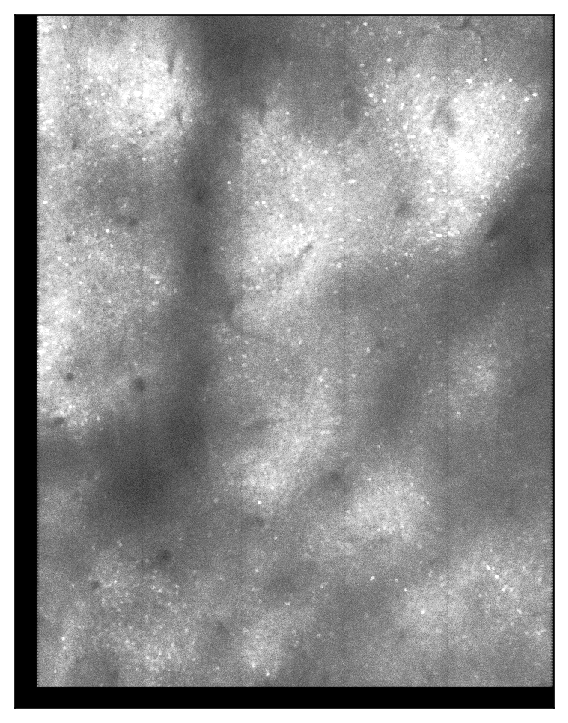

In [12]:
tfu.show_tif(im_full[0])

In [13]:
params_to_sweep = {
    'cell_filt_xy_um' : (10,20),
    'npil_filt_xy_um' : (40, 70, 100),
    'sdnorm_exp' : (0.8,1.0),
}
job.sweep_corrmap(params_to_sweep, iter_limit=1)

   Setting up sweep
      Found dir /mnt/md0/runs/s3d-SS002_2024-07-05_1-2-3-4-5-7-8-9-10-11-12-13-15-17-18-19-20/sweeps/corrmap
      Updating self.dirs tag sweeps-corrmap
   Total of 12 combinations
      Created directory for comb_00000 with params comb00000-params-cell_filt_xy_um_10.000-npil_filt_xy_um_40.000-sdnorm_exp_0.800
      Found dir /mnt/md0/runs/s3d-SS002_2024-07-05_1-2-3-4-5-7-8-9-10-11-12-13-15-17-18-19-20/sweeps/corrmap/comb_00000
      Updating self.dirs tag sweeps-corrmap-comb_00000
      Created directory for comb_00001 with params comb00001-params-cell_filt_xy_um_10.000-npil_filt_xy_um_40.000-sdnorm_exp_1.000
      Found dir /mnt/md0/runs/s3d-SS002_2024-07-05_1-2-3-4-5-7-8-9-10-11-12-13-15-17-18-19-20/sweeps/corrmap/comb_00001
      Updating self.dirs tag sweeps-corrmap-comb_00001
      Created directory for comb_00002 with params comb00002-params-cell_filt_xy_um_10.000-npil_filt_xy_um_70.000-sdnorm_exp_0.800
      Found dir /mnt/md0/runs/s3d-SS002_2024-07-05_1-2-3

{'sweep_dir_path': '/mnt/md0/runs/s3d-SS002_2024-07-05_1-2-3-4-5-7-8-9-10-11-12-13-15-17-18-19-20/sweeps/corrmap',
 'sweep_dir_name': 'sweeps-corrmap',
 'init_params': {'fs': 4.116358658453114,
  'tau': 1.3,
  'voxel_size_um': (15, 2.5, 2.5),
  'planes': array([ 0,  2,  4,  6,  8, 10, 12, 14, 16, 18, 20, 22, 24,  1,  3,  5,  7,
          9, 11, 13, 15, 17, 19, 21]),
  'convert_plane_ids_to_channel_ids': False,
  'n_ch_tif': 26,
  'notch_filt': None,
  'fix_fastZ': False,
  'n_init_files': 4,
  'init_file_pool': None,
  'init_file_sample_method': 'even',
  'init_n_frames': None,
  'enforce_positivity': True,
  'fix_shallow_plane_shift_estimates': True,
  'fix_shallow_plane_shift_esimate_threshold': 20,
  'overwrite_plane_shifts': None,
  'subtract_crosstalk': True,
  'override_crosstalk': None,
  'crosstalk_percentile': 99.5,
  'crosstalk_sigma': 0.01,
  'cavity_size': 13,
  'crosstalk_n_planes': 2,
  'use_GPU_registration': True,
  'fuse_strips': True,
  'fuse_shift_override': 6,
  'ma

In [19]:
%%time
job.params['voxel_size_um'] = (20, 3.33, 3.33)
job.params['npil_filt_xy_um'] = 70
job.params['cell_filt_xy_um'] = 10
job.params['sdnorm_exp'] = 0.80
corr_map = job.calculate_corr_map()

      Found dir /mnt/md0/runs/s3d-SS002_2024-07-05_1-2-3-4-5-7-8-9-10-11-12-13-15-17-18-19-20/corrmap
      Updating self.dirs tag corrmap
      Found dir /mnt/md0/runs/s3d-SS002_2024-07-05_1-2-3-4-5-7-8-9-10-11-12-13-15-17-18-19-20/mov_sub
      Updating self.dirs tag mov_sub
   Saved a copy of params at /mnt/md0/runs/s3d-SS002_2024-07-05_1-2-3-4-5-7-8-9-10-11-12-13-15-17-18-19-20/corrmap
   Updated main params file
   Computing correlation map of movie with 43412 frames, volume shape: 24, 926, 720
      Running batch 1 of 145
         Loading movie into shared memory
         Subtracting neuropil and applying cell filters
         Reducing filtered movie to compute correlation map
      Running batch 2 of 145
         Loading movie into shared memory
         Subtracting neuropil and applying cell filters
         Reducing filtered movie to compute correlation map
      Running batch 3 of 145
         Loading movie into shared memory
         Subtracting neuropil and applying cell fi

OSError: Not enough free space to write 19201536000 bytes

In [28]:
res = job.load_corr_map_results()
vmap = res['vmap']

In [ ]:
# most important parameter - any value of the corrmap
# above this will be considered a peak for a possible ROI,
# and will be used as a "seed" to grow an ROI around it
# bigger number: fewer ROIs, only bright ones
# smaller number: many ROIs, increasingly worse quality
job.params['peak_thresh'] = 2.9

# optionally, bin the movie in time to speed up detection
# probably a good idea if you have high framerate (>5 Hz?)
job.params['detection_timebin'] = 1 

# when extending an ROI, compare its activity to its neighboring pixels
# in frames where the fluorescence is above this percentile
job.params['percentile'] = 99.5


job.segment_rois()

['/mnt/md0/runs/s3d-SS002_2024-07-05_1-2-3-4-5-7-8-9-10-11-12-13-15-17-18-19-20/mov_sub/mov_sub0000.npy', '/mnt/md0/runs/s3d-SS002_2024-07-05_1-2-3-4-5-7-8-9-10-11-12-13-15-17-18-19-20/mov_sub/mov_sub0001.npy', '/mnt/md0/runs/s3d-SS002_2024-07-05_1-2-3-4-5-7-8-9-10-11-12-13-15-17-18-19-20/mov_sub/mov_sub0002.npy', '/mnt/md0/runs/s3d-SS002_2024-07-05_1-2-3-4-5-7-8-9-10-11-12-13-15-17-18-19-20/mov_sub/mov_sub0003.npy', '/mnt/md0/runs/s3d-SS002_2024-07-05_1-2-3-4-5-7-8-9-10-11-12-13-15-17-18-19-20/mov_sub/mov_sub0004.npy', '/mnt/md0/runs/s3d-SS002_2024-07-05_1-2-3-4-5-7-8-9-10-11-12-13-15-17-18-19-20/mov_sub/mov_sub0005.npy', '/mnt/md0/runs/s3d-SS002_2024-07-05_1-2-3-4-5-7-8-9-10-11-12-13-15-17-18-19-20/mov_sub/mov_sub0006.npy', '/mnt/md0/runs/s3d-SS002_2024-07-05_1-2-3-4-5-7-8-9-10-11-12-13-15-17-18-19-20/mov_sub/mov_sub0007.npy', '/mnt/md0/runs/s3d-SS002_2024-07-05_1-2-3-4-5-7-8-9-10-11-12-13-15-17-18-19-20/mov_sub/mov_sub0008.npy', '/mnt/md0/runs/s3d-SS002_2024-07-05_1-2-3-4-5-7-8-9-10

In [11]:
rois_dir_path = job.combine_patches(n.arange(80), job.dirs['rois'], deduplicate=False,
                                    parent_dir_name='segmentation', info_use_idx=None)

      Found dir /mnt/md0/runs/s3d-SS002_2024-07-05_1-2-3-4-5-7-8-9-10-11-12-13-15-17-18-19-20/segmentation/patch-0000
      Updating self.dirs tag segmentation-segmentation-patch-0000
      Found dir /mnt/md0/runs/s3d-SS002_2024-07-05_1-2-3-4-5-7-8-9-10-11-12-13-15-17-18-19-20/segmentation/patch-0001
      Updating self.dirs tag segmentation-segmentation-patch-0001
      Found dir /mnt/md0/runs/s3d-SS002_2024-07-05_1-2-3-4-5-7-8-9-10-11-12-13-15-17-18-19-20/segmentation/patch-0002
      Updating self.dirs tag segmentation-segmentation-patch-0002
      Found dir /mnt/md0/runs/s3d-SS002_2024-07-05_1-2-3-4-5-7-8-9-10-11-12-13-15-17-18-19-20/segmentation/patch-0003
      Updating self.dirs tag segmentation-segmentation-patch-0003
      Found dir /mnt/md0/runs/s3d-SS002_2024-07-05_1-2-3-4-5-7-8-9-10-11-12-13-15-17-18-19-20/segmentation/patch-0004
      Updating self.dirs tag segmentation-segmentation-patch-0004
      Found dir /mnt/md0/runs/s3d-SS002_2024-07-05_1-2-3-4-5-7-8-9-10-11-12-13-1

In [12]:
job.compute_npil_masks(stats_dir = job.dirs['rois'])


   Updated main params file
   Movie shape: (24, 43412, 926, 720)
308704
   Extracting 308704 valid cells, and saving cell flags to /mnt/md0/runs/s3d-SS002_2024-07-05_1-2-3-4-5-7-8-9-10-11-12-13-15-17-18-19-20/rois/iscell_extracted.npy
   Extracting activity
Will extract in 87 batches of 500
Saving intermediate results to /mnt/md0/runs/s3d-SS002_2024-07-05_1-2-3-4-5-7-8-9-10-11-12-13-15-17-18-19-20/rois
Extracting batch 0000 of 0087
Batch size: 29 GB


KeyboardInterrupt: 

In [17]:
iscell = n.load(job.dirs['rois'] + '/iscell.npy')

In [20]:
iscell.shape

(308704, 2)

In [22]:
iscell[:,0].sum()

31225

In [24]:
traces['spks'].shape

(31225, 43412)

In [18]:

traces = job.extract_and_deconvolve(stats_dir=job.dirs['rois'],iscell=iscell)

   Updated main params file
   Movie shape: (24, 43412, 926, 720)
308704
   Extracting 31225 valid cells, and saving cell flags to /mnt/md0/runs/s3d-SS002_2024-07-05_1-2-3-4-5-7-8-9-10-11-12-13-15-17-18-19-20/rois/iscell_extracted.npy
   Extracting activity
Will extract in 87 batches of 500
Saving intermediate results to /mnt/md0/runs/s3d-SS002_2024-07-05_1-2-3-4-5-7-8-9-10-11-12-13-15-17-18-19-20/rois
Extracting batch 0000 of 0087
Batch size: 29 GB
Extracting batch 0001 of 0087
Batch size: 29 GB
Extracting batch 0002 of 0087
Batch size: 29 GB
Extracting batch 0003 of 0087
Batch size: 29 GB
Extracting batch 0004 of 0087
Batch size: 29 GB
Extracting batch 0005 of 0087
Batch size: 29 GB
Extracting batch 0006 of 0087
Batch size: 29 GB
Extracting batch 0007 of 0087
Batch size: 29 GB
Extracting batch 0008 of 0087
Batch size: 29 GB
Extracting batch 0009 of 0087
Batch size: 29 GB
Extracting batch 0010 of 0087
Batch size: 29 GB
Extracting batch 0011 of 0087
Batch size: 29 GB
Extracting batch 0

In [19]:
job.export_results('/mnt/zeytin-f1/s3d-results/',result_dir_name='rois')

   Created dir /mnt/zeytin-f1/s3d-results/s3d-results-SS002_2024-07-05_1-2-3-4-5-7-8-9-10-11-12-13-15-17-18-19-20 to export results
      Loading from /mnt/md0/runs/s3d-SS002_2024-07-05_1-2-3-4-5-7-8-9-10-11-12-13-15-17-18-19-20/rois/stats_small.npy
      Loading from /mnt/md0/runs/s3d-SS002_2024-07-05_1-2-3-4-5-7-8-9-10-11-12-13-15-17-18-19-20/rois/info.npy
      Loading from /mnt/md0/runs/s3d-SS002_2024-07-05_1-2-3-4-5-7-8-9-10-11-12-13-15-17-18-19-20/rois/F.npy
      Loading from /mnt/md0/runs/s3d-SS002_2024-07-05_1-2-3-4-5-7-8-9-10-11-12-13-15-17-18-19-20/rois/spks.npy
      Loading from /mnt/md0/runs/s3d-SS002_2024-07-05_1-2-3-4-5-7-8-9-10-11-12-13-15-17-18-19-20/rois/Fneu.npy
      Loading from /mnt/md0/runs/s3d-SS002_2024-07-05_1-2-3-4-5-7-8-9-10-11-12-13-15-17-18-19-20/rois/iscell.npy
   /mnt/zortex-subjects/SS002/2024-07-05/1/2024-07-05_1_SS002_2P_00001_00001.tif is 100 frames and 4326814878 bytes
   /mnt/zortex-subjects/SS002/2024-07-05/1/2024-07-05_1_SS002_2P_00001_00026.tif